In [1]:
import pandas as pd
import numpy as np
import re
import os
import random

In [2]:
IMG_DIR = "/kaggle/input/flickr8k/Images"
CAPTIONS_PATH = "/kaggle/input/flickr8k/captions.txt"

[1](https://machinelearningmastery.com/randomness-in-machine-learning/)

Randomness is at the heart of SL:
   1. data collection
   2. observation order
   3. random initialisations
   4. randomness in sampling for training
   5. randomness in sampling for testing

We can get reproducible results by fixing the random number generator’s seed before each model we construct. In fact, this is a best practice.

Q. If a machine learning algorithm gives a different model with a different sequence of random numbers, then which model do we pick? 
   - We cannnot. Experimental conditions must be the same for comparision.
   - Hence, we need to set some kind of common pattern in the random numbers we generate.
   
- Run an algorithm again & again and mean it out, to reduce uncertainity. 
- Report the uncertainity in a range. (mean +- std assuming Normal distribution of results for many runs)

- Final model needs to be rerun on the whole sample, whene the algorithm & configurations are chosen. This model is deployed for operations

> Should I create many final models and select the one with the best accuracy on a hold out validation dataset.
> “No” I replied. It would be highly dependent on the quality of the held out validation dataset. You are selecting random numbers that optimize for a small sample of data.

In [8]:
# to achieve "uniform randomness" across different libraries 
from numpy.random import seed
from tensorflow.random import set_seed

def set_seed(Myseed = 42):    
    seed(Myseed)
    random.seed(Myseed)
    set_seed(Myseed)

# Mapping images to captions

Stop words & other commonly occuring words are not removed from the dataset as they are important for the generated text to be grammatically correct.

In [11]:
# https://docs.python.org/3/library/re.html -> ^: negation, +: >=2 instances
def cleanText(text):
    
    # convert to lowercase
    cleantext = text.lower()
    
    # remove additional spaces anywhere in string with >1 space
    cleantext = re.sub(r'\s+', ' ', cleantext)
    
    # remove words with 1 letter(a, I, '(s))
    s = [word for word in cleantext.split() if len(word) > 1]
    cleantext = " ".join(s)
    
    # replaces anythin except letters, space & hyphen(compound words -> entity recognition, tokenization)
    cleantext = re.sub(r'[^\w\s-]', '', cleantext)
#     cleantext = cleantext.replace('-', ' ')
    
    # remove spaces at front & back of string
    if (cleantext[0] == ' '):
        cleantext = cleantext[1:]
    if (cleantext[-1] == ' '):
        cleantext = cleantext[:-1] 
    
    return cleantext

def mapping(CAPTIONS_PATH):
    
    imcap = {} 
    vocab = {}
    
    with open(CAPTIONS_PATH, 'r') as fptr:
        
        for line in fptr:
            
            # checking for valid lines
            try:
                img, cap = line.split(".jpg,")
                img += ".jpg"   
                if ".jpg" not in img:
                    continue
                
                # cleaning the caption
                cap = cap[:-1]
                cap = cleanText(cap)
                
                # updating vocabulary
                for word in cap.split(" "):
                    if word not in vocab:
                        vocab[word] = 1
                
                # mapping caption to image
                if img not in imcap.keys():
                    imcap[img] = [cap]
                else:
                    imcap[img].append(cap)
            except Exception as e:
                continue
                
        fptr.close()        
    return imcap, list(vocab.keys())

In [12]:
imcap, vocab = mapping(CAPTIONS_PATH)

In [15]:
import pickle

with open('maps.pickle', 'wb') as fptr1:
    pickle.dump(imcap, fptr1)
    
with open('vocab.pickle', 'wb') as fptr2:
    pickle.dump(vocab, fptr2)
    
fptr1.close()
fptr2.close()

# Extracting features from images from Xception

# Why Xception?

UNDERSTAND

High Accuracy: The Xception model has demonstrated state-of-the-art accuracy on the ImageNet dataset, indicating its ability to learn rich representations from images and perform well on various computer vision tasks.

Efficient Architecture: Xception's architecture employs depthwise separable convolutions, which significantly reduces the number of parameters and computations compared to traditional convolutional neural networks. This efficiency makes it easier to train and deploy the model in resource-constrained environments.

Transferability of Learned Features: Xception's learned features can generalize well across different datasets and tasks. By leveraging pre-trained weights from Xception on a large-scale dataset like ImageNet, you can benefit from the model's strong generalization power and accelerate training on your specific task or dataset.

Versatility: Xception's architecture can be adapted for various computer vision tasks, such as image classification, object detection, and image segmentation. Its versatility allows for flexible usage in different applications and the ability to customize the model to meet specific requirements.

Availability of Pre-trained Models: Pre-trained Xception models are readily available in popular deep learning frameworks. This availability simplifies the implementation process, as you can easily load the pre-trained models and fine-tune them on your specific dataset, saving significant training time and resources.

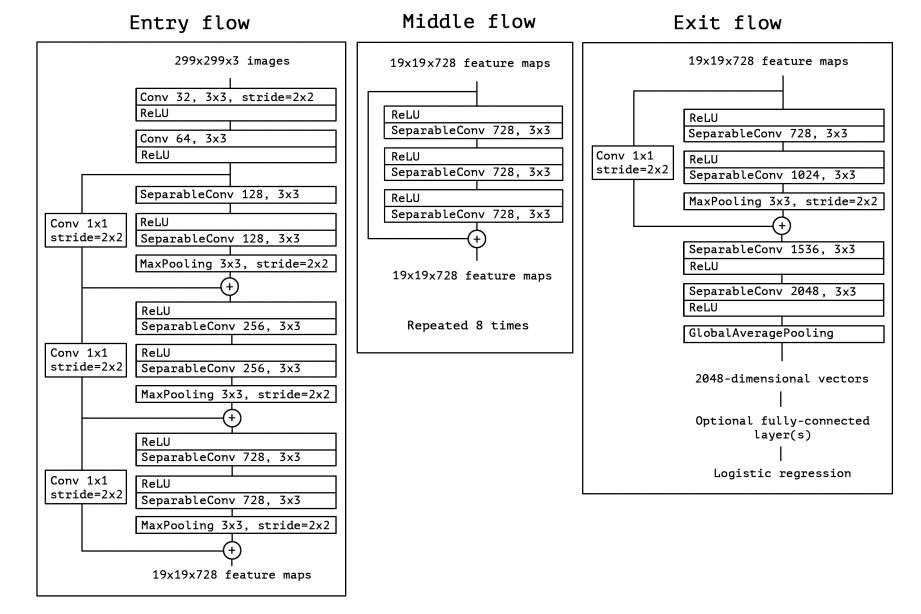

In [30]:
from tensorflow.keras.applications import Xception
from tensorflow.keras.applications.xception import preprocess_input

# https://iq.opengenus.org/xception-model/#:~:text=Table%20below%20shows%20that%20Xception,any%20kind%20on%20non%2Dlinearity.
# https://keras.io/guides/transfer_learning/
# https://keras.io/api/applications/xception/ (input: 299 x 299 x 3)
model = Xception(include_top = False,
                 pooling = 'avg',
                 weights = "imagenet")

83683744/83683744 [==============================] - 1s 0us/step


In [33]:
# https://www.tutorialspoint.com/python_pillow/python_pillow_using_image_module.htm#:~:text=To%20load%20the%20image%2C%20we,Python%20Imaging%20Library%20(PIL).
from PIL import Image
import os
from tqdm import tqdm

def featExtractX(DIR):
    
    imgfeat = {}
    
    for fname in tqdm(os.listdir(DIR), desc = "extracting features"):
        fpath = os.path.join(DIR, fname)
        
        # only files are considered
        if (os.path.isfile(fpath)):
            
            # num channels not in size
            img = Image.open(fpath)
            img = img.resize((299, 299)) # xception input size
            
            # 4D inputs required to be compatible with convolution layer input size
            img = np.expand_dims(img, axis = 0)
            
            # image preprocessing (alt: divide by 255/2 & -1)
            img = preprocess_input(img)
            
            # storing features for 
            feat = model.predict(img)
            imgfeat[fname] =  feat

    return imgfeat

imgfeatX = featExtractX(IMG_DIR)

with open("imgfeat.pickle", "wb") as fptr:
    pickle.dump(imgfeatX, fptr)
fptr.close()

extracting features:   0%|          | 0/8091 [00:00<?, ?it/s]

1/1 [==============================] - 4s 4s/step


extracting features:   0%|          | 1/8091 [00:03<8:35:57,  3.83s/it]

1/1 [==============================] - 0s 23ms/step


extracting features:   0%|          | 3/8091 [00:03<2:22:03,  1.05s/it]

1/1 [==============================] - 0s 22ms/step


extracting features:   0%|          | 5/8091 [00:04<1:14:24,  1.81it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   0%|          | 7/8091 [00:04<47:57,  2.81it/s]  

1/1 [==============================] - 0s 22ms/step


extracting features:   0%|          | 9/8091 [00:04<33:35,  4.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   0%|          | 11/8091 [00:04<25:34,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   0%|          | 13/8091 [00:04<20:51,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:   0%|          | 15/8091 [00:04<17:48,  7.56it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   0%|          | 17/8091 [00:05<15:31,  8.66it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   0%|          | 19/8091 [00:05<14:05,  9.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   0%|          | 21/8091 [00:05<12:51, 10.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   0%|          | 23/8091 [00:05<11:58, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   0%|          | 25/8091 [00:05<11:39, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   0%|          | 27/8091 [00:05<11:19, 11.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   0%|          | 29/8091 [00:06<11:18, 11.89it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   0%|          | 31/8091 [00:06<11:21, 11.83it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   0%|          | 33/8091 [00:06<11:33, 11.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   0%|          | 35/8091 [00:06<11:20, 11.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   0%|          | 37/8091 [00:06<11:13, 11.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   0%|          | 39/8091 [00:06<11:16, 11.89it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 41/8091 [00:07<11:24, 11.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|          | 43/8091 [00:07<11:30, 11.66it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 45/8091 [00:07<11:21, 11.81it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 47/8091 [00:07<11:22, 11.78it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   1%|          | 49/8091 [00:07<11:25, 11.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|          | 51/8091 [00:07<11:34, 11.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 53/8091 [00:08<11:38, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|          | 55/8091 [00:08<11:32, 11.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 57/8091 [00:08<11:33, 11.59it/s]

1/1 [==============================] - 0s 47ms/step


extracting features:   1%|          | 59/8091 [00:08<12:05, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|          | 61/8091 [00:08<12:12, 10.96it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   1%|          | 63/8091 [00:09<11:58, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 65/8091 [00:09<11:49, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 67/8091 [00:09<11:44, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|          | 69/8091 [00:09<11:54, 11.23it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   1%|          | 71/8091 [00:09<11:45, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 73/8091 [00:09<11:46, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 75/8091 [00:10<11:46, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 77/8091 [00:10<11:37, 11.49it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   1%|          | 79/8091 [00:10<11:33, 11.56it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   1%|          | 81/8091 [00:10<11:30, 11.59it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   1%|          | 83/8091 [00:10<11:42, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|          | 85/8091 [00:10<11:50, 11.26it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   1%|          | 87/8091 [00:11<12:04, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|          | 89/8091 [00:11<12:06, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 91/8091 [00:11<11:47, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 93/8091 [00:11<11:38, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|          | 95/8091 [00:11<11:32, 11.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|          | 97/8091 [00:12<11:38, 11.45it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   1%|          | 99/8091 [00:12<11:41, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|          | 101/8091 [00:12<11:43, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|▏         | 103/8091 [00:12<11:36, 11.47it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   1%|▏         | 105/8091 [00:12<11:49, 11.26it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:   1%|▏         | 107/8091 [00:12<11:59, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|▏         | 109/8091 [00:13<12:03, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|▏         | 111/8091 [00:13<11:48, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|▏         | 113/8091 [00:13<11:37, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|▏         | 115/8091 [00:13<11:44, 11.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   1%|▏         | 117/8091 [00:13<11:40, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|▏         | 119/8091 [00:13<11:37, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   1%|▏         | 121/8091 [00:14<11:25, 11.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   2%|▏         | 123/8091 [00:14<11:25, 11.62it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   2%|▏         | 125/8091 [00:14<11:26, 11.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 127/8091 [00:14<11:29, 11.55it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   2%|▏         | 129/8091 [00:14<11:29, 11.54it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   2%|▏         | 131/8091 [00:14<11:25, 11.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   2%|▏         | 133/8091 [00:15<11:25, 11.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 135/8091 [00:15<11:27, 11.58it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 137/8091 [00:15<11:20, 11.69it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 139/8091 [00:15<11:05, 11.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   2%|▏         | 141/8091 [00:15<11:14, 11.79it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 143/8091 [00:16<11:17, 11.74it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 145/8091 [00:16<11:16, 11.75it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 147/8091 [00:16<11:08, 11.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 149/8091 [00:16<11:08, 11.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   2%|▏         | 151/8091 [00:16<11:20, 11.66it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 153/8091 [00:16<11:22, 11.64it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 155/8091 [00:17<11:07, 11.89it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   2%|▏         | 157/8091 [00:17<11:07, 11.89it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 159/8091 [00:17<11:07, 11.88it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   2%|▏         | 161/8091 [00:17<11:00, 12.01it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   2%|▏         | 163/8091 [00:17<10:56, 12.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 165/8091 [00:17<11:02, 11.96it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   2%|▏         | 167/8091 [00:18<11:02, 11.96it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   2%|▏         | 169/8091 [00:18<11:11, 11.80it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 171/8091 [00:18<11:18, 11.67it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   2%|▏         | 173/8091 [00:18<11:09, 11.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   2%|▏         | 175/8091 [00:18<11:57, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 177/8091 [00:18<11:47, 11.19it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:   2%|▏         | 179/8091 [00:19<13:05, 10.07it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:   2%|▏         | 181/8091 [00:19<13:53,  9.48it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:   2%|▏         | 182/8091 [00:19<14:11,  9.28it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:   2%|▏         | 183/8091 [00:19<14:21,  9.18it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:   2%|▏         | 184/8091 [00:19<14:16,  9.23it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:   2%|▏         | 185/8091 [00:19<14:18,  9.21it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:   2%|▏         | 186/8091 [00:19<14:26,  9.12it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:   2%|▏         | 187/8091 [00:20<14:39,  8.98it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:   2%|▏         | 188/8091 [00:20<14:42,  8.96it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   2%|▏         | 190/8091 [00:20<13:34,  9.70it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   2%|▏         | 192/8091 [00:20<12:34, 10.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 194/8091 [00:20<12:02, 10.92it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   2%|▏         | 196/8091 [00:20<12:01, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   2%|▏         | 198/8091 [00:21<11:52, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   2%|▏         | 200/8091 [00:21<11:38, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   2%|▏         | 202/8091 [00:21<11:25, 11.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 204/8091 [00:21<11:13, 11.71it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 206/8091 [00:21<11:18, 11.63it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 208/8091 [00:21<11:14, 11.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 210/8091 [00:22<11:17, 11.63it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 212/8091 [00:22<11:18, 11.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 214/8091 [00:22<11:26, 11.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 216/8091 [00:22<11:19, 11.58it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 218/8091 [00:22<11:17, 11.63it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 220/8091 [00:22<11:20, 11.57it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 222/8091 [00:23<11:17, 11.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 224/8091 [00:23<11:26, 11.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 226/8091 [00:23<11:18, 11.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 228/8091 [00:23<11:24, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 230/8091 [00:23<11:22, 11.53it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 232/8091 [00:24<11:32, 11.35it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 234/8091 [00:24<11:19, 11.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 236/8091 [00:24<11:18, 11.58it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 238/8091 [00:24<11:15, 11.63it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   3%|▎         | 240/8091 [00:24<11:35, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 242/8091 [00:24<11:38, 11.24it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   3%|▎         | 244/8091 [00:25<11:38, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 246/8091 [00:25<11:34, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 248/8091 [00:25<11:28, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 250/8091 [00:25<11:29, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 252/8091 [00:25<11:26, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 254/8091 [00:25<11:23, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 256/8091 [00:26<11:22, 11.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 258/8091 [00:26<11:39, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 260/8091 [00:26<11:38, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 262/8091 [00:26<11:33, 11.29it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   3%|▎         | 264/8091 [00:26<11:25, 11.41it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   3%|▎         | 266/8091 [00:26<11:28, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 268/8091 [00:27<11:57, 10.90it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   3%|▎         | 270/8091 [00:27<11:40, 11.17it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   3%|▎         | 272/8091 [00:27<11:25, 11.40it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   3%|▎         | 274/8091 [00:27<11:21, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 276/8091 [00:27<11:32, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   3%|▎         | 278/8091 [00:28<11:25, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 280/8091 [00:28<11:21, 11.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   3%|▎         | 282/8091 [00:28<11:23, 11.42it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▎         | 284/8091 [00:28<11:19, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▎         | 286/8091 [00:28<12:11, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   4%|▎         | 288/8091 [00:28<11:47, 11.02it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▎         | 290/8091 [00:29<11:26, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▎         | 292/8091 [00:29<11:13, 11.58it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▎         | 294/8091 [00:29<11:13, 11.58it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▎         | 296/8091 [00:29<11:06, 11.69it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▎         | 298/8091 [00:29<10:59, 11.82it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▎         | 300/8091 [00:29<10:59, 11.80it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▎         | 302/8091 [00:30<10:58, 11.83it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 304/8091 [00:30<10:56, 11.87it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:   4%|▍         | 306/8091 [00:30<11:18, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   4%|▍         | 308/8091 [00:30<11:23, 11.39it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   4%|▍         | 310/8091 [00:30<11:21, 11.41it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   4%|▍         | 312/8091 [00:31<11:51, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 314/8091 [00:31<11:35, 11.19it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▍         | 316/8091 [00:31<11:25, 11.34it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▍         | 318/8091 [00:31<11:18, 11.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   4%|▍         | 320/8091 [00:31<11:11, 11.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 322/8091 [00:31<11:39, 11.11it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▍         | 324/8091 [00:32<11:26, 11.31it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▍         | 326/8091 [00:32<11:11, 11.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 328/8091 [00:32<11:02, 11.72it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   4%|▍         | 330/8091 [00:32<11:07, 11.62it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 332/8091 [00:32<10:52, 11.89it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 334/8091 [00:32<10:53, 11.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 336/8091 [00:33<10:43, 12.04it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▍         | 338/8091 [00:33<10:45, 12.01it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   4%|▍         | 340/8091 [00:33<10:53, 11.85it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▍         | 342/8091 [00:33<11:16, 11.45it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   4%|▍         | 344/8091 [00:33<11:04, 11.66it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 346/8091 [00:33<10:57, 11.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 348/8091 [00:34<11:03, 11.67it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 350/8091 [00:34<10:59, 11.73it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 352/8091 [00:34<11:02, 11.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 354/8091 [00:34<11:02, 11.68it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   4%|▍         | 356/8091 [00:34<11:10, 11.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   4%|▍         | 358/8091 [00:34<11:27, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 360/8091 [00:35<11:23, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   4%|▍         | 362/8091 [00:35<11:19, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   4%|▍         | 364/8091 [00:35<11:16, 11.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 366/8091 [00:35<11:20, 11.35it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 368/8091 [00:35<11:20, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▍         | 370/8091 [00:36<11:09, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▍         | 372/8091 [00:36<11:12, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▍         | 374/8091 [00:36<11:07, 11.57it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 376/8091 [00:36<11:12, 11.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 378/8091 [00:36<11:07, 11.56it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   5%|▍         | 380/8091 [00:36<11:29, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 382/8091 [00:37<11:24, 11.26it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   5%|▍         | 384/8091 [00:37<11:57, 10.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 386/8091 [00:37<11:46, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 388/8091 [00:37<11:34, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▍         | 390/8091 [00:37<11:43, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▍         | 392/8091 [00:38<11:43, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▍         | 394/8091 [00:38<11:31, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 396/8091 [00:38<11:34, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▍         | 398/8091 [00:38<11:17, 11.35it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   5%|▍         | 400/8091 [00:38<12:00, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 402/8091 [00:38<11:51, 10.81it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▍         | 404/8091 [00:39<11:41, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 406/8091 [00:39<11:49, 10.83it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 408/8091 [00:39<11:39, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▌         | 410/8091 [00:39<11:30, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▌         | 412/8091 [00:39<11:34, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 414/8091 [00:40<11:29, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▌         | 416/8091 [00:40<11:18, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 418/8091 [00:40<11:19, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▌         | 420/8091 [00:40<11:25, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 422/8091 [00:40<11:14, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 424/8091 [00:40<11:05, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 426/8091 [00:41<11:02, 11.57it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   5%|▌         | 428/8091 [00:41<10:58, 11.63it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   5%|▌         | 430/8091 [00:41<11:19, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 432/8091 [00:41<11:20, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 434/8091 [00:41<11:16, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 436/8091 [00:41<11:36, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   5%|▌         | 438/8091 [00:42<11:27, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 440/8091 [00:42<11:11, 11.40it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   5%|▌         | 442/8091 [00:42<11:00, 11.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   5%|▌         | 444/8091 [00:42<11:01, 11.56it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 446/8091 [00:42<10:59, 11.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 448/8091 [00:42<11:00, 11.58it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 450/8091 [00:43<10:58, 11.60it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   6%|▌         | 452/8091 [00:43<10:50, 11.74it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 454/8091 [00:43<10:50, 11.73it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 456/8091 [00:43<10:52, 11.70it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 458/8091 [00:43<11:02, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 460/8091 [00:44<10:55, 11.64it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 462/8091 [00:44<10:46, 11.81it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 464/8091 [00:44<10:43, 11.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 466/8091 [00:44<10:58, 11.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 468/8091 [00:44<10:50, 11.73it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 470/8091 [00:44<10:55, 11.63it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 472/8091 [00:45<10:54, 11.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 474/8091 [00:45<11:02, 11.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 476/8091 [00:45<11:01, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 478/8091 [00:45<10:51, 11.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 480/8091 [00:45<10:41, 11.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 482/8091 [00:45<10:44, 11.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 484/8091 [00:46<11:02, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 486/8091 [00:46<10:56, 11.58it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   6%|▌         | 488/8091 [00:46<10:56, 11.58it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 490/8091 [00:46<10:48, 11.73it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 492/8091 [00:46<10:58, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 494/8091 [00:46<10:52, 11.65it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   6%|▌         | 496/8091 [00:47<10:51, 11.66it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 498/8091 [00:47<10:54, 11.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 500/8091 [00:47<10:55, 11.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▌         | 502/8091 [00:47<11:03, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▌         | 504/8091 [00:47<10:58, 11.52it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▋         | 506/8091 [00:47<11:02, 11.46it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   6%|▋         | 508/8091 [00:48<11:00, 11.48it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:   6%|▋         | 510/8091 [00:48<11:16, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▋         | 512/8091 [00:48<11:22, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▋         | 514/8091 [00:48<11:55, 10.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▋         | 516/8091 [00:48<11:33, 10.92it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▋         | 518/8091 [00:49<11:06, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   6%|▋         | 520/8091 [00:49<11:12, 11.26it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   6%|▋         | 522/8091 [00:49<11:15, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   6%|▋         | 524/8091 [00:49<10:49, 11.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 526/8091 [00:49<10:53, 11.57it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   7%|▋         | 528/8091 [00:49<11:07, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 530/8091 [00:50<11:13, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 532/8091 [00:50<11:12, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 534/8091 [00:50<11:08, 11.31it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:   7%|▋         | 536/8091 [00:50<12:24, 10.14it/s]

1/1 [==============================] - 0s 46ms/step


extracting features:   7%|▋         | 538/8091 [00:50<13:25,  9.37it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:   7%|▋         | 539/8091 [00:51<13:38,  9.23it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:   7%|▋         | 540/8091 [00:51<13:45,  9.15it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:   7%|▋         | 541/8091 [00:51<13:48,  9.12it/s]

1/1 [==============================] - 0s 40ms/step


extracting features:   7%|▋         | 542/8091 [00:51<14:10,  8.88it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:   7%|▋         | 543/8091 [00:51<14:36,  8.61it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:   7%|▋         | 544/8091 [00:51<14:18,  8.79it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:   7%|▋         | 545/8091 [00:51<14:14,  8.83it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:   7%|▋         | 546/8091 [00:51<14:17,  8.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 548/8091 [00:52<12:50,  9.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 550/8091 [00:52<13:50,  9.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 552/8091 [00:52<12:50,  9.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 554/8091 [00:52<12:19, 10.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 556/8091 [00:52<12:08, 10.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 558/8091 [00:53<11:54, 10.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 560/8091 [00:53<11:28, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 562/8091 [00:53<11:29, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 564/8091 [00:53<11:25, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 566/8091 [00:53<11:21, 11.04it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 568/8091 [00:53<11:18, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 570/8091 [00:54<11:10, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 572/8091 [00:54<10:55, 11.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 574/8091 [00:54<10:59, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 576/8091 [00:54<10:58, 11.42it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 578/8091 [00:54<10:52, 11.52it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 580/8091 [00:54<10:54, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 582/8091 [00:55<11:13, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 584/8091 [00:55<11:07, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 586/8091 [00:55<10:55, 11.45it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 588/8091 [00:55<10:51, 11.52it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 590/8091 [00:55<10:49, 11.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 592/8091 [00:56<10:57, 11.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 594/8091 [00:56<10:51, 11.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 596/8091 [00:56<10:52, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   7%|▋         | 598/8091 [00:56<10:56, 11.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 600/8091 [00:56<10:57, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 602/8091 [00:56<10:49, 11.53it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   7%|▋         | 604/8091 [00:57<10:46, 11.57it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   7%|▋         | 606/8091 [00:57<10:42, 11.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 608/8091 [00:57<10:41, 11.66it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 610/8091 [00:57<10:49, 11.51it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 612/8091 [00:57<10:54, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 614/8091 [00:57<10:45, 11.58it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 616/8091 [00:58<10:43, 11.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 618/8091 [00:58<10:51, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 620/8091 [00:58<11:26, 10.88it/s]

1/1 [==============================] - 0s 45ms/step


extracting features:   8%|▊         | 622/8091 [00:58<12:31,  9.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 624/8091 [00:58<11:57, 10.40it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 626/8091 [00:59<11:41, 10.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 628/8091 [00:59<11:40, 10.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 630/8091 [00:59<11:23, 10.92it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   8%|▊         | 632/8091 [00:59<11:10, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 634/8091 [00:59<10:54, 11.39it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 636/8091 [00:59<11:04, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 638/8091 [01:00<11:25, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 640/8091 [01:00<11:16, 11.01it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   8%|▊         | 642/8091 [01:00<10:57, 11.33it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   8%|▊         | 644/8091 [01:00<10:57, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 646/8091 [01:00<10:54, 11.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 648/8091 [01:01<10:52, 11.41it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   8%|▊         | 650/8091 [01:01<10:48, 11.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 652/8091 [01:01<10:39, 11.62it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 654/8091 [01:01<10:41, 11.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 656/8091 [01:01<10:40, 11.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 658/8091 [01:01<10:53, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 660/8091 [01:02<10:51, 11.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 662/8091 [01:02<10:56, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   8%|▊         | 664/8091 [01:02<11:07, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 666/8091 [01:02<11:00, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 668/8091 [01:02<10:44, 11.52it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   8%|▊         | 670/8091 [01:02<10:59, 11.26it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   8%|▊         | 672/8091 [01:03<11:06, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 674/8091 [01:03<11:07, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 676/8091 [01:03<10:56, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 678/8091 [01:03<10:41, 11.55it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   8%|▊         | 680/8091 [01:03<10:31, 11.73it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 682/8091 [01:03<10:33, 11.70it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   8%|▊         | 684/8091 [01:04<10:42, 11.53it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   8%|▊         | 686/8091 [01:04<10:46, 11.45it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▊         | 688/8091 [01:04<10:47, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▊         | 690/8091 [01:04<10:54, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▊         | 692/8091 [01:04<10:54, 11.30it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:   9%|▊         | 694/8091 [01:05<10:58, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▊         | 696/8091 [01:05<10:53, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▊         | 698/8091 [01:05<10:53, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▊         | 700/8091 [01:05<10:55, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▊         | 702/8091 [01:05<10:49, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▊         | 704/8091 [01:05<10:43, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▊         | 706/8091 [01:06<10:42, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 708/8091 [01:06<10:52, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 710/8091 [01:06<10:51, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 712/8091 [01:06<10:47, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 714/8091 [01:06<10:33, 11.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 716/8091 [01:06<10:23, 11.83it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:   9%|▉         | 718/8091 [01:07<10:43, 11.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 720/8091 [01:07<10:35, 11.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 722/8091 [01:07<10:35, 11.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▉         | 724/8091 [01:07<10:30, 11.68it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   9%|▉         | 726/8091 [01:07<10:38, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 728/8091 [01:08<10:34, 11.60it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▉         | 730/8091 [01:08<10:37, 11.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▉         | 732/8091 [01:08<10:48, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 734/8091 [01:08<10:36, 11.55it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   9%|▉         | 736/8091 [01:08<11:35, 10.58it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 738/8091 [01:08<11:24, 10.74it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 740/8091 [01:09<11:03, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 742/8091 [01:09<11:03, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▉         | 744/8091 [01:09<10:59, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 746/8091 [01:09<10:49, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▉         | 748/8091 [01:09<10:45, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 750/8091 [01:09<10:41, 11.45it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:   9%|▉         | 752/8091 [01:10<10:36, 11.52it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▉         | 754/8091 [01:10<10:43, 11.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:   9%|▉         | 756/8091 [01:10<10:39, 11.48it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   9%|▉         | 758/8091 [01:10<10:45, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 760/8091 [01:10<10:40, 11.45it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 762/8091 [01:11<10:46, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:   9%|▉         | 764/8091 [01:11<10:47, 11.31it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   9%|▉         | 766/8091 [01:11<10:30, 11.62it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:   9%|▉         | 768/8091 [01:11<10:26, 11.69it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  10%|▉         | 770/8091 [01:11<10:15, 11.89it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|▉         | 772/8091 [01:11<10:17, 11.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|▉         | 774/8091 [01:12<10:18, 11.84it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|▉         | 776/8091 [01:12<10:35, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|▉         | 778/8091 [01:12<10:22, 11.75it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  10%|▉         | 780/8091 [01:12<10:28, 11.64it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|▉         | 782/8091 [01:12<10:34, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|▉         | 784/8091 [01:12<10:39, 11.43it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  10%|▉         | 786/8091 [01:13<10:47, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|▉         | 788/8091 [01:13<10:40, 11.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|▉         | 790/8091 [01:13<10:41, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|▉         | 792/8091 [01:13<10:44, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|▉         | 794/8091 [01:13<10:50, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|▉         | 796/8091 [01:13<10:42, 11.36it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  10%|▉         | 798/8091 [01:14<10:47, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|▉         | 800/8091 [01:14<10:37, 11.43it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  10%|▉         | 802/8091 [01:14<10:46, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|▉         | 804/8091 [01:14<10:49, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|▉         | 806/8091 [01:14<10:47, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|▉         | 808/8091 [01:15<10:45, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 810/8091 [01:15<10:39, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 812/8091 [01:15<10:32, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 814/8091 [01:15<10:25, 11.63it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 816/8091 [01:15<10:24, 11.64it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 818/8091 [01:15<10:21, 11.70it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 820/8091 [01:16<10:29, 11.56it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 822/8091 [01:16<10:30, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 824/8091 [01:16<10:33, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|█         | 826/8091 [01:16<10:35, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 828/8091 [01:16<10:39, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 830/8091 [01:16<10:30, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|█         | 832/8091 [01:17<10:33, 11.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|█         | 834/8091 [01:17<10:43, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 836/8091 [01:17<10:47, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 838/8091 [01:17<10:45, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 840/8091 [01:17<10:39, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 842/8091 [01:18<10:44, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|█         | 844/8091 [01:18<10:55, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  10%|█         | 846/8091 [01:18<10:48, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  10%|█         | 848/8091 [01:18<10:46, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█         | 850/8091 [01:18<11:18, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  11%|█         | 852/8091 [01:18<11:04, 10.89it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  11%|█         | 854/8091 [01:19<10:56, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  11%|█         | 856/8091 [01:19<10:50, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█         | 858/8091 [01:19<10:51, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█         | 860/8091 [01:19<10:40, 11.28it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  11%|█         | 862/8091 [01:19<10:59, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  11%|█         | 864/8091 [01:20<10:57, 10.99it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  11%|█         | 866/8091 [01:20<10:44, 11.20it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  11%|█         | 868/8091 [01:20<10:42, 11.24it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  11%|█         | 870/8091 [01:20<10:36, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█         | 872/8091 [01:20<10:37, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█         | 874/8091 [01:20<10:33, 11.39it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█         | 876/8091 [01:21<10:37, 11.32it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  11%|█         | 878/8091 [01:21<10:51, 11.07it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  11%|█         | 880/8091 [01:21<10:59, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  11%|█         | 882/8091 [01:21<10:47, 11.13it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  11%|█         | 884/8091 [01:21<10:45, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  11%|█         | 886/8091 [01:21<10:47, 11.13it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  11%|█         | 888/8091 [01:22<11:03, 10.86it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  11%|█         | 890/8091 [01:22<12:27,  9.64it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  11%|█         | 891/8091 [01:22<12:55,  9.29it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  11%|█         | 892/8091 [01:22<13:11,  9.10it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  11%|█         | 893/8091 [01:22<13:33,  8.85it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  11%|█         | 894/8091 [01:22<13:34,  8.83it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  11%|█         | 895/8091 [01:23<13:44,  8.73it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  11%|█         | 896/8091 [01:23<13:48,  8.68it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  11%|█         | 897/8091 [01:23<14:06,  8.50it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  11%|█         | 898/8091 [01:23<13:56,  8.60it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  11%|█         | 899/8091 [01:23<13:59,  8.57it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  11%|█         | 901/8091 [01:23<12:41,  9.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  11%|█         | 903/8091 [01:23<11:59,  9.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█         | 905/8091 [01:24<11:34, 10.35it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  11%|█         | 907/8091 [01:24<11:34, 10.34it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  11%|█         | 909/8091 [01:24<11:18, 10.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  11%|█▏        | 911/8091 [01:24<11:11, 10.69it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  11%|█▏        | 913/8091 [01:24<11:00, 10.86it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  11%|█▏        | 915/8091 [01:24<11:02, 10.83it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  11%|█▏        | 917/8091 [01:25<11:16, 10.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█▏        | 919/8091 [01:25<11:05, 10.77it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█▏        | 921/8091 [01:25<10:56, 10.93it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█▏        | 923/8091 [01:25<10:47, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  11%|█▏        | 925/8091 [01:25<10:51, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█▏        | 927/8091 [01:26<10:39, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  11%|█▏        | 929/8091 [01:26<10:41, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  12%|█▏        | 931/8091 [01:26<10:41, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  12%|█▏        | 933/8091 [01:26<10:45, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  12%|█▏        | 935/8091 [01:26<10:36, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  12%|█▏        | 937/8091 [01:26<10:31, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  12%|█▏        | 939/8091 [01:27<10:32, 11.31it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  12%|█▏        | 941/8091 [01:27<10:32, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  12%|█▏        | 943/8091 [01:27<10:33, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  12%|█▏        | 945/8091 [01:27<10:31, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  12%|█▏        | 947/8091 [01:27<10:24, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  12%|█▏        | 949/8091 [01:28<10:22, 11.47it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  12%|█▏        | 951/8091 [01:28<10:41, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  12%|█▏        | 953/8091 [01:28<10:40, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  12%|█▏        | 955/8091 [01:28<10:45, 11.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  12%|█▏        | 957/8091 [01:28<11:25, 10.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  12%|█▏        | 959/8091 [01:28<11:16, 10.54it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  12%|█▏        | 961/8091 [01:29<11:09, 10.65it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  12%|█▏        | 963/8091 [01:29<11:00, 10.79it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  12%|█▏        | 965/8091 [01:29<10:39, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  12%|█▏        | 967/8091 [01:29<10:35, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  12%|█▏        | 969/8091 [01:29<10:40, 11.12it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  12%|█▏        | 971/8091 [01:30<21:19,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  12%|█▏        | 973/8091 [01:30<18:12,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  12%|█▏        | 975/8091 [01:31<16:03,  7.38it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  12%|█▏        | 977/8091 [01:31<14:37,  8.11it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  12%|█▏        | 978/8091 [01:31<14:14,  8.33it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  12%|█▏        | 980/8091 [01:31<13:07,  9.03it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  12%|█▏        | 982/8091 [01:31<12:18,  9.63it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  12%|█▏        | 984/8091 [01:31<11:49, 10.02it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  12%|█▏        | 986/8091 [01:32<11:38, 10.18it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  12%|█▏        | 988/8091 [01:32<11:40, 10.14it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  12%|█▏        | 990/8091 [01:32<11:33, 10.24it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  12%|█▏        | 992/8091 [01:32<11:38, 10.17it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  12%|█▏        | 994/8091 [01:32<11:27, 10.32it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  12%|█▏        | 996/8091 [01:33<11:31, 10.27it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  12%|█▏        | 998/8091 [01:33<11:27, 10.32it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  12%|█▏        | 1000/8091 [01:33<11:23, 10.38it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  12%|█▏        | 1002/8091 [01:33<11:16, 10.48it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  12%|█▏        | 1004/8091 [01:33<11:09, 10.59it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  12%|█▏        | 1006/8091 [01:33<11:17, 10.45it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  12%|█▏        | 1008/8091 [01:34<11:15, 10.48it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  12%|█▏        | 1010/8091 [01:34<11:18, 10.44it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1012/8091 [01:34<11:15, 10.47it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1014/8091 [01:34<11:24, 10.34it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  13%|█▎        | 1016/8091 [01:34<11:22, 10.37it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  13%|█▎        | 1018/8091 [01:35<11:24, 10.33it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1020/8091 [01:35<11:20, 10.39it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  13%|█▎        | 1022/8091 [01:35<11:12, 10.51it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  13%|█▎        | 1024/8091 [01:35<11:15, 10.47it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1026/8091 [01:35<11:12, 10.50it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1028/8091 [01:36<11:06, 10.60it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  13%|█▎        | 1030/8091 [01:36<11:03, 10.64it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  13%|█▎        | 1032/8091 [01:36<11:12, 10.49it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  13%|█▎        | 1034/8091 [01:36<11:06, 10.59it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1036/8091 [01:36<10:55, 10.76it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1038/8091 [01:36<10:58, 10.71it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1040/8091 [01:37<11:03, 10.62it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1042/8091 [01:37<11:13, 10.46it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  13%|█▎        | 1044/8091 [01:37<11:08, 10.55it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  13%|█▎        | 1046/8091 [01:37<10:59, 10.69it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1048/8091 [01:37<11:03, 10.62it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1050/8091 [01:38<11:09, 10.51it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  13%|█▎        | 1052/8091 [01:38<11:27, 10.24it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  13%|█▎        | 1054/8091 [01:38<11:22, 10.31it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  13%|█▎        | 1056/8091 [01:38<11:49,  9.91it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  13%|█▎        | 1058/8091 [01:38<11:39, 10.05it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1060/8091 [01:39<11:36, 10.10it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1062/8091 [01:39<11:31, 10.16it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1064/8091 [01:39<11:18, 10.36it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1066/8091 [01:39<11:14, 10.41it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1068/8091 [01:39<11:23, 10.27it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1070/8091 [01:40<11:14, 10.41it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1072/8091 [01:40<11:11, 10.45it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  13%|█▎        | 1074/8091 [01:40<11:08, 10.49it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1076/8091 [01:40<11:11, 10.44it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1078/8091 [01:40<11:15, 10.38it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  13%|█▎        | 1080/8091 [01:41<11:15, 10.38it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  13%|█▎        | 1082/8091 [01:41<11:16, 10.36it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1084/8091 [01:41<11:06, 10.52it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1086/8091 [01:41<11:17, 10.34it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  13%|█▎        | 1088/8091 [01:41<11:09, 10.46it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  13%|█▎        | 1090/8091 [01:42<11:04, 10.54it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  13%|█▎        | 1092/8091 [01:42<10:59, 10.61it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  14%|█▎        | 1094/8091 [01:42<10:59, 10.62it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  14%|█▎        | 1096/8091 [01:42<11:09, 10.44it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  14%|█▎        | 1098/8091 [01:42<11:11, 10.41it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  14%|█▎        | 1100/8091 [01:42<11:17, 10.31it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  14%|█▎        | 1102/8091 [01:43<11:11, 10.40it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  14%|█▎        | 1104/8091 [01:43<11:17, 10.32it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  14%|█▎        | 1106/8091 [01:43<11:02, 10.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▎        | 1108/8091 [01:43<10:49, 10.75it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▎        | 1110/8091 [01:43<10:32, 11.04it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  14%|█▎        | 1112/8091 [01:44<10:25, 11.16it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  14%|█▍        | 1114/8091 [01:44<10:44, 10.83it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  14%|█▍        | 1116/8091 [01:44<10:42, 10.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1118/8091 [01:44<10:35, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1120/8091 [01:44<10:29, 11.08it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  14%|█▍        | 1122/8091 [01:44<10:41, 10.86it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  14%|█▍        | 1124/8091 [01:45<10:32, 11.01it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  14%|█▍        | 1126/8091 [01:45<10:24, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1128/8091 [01:45<10:26, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  14%|█▍        | 1130/8091 [01:45<10:11, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1132/8091 [01:45<10:21, 11.20it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  14%|█▍        | 1134/8091 [01:46<10:21, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1136/8091 [01:46<10:06, 11.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1138/8091 [01:46<10:08, 11.42it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  14%|█▍        | 1140/8091 [01:46<10:23, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1142/8091 [01:46<10:21, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  14%|█▍        | 1144/8091 [01:46<10:09, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1146/8091 [01:47<10:07, 11.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1148/8091 [01:47<10:18, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  14%|█▍        | 1150/8091 [01:47<10:20, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  14%|█▍        | 1152/8091 [01:47<10:16, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  14%|█▍        | 1154/8091 [01:47<10:08, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  14%|█▍        | 1156/8091 [01:47<10:07, 11.42it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  14%|█▍        | 1158/8091 [01:48<10:13, 11.31it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  14%|█▍        | 1160/8091 [01:48<10:13, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1162/8091 [01:48<10:10, 11.36it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  14%|█▍        | 1164/8091 [01:48<10:42, 10.79it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  14%|█▍        | 1166/8091 [01:48<10:29, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  14%|█▍        | 1168/8091 [01:49<10:19, 11.18it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  14%|█▍        | 1170/8091 [01:49<10:15, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  14%|█▍        | 1172/8091 [01:49<10:09, 11.35it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  15%|█▍        | 1174/8091 [01:49<10:09, 11.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▍        | 1176/8091 [01:49<10:02, 11.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▍        | 1178/8091 [01:49<10:04, 11.44it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  15%|█▍        | 1180/8091 [01:50<10:14, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▍        | 1182/8091 [01:50<10:16, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▍        | 1184/8091 [01:50<10:11, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▍        | 1186/8091 [01:50<10:20, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▍        | 1188/8091 [01:50<10:03, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▍        | 1190/8091 [01:51<10:09, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▍        | 1192/8091 [01:51<10:01, 11.48it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  15%|█▍        | 1194/8091 [01:51<10:02, 11.44it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  15%|█▍        | 1196/8091 [01:51<10:23, 11.06it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  15%|█▍        | 1198/8091 [01:51<10:37, 10.81it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  15%|█▍        | 1200/8091 [01:51<10:34, 10.86it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▍        | 1202/8091 [01:52<10:26, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▍        | 1204/8091 [01:52<10:40, 10.75it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▍        | 1206/8091 [01:52<10:26, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▍        | 1208/8091 [01:52<10:14, 11.20it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  15%|█▍        | 1210/8091 [01:52<10:05, 11.37it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  15%|█▍        | 1212/8091 [01:52<10:15, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1214/8091 [01:53<10:13, 11.20it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  15%|█▌        | 1216/8091 [01:53<10:09, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1218/8091 [01:53<10:03, 11.39it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  15%|█▌        | 1220/8091 [01:53<09:55, 11.53it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  15%|█▌        | 1222/8091 [01:53<11:32,  9.92it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  15%|█▌        | 1224/8091 [01:54<12:16,  9.32it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  15%|█▌        | 1225/8091 [01:54<12:28,  9.17it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  15%|█▌        | 1226/8091 [01:54<12:38,  9.05it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  15%|█▌        | 1227/8091 [01:54<12:38,  9.05it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  15%|█▌        | 1228/8091 [01:54<12:37,  9.07it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  15%|█▌        | 1229/8091 [01:54<12:32,  9.12it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  15%|█▌        | 1230/8091 [01:54<13:01,  8.78it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  15%|█▌        | 1231/8091 [01:55<13:07,  8.71it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  15%|█▌        | 1232/8091 [01:55<13:16,  8.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1234/8091 [01:55<11:42,  9.76it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▌        | 1236/8091 [01:55<10:54, 10.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1238/8091 [01:55<10:32, 10.83it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▌        | 1240/8091 [01:55<10:16, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1242/8091 [01:55<10:09, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1244/8091 [01:56<10:08, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1246/8091 [01:56<10:08, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1248/8091 [01:56<10:12, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1250/8091 [01:56<10:12, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  15%|█▌        | 1252/8091 [01:56<10:12, 11.17it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  15%|█▌        | 1254/8091 [01:57<10:06, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1256/8091 [01:57<10:05, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▌        | 1258/8091 [01:57<10:17, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1260/8091 [01:57<10:16, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▌        | 1262/8091 [01:57<10:11, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1264/8091 [01:57<10:08, 11.22it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  16%|█▌        | 1266/8091 [01:58<10:18, 11.04it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  16%|█▌        | 1268/8091 [01:58<11:08, 10.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1270/8091 [01:58<10:50, 10.48it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  16%|█▌        | 1272/8091 [01:58<11:15, 10.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1274/8091 [01:58<10:50, 10.47it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  16%|█▌        | 1276/8091 [01:59<10:49, 10.49it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▌        | 1278/8091 [01:59<10:29, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▌        | 1280/8091 [01:59<10:19, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1282/8091 [01:59<10:01, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▌        | 1284/8091 [01:59<10:03, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▌        | 1286/8091 [01:59<10:01, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1288/8091 [02:00<09:56, 11.41it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  16%|█▌        | 1290/8091 [02:00<09:56, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1292/8091 [02:00<09:51, 11.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▌        | 1294/8091 [02:00<09:59, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1296/8091 [02:00<09:59, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1298/8091 [02:01<09:50, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1300/8091 [02:01<09:44, 11.62it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  16%|█▌        | 1302/8091 [02:01<10:02, 11.27it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  16%|█▌        | 1304/8091 [02:01<10:05, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1306/8091 [02:01<10:03, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1308/8091 [02:01<10:00, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▌        | 1310/8091 [02:02<10:11, 11.09it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  16%|█▌        | 1312/8091 [02:02<10:23, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▌        | 1314/8091 [02:02<10:24, 10.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▋        | 1316/8091 [02:02<10:11, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  16%|█▋        | 1318/8091 [02:02<10:01, 11.26it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  16%|█▋        | 1320/8091 [02:03<10:19, 10.93it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  16%|█▋        | 1322/8091 [02:03<10:21, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▋        | 1324/8091 [02:03<10:10, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▋        | 1326/8091 [02:03<10:07, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▋        | 1328/8091 [02:03<10:07, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▋        | 1330/8091 [02:03<10:13, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  16%|█▋        | 1332/8091 [02:04<10:04, 11.18it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  16%|█▋        | 1334/8091 [02:04<10:03, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1336/8091 [02:04<10:14, 10.99it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  17%|█▋        | 1338/8091 [02:04<10:16, 10.95it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  17%|█▋        | 1340/8091 [02:04<10:12, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1342/8091 [02:05<10:06, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1344/8091 [02:05<10:00, 11.24it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  17%|█▋        | 1346/8091 [02:05<09:59, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1348/8091 [02:05<10:03, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1350/8091 [02:05<10:00, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1352/8091 [02:05<09:58, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1354/8091 [02:06<09:46, 11.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1356/8091 [02:06<10:00, 11.22it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  17%|█▋        | 1358/8091 [02:06<10:05, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1360/8091 [02:06<10:02, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1362/8091 [02:06<09:56, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1364/8091 [02:06<09:50, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1366/8091 [02:07<10:01, 11.17it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1368/8091 [02:07<10:15, 10.92it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1370/8091 [02:07<10:09, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1372/8091 [02:07<09:58, 11.22it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  17%|█▋        | 1374/8091 [02:07<09:56, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1376/8091 [02:08<09:55, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1378/8091 [02:08<09:51, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1380/8091 [02:08<09:57, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1382/8091 [02:08<09:50, 11.37it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  17%|█▋        | 1384/8091 [02:08<10:33, 10.58it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1386/8091 [02:08<10:22, 10.77it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1388/8091 [02:09<10:06, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1390/8091 [02:09<10:08, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1392/8091 [02:09<10:14, 10.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1394/8091 [02:09<10:01, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1396/8091 [02:09<09:56, 11.22it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  17%|█▋        | 1398/8091 [02:10<09:51, 11.32it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  17%|█▋        | 1400/8091 [02:10<09:46, 11.40it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  17%|█▋        | 1402/8091 [02:10<09:55, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1404/8091 [02:10<10:00, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1406/8091 [02:10<09:48, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1408/8091 [02:10<09:37, 11.58it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  17%|█▋        | 1410/8091 [02:11<09:49, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1412/8091 [02:11<09:47, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  17%|█▋        | 1414/8091 [02:11<10:10, 10.93it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  18%|█▊        | 1416/8091 [02:11<09:56, 11.18it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  18%|█▊        | 1418/8091 [02:11<09:41, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1420/8091 [02:11<09:51, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1422/8091 [02:12<09:45, 11.39it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  18%|█▊        | 1424/8091 [02:12<09:52, 11.25it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  18%|█▊        | 1426/8091 [02:12<09:55, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1428/8091 [02:12<09:53, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1430/8091 [02:12<09:50, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1432/8091 [02:13<09:42, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1434/8091 [02:13<09:44, 11.38it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  18%|█▊        | 1436/8091 [02:13<09:40, 11.47it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  18%|█▊        | 1438/8091 [02:13<10:06, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  18%|█▊        | 1440/8091 [02:13<10:08, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  18%|█▊        | 1442/8091 [02:13<09:58, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  18%|█▊        | 1444/8091 [02:14<09:51, 11.23it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  18%|█▊        | 1446/8091 [02:14<09:57, 11.12it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  18%|█▊        | 1448/8091 [02:14<10:02, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1450/8091 [02:14<10:00, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1452/8091 [02:14<09:50, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1454/8091 [02:14<09:41, 11.42it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  18%|█▊        | 1456/8091 [02:15<09:40, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1458/8091 [02:15<09:40, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1460/8091 [02:15<09:33, 11.56it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1462/8091 [02:15<09:54, 11.16it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  18%|█▊        | 1464/8091 [02:15<10:00, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  18%|█▊        | 1466/8091 [02:16<09:56, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1468/8091 [02:16<09:42, 11.36it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  18%|█▊        | 1470/8091 [02:16<09:45, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1472/8091 [02:16<09:45, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  18%|█▊        | 1474/8091 [02:16<09:51, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1476/8091 [02:16<09:46, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1478/8091 [02:17<09:38, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1480/8091 [02:17<09:37, 11.45it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  18%|█▊        | 1482/8091 [02:17<09:46, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  18%|█▊        | 1484/8091 [02:17<09:48, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1486/8091 [02:17<09:55, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1488/8091 [02:18<09:51, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  18%|█▊        | 1490/8091 [02:18<09:46, 11.25it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  18%|█▊        | 1492/8091 [02:18<10:03, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  18%|█▊        | 1494/8091 [02:18<09:50, 11.17it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  18%|█▊        | 1496/8091 [02:18<10:24, 10.56it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▊        | 1498/8091 [02:18<10:05, 10.89it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  19%|█▊        | 1500/8091 [02:19<10:08, 10.83it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  19%|█▊        | 1502/8091 [02:19<10:04, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▊        | 1504/8091 [02:19<09:54, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▊        | 1506/8091 [02:19<09:46, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  19%|█▊        | 1508/8091 [02:19<09:47, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  19%|█▊        | 1510/8091 [02:20<10:01, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▊        | 1512/8091 [02:20<09:47, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  19%|█▊        | 1514/8091 [02:20<09:52, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  19%|█▊        | 1516/8091 [02:20<09:47, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1518/8091 [02:20<09:47, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1520/8091 [02:20<09:34, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1522/8091 [02:21<09:32, 11.47it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  19%|█▉        | 1524/8091 [02:21<09:24, 11.64it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  19%|█▉        | 1526/8091 [02:21<09:20, 11.71it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1528/8091 [02:21<09:22, 11.66it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  19%|█▉        | 1530/8091 [02:21<09:20, 11.70it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  19%|█▉        | 1532/8091 [02:21<09:10, 11.91it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  19%|█▉        | 1534/8091 [02:22<09:11, 11.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1536/8091 [02:22<09:07, 11.96it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  19%|█▉        | 1538/8091 [02:22<09:27, 11.55it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  19%|█▉        | 1540/8091 [02:22<09:23, 11.62it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1542/8091 [02:22<09:24, 11.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1544/8091 [02:22<09:25, 11.57it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  19%|█▉        | 1546/8091 [02:23<09:51, 11.06it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  19%|█▉        | 1548/8091 [02:23<09:49, 11.10it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  19%|█▉        | 1550/8091 [02:23<09:32, 11.42it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1552/8091 [02:23<09:16, 11.75it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1554/8091 [02:23<09:23, 11.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1556/8091 [02:23<09:21, 11.63it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  19%|█▉        | 1558/8091 [02:24<09:22, 11.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1560/8091 [02:24<09:22, 11.62it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  19%|█▉        | 1562/8091 [02:24<09:26, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1564/8091 [02:24<09:33, 11.39it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1566/8091 [02:24<09:29, 11.47it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  19%|█▉        | 1568/8091 [02:25<09:39, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  19%|█▉        | 1570/8091 [02:25<09:42, 11.19it/s]

1/1 [==============================] - 0s 42ms/step


extracting features:  19%|█▉        | 1572/8091 [02:25<10:32, 10.30it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  19%|█▉        | 1574/8091 [02:25<11:51,  9.15it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  19%|█▉        | 1575/8091 [02:25<12:07,  8.96it/s]

1/1 [==============================] - 0s 43ms/step


extracting features:  19%|█▉        | 1576/8091 [02:25<12:10,  8.92it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  19%|█▉        | 1577/8091 [02:26<12:14,  8.87it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  20%|█▉        | 1578/8091 [02:26<12:22,  8.77it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  20%|█▉        | 1579/8091 [02:26<12:21,  8.78it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  20%|█▉        | 1580/8091 [02:26<12:27,  8.71it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  20%|█▉        | 1581/8091 [02:26<12:41,  8.55it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  20%|█▉        | 1582/8091 [02:26<12:30,  8.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|█▉        | 1584/8091 [02:26<10:55,  9.92it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|█▉        | 1586/8091 [02:27<10:05, 10.75it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|█▉        | 1588/8091 [02:27<09:42, 11.16it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  20%|█▉        | 1590/8091 [02:27<09:54, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|█▉        | 1592/8091 [02:27<09:54, 10.93it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|█▉        | 1594/8091 [02:27<09:49, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|█▉        | 1596/8091 [02:27<09:41, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|█▉        | 1598/8091 [02:28<09:31, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|█▉        | 1600/8091 [02:28<09:30, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|█▉        | 1602/8091 [02:28<09:37, 11.24it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  20%|█▉        | 1604/8091 [02:28<09:38, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|█▉        | 1606/8091 [02:28<10:10, 10.62it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  20%|█▉        | 1608/8091 [02:28<10:01, 10.77it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  20%|█▉        | 1610/8091 [02:29<09:55, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|█▉        | 1612/8091 [02:29<09:47, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|█▉        | 1614/8091 [02:29<09:38, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|█▉        | 1616/8091 [02:29<09:32, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  20%|█▉        | 1618/8091 [02:29<09:44, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|██        | 1620/8091 [02:30<09:41, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|██        | 1622/8091 [02:30<09:43, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|██        | 1624/8091 [02:30<09:40, 11.15it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  20%|██        | 1626/8091 [02:30<09:55, 10.86it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  20%|██        | 1628/8091 [02:30<09:59, 10.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|██        | 1630/8091 [02:30<09:46, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|██        | 1632/8091 [02:31<09:40, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|██        | 1634/8091 [02:31<09:29, 11.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|██        | 1636/8091 [02:31<09:37, 11.17it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|██        | 1638/8091 [02:31<09:33, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|██        | 1640/8091 [02:31<09:24, 11.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|██        | 1642/8091 [02:32<09:27, 11.37it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  20%|██        | 1644/8091 [02:32<09:51, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|██        | 1646/8091 [02:32<09:45, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  20%|██        | 1648/8091 [02:32<09:37, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|██        | 1650/8091 [02:32<09:34, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|██        | 1652/8091 [02:32<09:28, 11.32it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  20%|██        | 1654/8091 [02:33<09:36, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|██        | 1656/8091 [02:33<09:33, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  20%|██        | 1658/8091 [02:33<09:29, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1660/8091 [02:33<09:29, 11.29it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  21%|██        | 1662/8091 [02:33<09:27, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1664/8091 [02:33<09:22, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1666/8091 [02:34<09:16, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1668/8091 [02:34<09:11, 11.64it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  21%|██        | 1670/8091 [02:34<09:15, 11.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1672/8091 [02:34<09:21, 11.43it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  21%|██        | 1674/8091 [02:34<09:28, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1676/8091 [02:35<09:32, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1678/8091 [02:35<09:21, 11.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1680/8091 [02:35<09:31, 11.22it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  21%|██        | 1682/8091 [02:35<09:23, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1684/8091 [02:35<09:17, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1686/8091 [02:35<09:18, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1688/8091 [02:36<09:19, 11.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1690/8091 [02:36<09:16, 11.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1692/8091 [02:36<09:17, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1694/8091 [02:36<09:19, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1696/8091 [02:36<09:18, 11.46it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  21%|██        | 1698/8091 [02:36<09:25, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1700/8091 [02:37<09:26, 11.28it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  21%|██        | 1702/8091 [02:37<09:19, 11.42it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  21%|██        | 1704/8091 [02:37<09:12, 11.55it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1706/8091 [02:37<09:01, 11.79it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██        | 1708/8091 [02:37<09:09, 11.61it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  21%|██        | 1710/8091 [02:37<09:07, 11.65it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  21%|██        | 1712/8091 [02:38<09:02, 11.75it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1714/8091 [02:38<09:23, 11.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1716/8091 [02:38<09:33, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██        | 1718/8091 [02:38<10:03, 10.57it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██▏       | 1720/8091 [02:38<09:42, 10.93it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  21%|██▏       | 1722/8091 [02:39<09:32, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  21%|██▏       | 1724/8091 [02:39<09:31, 11.14it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  21%|██▏       | 1726/8091 [02:39<09:38, 11.00it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  21%|██▏       | 1728/8091 [02:39<09:53, 10.73it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  21%|██▏       | 1730/8091 [02:39<09:37, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  21%|██▏       | 1732/8091 [02:39<09:22, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  21%|██▏       | 1734/8091 [02:40<09:27, 11.21it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  21%|██▏       | 1736/8091 [02:40<09:32, 11.10it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  21%|██▏       | 1738/8091 [02:40<09:26, 11.22it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  22%|██▏       | 1740/8091 [02:40<09:28, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1742/8091 [02:40<09:17, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1744/8091 [02:41<09:32, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1746/8091 [02:41<09:30, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1748/8091 [02:41<09:23, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1750/8091 [02:41<09:34, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1752/8091 [02:41<09:58, 10.60it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  22%|██▏       | 1754/8091 [02:42<09:50, 10.72it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1756/8091 [02:42<09:53, 10.67it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  22%|██▏       | 1758/8091 [02:42<09:47, 10.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1760/8091 [02:42<09:45, 10.82it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  22%|██▏       | 1762/8091 [02:42<09:45, 10.80it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1764/8091 [02:42<09:32, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1766/8091 [02:43<09:35, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1768/8091 [02:43<09:25, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1770/8091 [02:43<09:25, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1772/8091 [02:43<09:22, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1774/8091 [02:43<09:19, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1776/8091 [02:43<09:13, 11.41it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  22%|██▏       | 1778/8091 [02:44<09:25, 11.17it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  22%|██▏       | 1780/8091 [02:44<09:43, 10.82it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  22%|██▏       | 1782/8091 [02:44<09:45, 10.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1784/8091 [02:44<09:29, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1786/8091 [02:44<09:23, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1788/8091 [02:45<09:26, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1790/8091 [02:45<09:18, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1792/8091 [02:45<09:17, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1794/8091 [02:45<09:17, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1796/8091 [02:45<09:10, 11.43it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  22%|██▏       | 1798/8091 [02:45<09:15, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1800/8091 [02:46<09:17, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1802/8091 [02:46<09:03, 11.58it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1804/8091 [02:46<09:07, 11.49it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  22%|██▏       | 1806/8091 [02:46<09:20, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1808/8091 [02:46<09:17, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1810/8091 [02:47<09:20, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1812/8091 [02:47<09:32, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1814/8091 [02:47<09:19, 11.21it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  22%|██▏       | 1816/8091 [02:47<09:16, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  22%|██▏       | 1818/8091 [02:47<09:17, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  22%|██▏       | 1820/8091 [02:47<09:13, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1822/8091 [02:48<09:04, 11.52it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1824/8091 [02:48<09:12, 11.35it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1826/8091 [02:48<09:32, 10.95it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  23%|██▎       | 1828/8091 [02:48<09:28, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1830/8091 [02:48<09:52, 10.57it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1832/8091 [02:48<09:30, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1834/8091 [02:49<09:31, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1836/8091 [02:49<09:25, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1838/8091 [02:49<09:16, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1840/8091 [02:49<09:04, 11.48it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  23%|██▎       | 1842/8091 [02:49<09:14, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1844/8091 [02:50<09:16, 11.23it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  23%|██▎       | 1846/8091 [02:50<09:18, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1848/8091 [02:50<09:14, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1850/8091 [02:50<09:16, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1852/8091 [02:50<09:20, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1854/8091 [02:50<09:10, 11.33it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  23%|██▎       | 1856/8091 [02:51<09:03, 11.47it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  23%|██▎       | 1858/8091 [02:51<09:00, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1860/8091 [02:51<08:53, 11.67it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1862/8091 [02:51<08:54, 11.66it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  23%|██▎       | 1864/8091 [02:51<08:41, 11.93it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  23%|██▎       | 1866/8091 [02:51<08:40, 11.97it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  23%|██▎       | 1868/8091 [02:52<08:44, 11.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1870/8091 [02:52<08:54, 11.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1872/8091 [02:52<08:55, 11.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1874/8091 [02:52<09:05, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1876/8091 [02:52<09:09, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  23%|██▎       | 1878/8091 [02:53<09:27, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1880/8091 [02:53<09:25, 10.99it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  23%|██▎       | 1882/8091 [02:53<09:16, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1884/8091 [02:53<09:09, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1886/8091 [02:53<09:11, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1888/8091 [02:53<09:21, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1890/8091 [02:54<09:20, 11.07it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  23%|██▎       | 1892/8091 [02:54<09:21, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  23%|██▎       | 1894/8091 [02:54<09:25, 10.95it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  23%|██▎       | 1896/8091 [02:54<09:33, 10.81it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  23%|██▎       | 1898/8091 [02:54<09:23, 10.99it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  23%|██▎       | 1900/8091 [02:55<09:21, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▎       | 1902/8091 [02:55<09:21, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▎       | 1904/8091 [02:55<09:14, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▎       | 1906/8091 [02:55<09:30, 10.84it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▎       | 1908/8091 [02:55<09:14, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▎       | 1910/8091 [02:55<09:09, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▎       | 1912/8091 [02:56<09:06, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  24%|██▎       | 1914/8091 [02:56<09:06, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  24%|██▎       | 1916/8091 [02:56<09:08, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▎       | 1918/8091 [02:56<09:09, 11.24it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  24%|██▎       | 1920/8091 [02:56<08:59, 11.44it/s]

1/1 [==============================] - 0s 50ms/step


extracting features:  24%|██▍       | 1922/8091 [02:57<09:46, 10.52it/s]

1/1 [==============================] - 0s 43ms/step


extracting features:  24%|██▍       | 1924/8091 [02:57<11:23,  9.02it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  24%|██▍       | 1925/8091 [02:57<11:38,  8.83it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  24%|██▍       | 1926/8091 [02:57<11:42,  8.77it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  24%|██▍       | 1927/8091 [02:57<11:51,  8.66it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  24%|██▍       | 1928/8091 [02:57<11:49,  8.68it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  24%|██▍       | 1929/8091 [02:57<11:41,  8.78it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  24%|██▍       | 1930/8091 [02:58<11:38,  8.82it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  24%|██▍       | 1931/8091 [02:58<11:37,  8.83it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  24%|██▍       | 1932/8091 [02:58<11:52,  8.64it/s]

1/1 [==============================] - 0s 47ms/step


extracting features:  24%|██▍       | 1933/8091 [02:58<11:34,  8.87it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  24%|██▍       | 1935/8091 [02:58<10:31,  9.75it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  24%|██▍       | 1937/8091 [02:58<10:36,  9.67it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  24%|██▍       | 1939/8091 [02:58<09:57, 10.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▍       | 1941/8091 [02:59<09:33, 10.73it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1943/8091 [02:59<09:19, 10.98it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  24%|██▍       | 1945/8091 [02:59<08:57, 11.44it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  24%|██▍       | 1947/8091 [02:59<08:50, 11.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▍       | 1949/8091 [02:59<08:54, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1951/8091 [02:59<09:04, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▍       | 1953/8091 [03:00<08:54, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1955/8091 [03:00<08:57, 11.42it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1957/8091 [03:00<08:47, 11.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▍       | 1959/8091 [03:00<08:49, 11.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▍       | 1961/8091 [03:00<08:49, 11.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1963/8091 [03:00<08:50, 11.55it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1965/8091 [03:01<08:53, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1967/8091 [03:01<08:54, 11.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▍       | 1969/8091 [03:01<09:08, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1971/8091 [03:01<08:58, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1973/8091 [03:01<08:57, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▍       | 1975/8091 [03:02<08:59, 11.33it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  24%|██▍       | 1977/8091 [03:02<09:07, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  24%|██▍       | 1979/8091 [03:02<08:54, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  24%|██▍       | 1981/8091 [03:02<08:48, 11.56it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▍       | 1983/8091 [03:02<08:54, 11.42it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 1985/8091 [03:02<08:52, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▍       | 1987/8091 [03:03<09:08, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 1989/8091 [03:03<09:01, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 1991/8091 [03:03<08:54, 11.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▍       | 1993/8091 [03:03<08:51, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▍       | 1995/8091 [03:03<08:56, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 1997/8091 [03:03<09:02, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▍       | 1999/8091 [03:04<08:52, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 2001/8091 [03:04<08:49, 11.51it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 2003/8091 [03:04<08:52, 11.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▍       | 2005/8091 [03:04<09:04, 11.17it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  25%|██▍       | 2007/8091 [03:04<08:58, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 2009/8091 [03:05<09:00, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 2011/8091 [03:05<08:59, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▍       | 2013/8091 [03:05<09:03, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 2015/8091 [03:05<08:52, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 2017/8091 [03:05<08:54, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 2019/8091 [03:05<08:50, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▍       | 2021/8091 [03:06<08:47, 11.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▌       | 2023/8091 [03:06<09:00, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2025/8091 [03:06<09:00, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2027/8091 [03:06<08:56, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▌       | 2029/8091 [03:06<08:53, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▌       | 2031/8091 [03:06<09:00, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2033/8091 [03:07<08:57, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2035/8091 [03:07<08:58, 11.26it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  25%|██▌       | 2037/8091 [03:07<08:52, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2039/8091 [03:07<08:46, 11.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▌       | 2041/8091 [03:07<08:50, 11.39it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2043/8091 [03:08<08:51, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2045/8091 [03:08<08:51, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2047/8091 [03:08<08:53, 11.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▌       | 2049/8091 [03:08<08:57, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▌       | 2051/8091 [03:08<09:33, 10.53it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2053/8091 [03:08<09:14, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  25%|██▌       | 2055/8091 [03:09<08:58, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2057/8091 [03:09<08:52, 11.33it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  25%|██▌       | 2059/8091 [03:09<08:54, 11.29it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  25%|██▌       | 2061/8091 [03:09<09:00, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  25%|██▌       | 2063/8091 [03:09<08:50, 11.36it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  26%|██▌       | 2065/8091 [03:09<08:46, 11.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▌       | 2067/8091 [03:10<08:52, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▌       | 2069/8091 [03:10<08:55, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2071/8091 [03:10<09:02, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2073/8091 [03:10<09:10, 10.92it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  26%|██▌       | 2075/8091 [03:10<09:02, 11.08it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  26%|██▌       | 2077/8091 [03:11<09:05, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2079/8091 [03:11<08:52, 11.29it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  26%|██▌       | 2081/8091 [03:11<08:46, 11.43it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  26%|██▌       | 2083/8091 [03:11<08:45, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▌       | 2085/8091 [03:11<08:52, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2087/8091 [03:11<08:48, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2089/8091 [03:12<08:44, 11.45it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  26%|██▌       | 2091/8091 [03:12<08:53, 11.25it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  26%|██▌       | 2093/8091 [03:12<09:06, 10.97it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  26%|██▌       | 2095/8091 [03:12<09:25, 10.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2097/8091 [03:12<09:27, 10.56it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2099/8091 [03:13<09:09, 10.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2101/8091 [03:13<09:05, 10.99it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  26%|██▌       | 2103/8091 [03:13<08:57, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2105/8091 [03:13<08:51, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2107/8091 [03:13<08:56, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▌       | 2109/8091 [03:13<08:51, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2111/8091 [03:14<08:42, 11.45it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▌       | 2113/8091 [03:14<08:45, 11.38it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  26%|██▌       | 2115/8091 [03:14<08:54, 11.17it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  26%|██▌       | 2117/8091 [03:14<08:43, 11.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▌       | 2119/8091 [03:14<08:48, 11.30it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  26%|██▌       | 2121/8091 [03:15<09:08, 10.87it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  26%|██▌       | 2123/8091 [03:15<09:08, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▋       | 2125/8091 [03:15<09:02, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▋       | 2127/8091 [03:15<08:51, 11.21it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  26%|██▋       | 2129/8091 [03:15<08:39, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▋       | 2131/8091 [03:15<08:42, 11.40it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▋       | 2133/8091 [03:16<08:44, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  26%|██▋       | 2135/8091 [03:16<08:32, 11.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▋       | 2137/8091 [03:16<08:28, 11.71it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▋       | 2139/8091 [03:16<08:46, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▋       | 2141/8091 [03:16<09:05, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  26%|██▋       | 2143/8091 [03:16<08:52, 11.17it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  27%|██▋       | 2145/8091 [03:17<08:48, 11.24it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  27%|██▋       | 2147/8091 [03:17<08:48, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2149/8091 [03:17<08:50, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2151/8091 [03:17<08:48, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2153/8091 [03:17<08:45, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2155/8091 [03:18<08:45, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2157/8091 [03:18<08:48, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2159/8091 [03:18<08:52, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2161/8091 [03:18<08:44, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2163/8091 [03:18<09:20, 10.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2165/8091 [03:18<09:02, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2167/8091 [03:19<09:02, 10.92it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2169/8091 [03:19<09:02, 10.92it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2171/8091 [03:19<08:56, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2173/8091 [03:19<08:52, 11.12it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  27%|██▋       | 2175/8091 [03:19<09:20, 10.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2177/8091 [03:20<09:12, 10.70it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2179/8091 [03:20<09:07, 10.81it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  27%|██▋       | 2181/8091 [03:20<09:03, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2183/8091 [03:20<08:58, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2185/8091 [03:20<09:02, 10.89it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2187/8091 [03:20<08:57, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2189/8091 [03:21<08:50, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2191/8091 [03:21<08:46, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2193/8091 [03:21<08:50, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2195/8091 [03:21<08:46, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2197/8091 [03:21<08:45, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2199/8091 [03:22<08:41, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2201/8091 [03:22<08:34, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2203/8091 [03:22<08:47, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2205/8091 [03:22<08:48, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2207/8091 [03:22<08:36, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2209/8091 [03:22<08:34, 11.43it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  27%|██▋       | 2211/8091 [03:23<08:45, 11.19it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  27%|██▋       | 2213/8091 [03:23<08:53, 11.03it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  27%|██▋       | 2215/8091 [03:23<08:45, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2217/8091 [03:23<08:41, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2219/8091 [03:23<08:46, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  27%|██▋       | 2221/8091 [03:24<08:50, 11.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2223/8091 [03:24<08:50, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  27%|██▋       | 2225/8091 [03:24<08:42, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2227/8091 [03:24<08:42, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2229/8091 [03:24<08:48, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2231/8091 [03:24<08:46, 11.13it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  28%|██▊       | 2233/8091 [03:25<08:47, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2235/8091 [03:25<08:44, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2237/8091 [03:25<08:44, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2239/8091 [03:25<08:41, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2241/8091 [03:25<08:42, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2243/8091 [03:25<08:38, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2245/8091 [03:26<08:38, 11.27it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  28%|██▊       | 2247/8091 [03:26<08:46, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2249/8091 [03:26<08:38, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2251/8091 [03:26<08:34, 11.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2253/8091 [03:26<08:41, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2255/8091 [03:27<08:36, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2257/8091 [03:27<08:44, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2259/8091 [03:27<08:43, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2261/8091 [03:27<08:37, 11.27it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  28%|██▊       | 2263/8091 [03:27<08:29, 11.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2265/8091 [03:27<08:36, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2267/8091 [03:28<08:36, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2269/8091 [03:28<08:44, 11.11it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  28%|██▊       | 2271/8091 [03:28<08:41, 11.16it/s]

1/1 [==============================] - 0s 43ms/step


extracting features:  28%|██▊       | 2273/8091 [03:28<10:47,  8.99it/s]

1/1 [==============================] - 0s 40ms/step


extracting features:  28%|██▊       | 2274/8091 [03:28<11:17,  8.59it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  28%|██▊       | 2275/8091 [03:29<11:35,  8.36it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  28%|██▊       | 2276/8091 [03:29<11:47,  8.22it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  28%|██▊       | 2277/8091 [03:29<11:32,  8.40it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  28%|██▊       | 2278/8091 [03:29<11:15,  8.61it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  28%|██▊       | 2279/8091 [03:29<11:09,  8.68it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  28%|██▊       | 2280/8091 [03:29<11:06,  8.72it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  28%|██▊       | 2281/8091 [03:29<10:59,  8.80it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  28%|██▊       | 2282/8091 [03:29<11:06,  8.71it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2284/8091 [03:30<10:05,  9.59it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  28%|██▊       | 2286/8091 [03:30<09:19, 10.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2288/8091 [03:30<08:56, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2290/8091 [03:30<08:40, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2292/8091 [03:30<08:44, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2294/8091 [03:30<08:44, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2296/8091 [03:31<08:35, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2298/8091 [03:31<08:33, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2300/8091 [03:31<08:37, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  28%|██▊       | 2302/8091 [03:31<08:41, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  28%|██▊       | 2304/8091 [03:31<08:30, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▊       | 2306/8091 [03:31<08:29, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▊       | 2308/8091 [03:32<08:25, 11.44it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  29%|██▊       | 2310/8091 [03:32<08:42, 11.06it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  29%|██▊       | 2312/8091 [03:32<08:43, 11.04it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▊       | 2314/8091 [03:32<08:47, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▊       | 2316/8091 [03:32<08:39, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▊       | 2318/8091 [03:33<08:30, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▊       | 2320/8091 [03:33<08:45, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▊       | 2322/8091 [03:33<08:39, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▊       | 2324/8091 [03:33<08:38, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▊       | 2326/8091 [03:33<08:32, 11.24it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  29%|██▉       | 2328/8091 [03:33<08:37, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2330/8091 [03:34<08:34, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2332/8091 [03:34<08:32, 11.23it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  29%|██▉       | 2334/8091 [03:34<08:32, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2336/8091 [03:34<08:36, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2338/8091 [03:34<08:43, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2340/8091 [03:35<08:39, 11.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2342/8091 [03:35<08:33, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2344/8091 [03:35<08:30, 11.26it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  29%|██▉       | 2346/8091 [03:35<08:35, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2348/8091 [03:35<08:35, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2350/8091 [03:35<08:34, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2352/8091 [03:36<08:25, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2354/8091 [03:36<08:20, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2356/8091 [03:36<08:28, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2358/8091 [03:36<08:24, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2360/8091 [03:36<08:15, 11.57it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2362/8091 [03:36<08:15, 11.56it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  29%|██▉       | 2364/8091 [03:37<08:20, 11.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2366/8091 [03:37<08:20, 11.43it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  29%|██▉       | 2368/8091 [03:37<08:22, 11.39it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2370/8091 [03:37<08:21, 11.40it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2372/8091 [03:37<08:29, 11.22it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  29%|██▉       | 2374/8091 [03:38<08:33, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2376/8091 [03:38<08:30, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2378/8091 [03:38<08:27, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  29%|██▉       | 2380/8091 [03:38<08:31, 11.16it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  29%|██▉       | 2382/8091 [03:38<09:10, 10.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2384/8091 [03:38<08:56, 10.64it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  29%|██▉       | 2386/8091 [03:39<08:48, 10.79it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2388/8091 [03:39<08:40, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2390/8091 [03:39<08:40, 10.95it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  30%|██▉       | 2392/8091 [03:39<08:42, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|██▉       | 2394/8091 [03:39<08:46, 10.83it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2396/8091 [03:40<08:33, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|██▉       | 2398/8091 [03:40<08:27, 11.22it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  30%|██▉       | 2400/8091 [03:40<08:37, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|██▉       | 2402/8091 [03:40<08:37, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2404/8091 [03:40<08:32, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2406/8091 [03:40<08:39, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2408/8091 [03:41<08:46, 10.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|██▉       | 2410/8091 [03:41<08:49, 10.73it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|██▉       | 2412/8091 [03:41<08:45, 10.81it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2414/8091 [03:41<08:38, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2416/8091 [03:41<08:29, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|██▉       | 2418/8091 [03:42<08:38, 10.94it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  30%|██▉       | 2420/8091 [03:42<09:08, 10.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|██▉       | 2422/8091 [03:42<08:55, 10.58it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2424/8091 [03:42<08:50, 10.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|██▉       | 2426/8091 [03:42<08:38, 10.92it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  30%|███       | 2428/8091 [03:43<08:39, 10.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|███       | 2430/8091 [03:43<08:48, 10.71it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|███       | 2432/8091 [03:43<08:39, 10.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|███       | 2434/8091 [03:43<08:34, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|███       | 2436/8091 [03:43<08:33, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|███       | 2438/8091 [03:43<08:27, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|███       | 2440/8091 [03:44<08:30, 11.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  30%|███       | 2442/8091 [03:44<08:27, 11.12it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  30%|███       | 2444/8091 [03:44<08:51, 10.62it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  30%|███       | 2446/8091 [03:44<09:00, 10.45it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  30%|███       | 2448/8091 [03:44<08:53, 10.57it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|███       | 2450/8091 [03:45<08:58, 10.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|███       | 2452/8091 [03:45<08:44, 10.75it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  30%|███       | 2454/8091 [03:45<08:49, 10.64it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  30%|███       | 2456/8091 [03:45<08:48, 10.66it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  30%|███       | 2458/8091 [03:45<08:51, 10.61it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  30%|███       | 2460/8091 [03:45<08:53, 10.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  30%|███       | 2462/8091 [03:46<08:49, 10.63it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  30%|███       | 2464/8091 [03:46<08:59, 10.42it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  30%|███       | 2466/8091 [03:46<08:53, 10.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2468/8091 [03:46<08:44, 10.72it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███       | 2470/8091 [03:46<08:42, 10.75it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  31%|███       | 2472/8091 [03:47<08:39, 10.81it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  31%|███       | 2474/8091 [03:47<08:30, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███       | 2476/8091 [03:47<08:23, 11.15it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  31%|███       | 2478/8091 [03:47<08:12, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███       | 2480/8091 [03:47<08:04, 11.59it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  31%|███       | 2482/8091 [03:47<08:06, 11.53it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  31%|███       | 2484/8091 [03:48<07:56, 11.76it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  31%|███       | 2486/8091 [03:48<07:51, 11.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███       | 2488/8091 [03:48<07:59, 11.67it/s]

1/1 [==============================] - 0s 54ms/step


extracting features:  31%|███       | 2490/8091 [03:48<08:42, 10.71it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  31%|███       | 2492/8091 [03:48<08:41, 10.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2494/8091 [03:49<08:32, 10.92it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███       | 2496/8091 [03:49<08:28, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███       | 2498/8091 [03:49<08:22, 11.12it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  31%|███       | 2500/8091 [03:49<08:26, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2502/8091 [03:49<08:27, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███       | 2504/8091 [03:49<08:23, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2506/8091 [03:50<08:20, 11.16it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  31%|███       | 2508/8091 [03:50<08:21, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2510/8091 [03:50<08:15, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2512/8091 [03:50<08:10, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2514/8091 [03:50<08:04, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███       | 2516/8091 [03:50<08:04, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2518/8091 [03:51<08:14, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2520/8091 [03:51<08:09, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███       | 2522/8091 [03:51<08:10, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███       | 2524/8091 [03:51<08:09, 11.38it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  31%|███       | 2526/8091 [03:51<08:14, 11.25it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  31%|███       | 2528/8091 [03:52<08:12, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███▏      | 2530/8091 [03:52<08:12, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███▏      | 2532/8091 [03:52<08:14, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███▏      | 2534/8091 [03:52<08:15, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███▏      | 2536/8091 [03:52<08:15, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███▏      | 2538/8091 [03:52<08:14, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███▏      | 2540/8091 [03:53<08:04, 11.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  31%|███▏      | 2542/8091 [03:53<08:05, 11.43it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  31%|███▏      | 2544/8091 [03:53<08:12, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███▏      | 2546/8091 [03:53<08:05, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  31%|███▏      | 2548/8091 [03:53<08:02, 11.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2550/8091 [03:54<08:16, 11.16it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  32%|███▏      | 2552/8091 [03:54<08:06, 11.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2554/8091 [03:54<08:19, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  32%|███▏      | 2556/8091 [03:54<08:11, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  32%|███▏      | 2558/8091 [03:54<08:02, 11.47it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  32%|███▏      | 2560/8091 [03:54<08:02, 11.45it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  32%|███▏      | 2562/8091 [03:55<08:12, 11.24it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  32%|███▏      | 2564/8091 [03:55<08:25, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2566/8091 [03:55<08:20, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  32%|███▏      | 2568/8091 [03:55<08:34, 10.73it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  32%|███▏      | 2570/8091 [03:55<08:21, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2572/8091 [03:56<08:28, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2574/8091 [03:56<08:21, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  32%|███▏      | 2576/8091 [03:56<08:15, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2578/8091 [03:56<08:21, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2580/8091 [03:56<08:20, 11.01it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  32%|███▏      | 2582/8091 [03:56<08:30, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2584/8091 [03:57<08:30, 10.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2586/8091 [03:57<08:29, 10.80it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  32%|███▏      | 2588/8091 [03:57<08:23, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2590/8091 [03:57<08:27, 10.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  32%|███▏      | 2592/8091 [03:57<08:34, 10.68it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2594/8091 [03:58<08:28, 10.81it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  32%|███▏      | 2596/8091 [03:58<08:22, 10.94it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  32%|███▏      | 2598/8091 [03:58<08:39, 10.57it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  32%|███▏      | 2600/8091 [03:58<08:33, 10.69it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2602/8091 [03:58<08:57, 10.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2604/8091 [03:58<08:42, 10.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  32%|███▏      | 2606/8091 [03:59<08:48, 10.37it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  32%|███▏      | 2608/8091 [03:59<16:19,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  32%|███▏      | 2610/8091 [04:00<14:04,  6.49it/s]

1/1 [==============================] - 0s 43ms/step


extracting features:  32%|███▏      | 2611/8091 [04:00<14:13,  6.42it/s]

1/1 [==============================] - 0s 42ms/step


extracting features:  32%|███▏      | 2612/8091 [04:00<13:44,  6.65it/s]

1/1 [==============================] - 0s 52ms/step


extracting features:  32%|███▏      | 2613/8091 [04:00<14:11,  6.43it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  32%|███▏      | 2614/8091 [04:00<13:35,  6.72it/s]

1/1 [==============================] - 0s 43ms/step


extracting features:  32%|███▏      | 2615/8091 [04:00<13:06,  6.96it/s]

1/1 [==============================] - 0s 40ms/step


extracting features:  32%|███▏      | 2616/8091 [04:00<12:37,  7.23it/s]

1/1 [==============================] - 0s 43ms/step


extracting features:  32%|███▏      | 2617/8091 [04:01<12:23,  7.36it/s]

1/1 [==============================] - 0s 40ms/step


extracting features:  32%|███▏      | 2618/8091 [04:01<12:25,  7.34it/s]

1/1 [==============================] - 0s 42ms/step


extracting features:  32%|███▏      | 2619/8091 [04:01<12:17,  7.42it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  32%|███▏      | 2620/8091 [04:01<12:05,  7.54it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  32%|███▏      | 2621/8091 [04:01<11:25,  7.98it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  32%|███▏      | 2623/8091 [04:01<10:20,  8.81it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  32%|███▏      | 2624/8091 [04:01<10:02,  9.07it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  32%|███▏      | 2626/8091 [04:02<09:42,  9.39it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  32%|███▏      | 2627/8091 [04:02<10:33,  8.63it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  32%|███▏      | 2629/8091 [04:02<10:03,  9.05it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  33%|███▎      | 2631/8091 [04:02<09:37,  9.46it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  33%|███▎      | 2633/8091 [04:02<09:19,  9.76it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  33%|███▎      | 2634/8091 [04:02<09:17,  9.79it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  33%|███▎      | 2635/8091 [04:03<09:26,  9.63it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  33%|███▎      | 2637/8091 [04:03<09:16,  9.79it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  33%|███▎      | 2638/8091 [04:03<09:22,  9.69it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  33%|███▎      | 2639/8091 [04:03<09:25,  9.65it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  33%|███▎      | 2640/8091 [04:03<09:24,  9.66it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  33%|███▎      | 2642/8091 [04:03<09:06,  9.98it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  33%|███▎      | 2644/8091 [04:03<09:10,  9.89it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  33%|███▎      | 2646/8091 [04:04<09:02, 10.04it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  33%|███▎      | 2647/8091 [04:04<09:06,  9.96it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  33%|███▎      | 2649/8091 [04:04<09:03, 10.01it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  33%|███▎      | 2651/8091 [04:04<08:58, 10.09it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  33%|███▎      | 2653/8091 [04:04<09:08,  9.91it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  33%|███▎      | 2654/8091 [04:04<09:15,  9.79it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  33%|███▎      | 2655/8091 [04:05<09:17,  9.75it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  33%|███▎      | 2657/8091 [04:05<09:14,  9.80it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  33%|███▎      | 2659/8091 [04:05<09:00, 10.06it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  33%|███▎      | 2660/8091 [04:05<09:01, 10.03it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  33%|███▎      | 2662/8091 [04:05<09:04,  9.97it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  33%|███▎      | 2664/8091 [04:05<08:59, 10.06it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  33%|███▎      | 2666/8091 [04:06<08:52, 10.18it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  33%|███▎      | 2668/8091 [04:06<08:47, 10.28it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  33%|███▎      | 2670/8091 [04:06<08:42, 10.38it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  33%|███▎      | 2672/8091 [04:06<08:44, 10.33it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  33%|███▎      | 2674/8091 [04:06<08:37, 10.47it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  33%|███▎      | 2676/8091 [04:07<08:31, 10.60it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  33%|███▎      | 2678/8091 [04:07<08:28, 10.65it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  33%|███▎      | 2680/8091 [04:07<08:32, 10.56it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  33%|███▎      | 2682/8091 [04:07<08:32, 10.56it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  33%|███▎      | 2684/8091 [04:07<08:28, 10.64it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  33%|███▎      | 2686/8091 [04:08<08:24, 10.70it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  33%|███▎      | 2688/8091 [04:08<08:21, 10.78it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  33%|███▎      | 2690/8091 [04:08<08:39, 10.39it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  33%|███▎      | 2692/8091 [04:08<08:35, 10.46it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  33%|███▎      | 2694/8091 [04:08<09:01,  9.97it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  33%|███▎      | 2696/8091 [04:09<08:50, 10.17it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  33%|███▎      | 2698/8091 [04:09<08:46, 10.24it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  33%|███▎      | 2700/8091 [04:09<08:42, 10.32it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  33%|███▎      | 2702/8091 [04:09<08:34, 10.47it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  33%|███▎      | 2704/8091 [04:09<08:31, 10.53it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  33%|███▎      | 2706/8091 [04:09<08:31, 10.53it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  33%|███▎      | 2708/8091 [04:10<08:34, 10.46it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  33%|███▎      | 2710/8091 [04:10<08:27, 10.61it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▎      | 2712/8091 [04:10<08:26, 10.63it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▎      | 2714/8091 [04:10<08:23, 10.67it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  34%|███▎      | 2716/8091 [04:10<08:31, 10.50it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▎      | 2718/8091 [04:11<08:34, 10.45it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▎      | 2720/8091 [04:11<08:23, 10.67it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▎      | 2722/8091 [04:11<08:05, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  34%|███▎      | 2724/8091 [04:11<07:56, 11.26it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  34%|███▎      | 2726/8091 [04:11<07:56, 11.26it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  34%|███▎      | 2728/8091 [04:11<07:57, 11.24it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  34%|███▎      | 2730/8091 [04:12<08:01, 11.14it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▍      | 2732/8091 [04:12<08:02, 11.11it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  34%|███▍      | 2734/8091 [04:12<09:05,  9.81it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2736/8091 [04:12<08:46, 10.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2738/8091 [04:12<08:30, 10.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2740/8091 [04:13<08:19, 10.72it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  34%|███▍      | 2742/8091 [04:13<08:19, 10.71it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▍      | 2744/8091 [04:13<08:29, 10.50it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  34%|███▍      | 2746/8091 [04:13<08:14, 10.80it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▍      | 2748/8091 [04:13<08:10, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2750/8091 [04:14<08:05, 11.00it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▍      | 2752/8091 [04:14<08:04, 11.02it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▍      | 2754/8091 [04:14<08:01, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2756/8091 [04:14<09:29,  9.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2758/8091 [04:14<09:04,  9.79it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▍      | 2760/8091 [04:15<08:55,  9.96it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▍      | 2762/8091 [04:15<08:44, 10.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2764/8091 [04:15<08:29, 10.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2766/8091 [04:15<08:19, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2768/8091 [04:15<08:12, 10.81it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  34%|███▍      | 2770/8091 [04:15<08:13, 10.77it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  34%|███▍      | 2772/8091 [04:16<08:14, 10.76it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  34%|███▍      | 2774/8091 [04:16<08:19, 10.65it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2776/8091 [04:16<08:17, 10.69it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2778/8091 [04:16<08:11, 10.80it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  34%|███▍      | 2780/8091 [04:16<08:15, 10.71it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  34%|███▍      | 2782/8091 [04:17<08:12, 10.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2784/8091 [04:17<08:09, 10.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  34%|███▍      | 2786/8091 [04:17<07:58, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  34%|███▍      | 2788/8091 [04:17<08:03, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  34%|███▍      | 2790/8091 [04:17<07:58, 11.07it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  35%|███▍      | 2792/8091 [04:18<08:06, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▍      | 2794/8091 [04:18<07:57, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▍      | 2796/8091 [04:18<08:00, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▍      | 2798/8091 [04:18<08:02, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▍      | 2800/8091 [04:18<08:27, 10.42it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▍      | 2802/8091 [04:18<08:16, 10.66it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▍      | 2804/8091 [04:19<08:14, 10.68it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  35%|███▍      | 2806/8091 [04:19<08:20, 10.55it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▍      | 2808/8091 [04:19<08:17, 10.62it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  35%|███▍      | 2810/8091 [04:19<08:34, 10.26it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  35%|███▍      | 2812/8091 [04:19<08:51,  9.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▍      | 2814/8091 [04:20<08:36, 10.21it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  35%|███▍      | 2816/8091 [04:20<08:48,  9.98it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  35%|███▍      | 2818/8091 [04:20<08:34, 10.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▍      | 2820/8091 [04:20<08:25, 10.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▍      | 2822/8091 [04:20<08:14, 10.66it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  35%|███▍      | 2824/8091 [04:21<08:17, 10.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▍      | 2826/8091 [04:21<08:08, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▍      | 2828/8091 [04:21<08:05, 10.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▍      | 2830/8091 [04:21<08:00, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▌      | 2832/8091 [04:21<07:57, 11.00it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  35%|███▌      | 2834/8091 [04:21<08:00, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▌      | 2836/8091 [04:22<08:00, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▌      | 2838/8091 [04:22<07:57, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▌      | 2840/8091 [04:22<08:02, 10.88it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  35%|███▌      | 2842/8091 [04:22<08:07, 10.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▌      | 2844/8091 [04:22<08:02, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▌      | 2846/8091 [04:23<07:58, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▌      | 2848/8091 [04:23<08:07, 10.75it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▌      | 2850/8091 [04:23<08:00, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▌      | 2852/8091 [04:23<08:00, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▌      | 2854/8091 [04:23<07:47, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▌      | 2856/8091 [04:23<07:41, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▌      | 2858/8091 [04:24<07:45, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▌      | 2860/8091 [04:24<07:42, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▌      | 2862/8091 [04:24<07:39, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  35%|███▌      | 2864/8091 [04:24<07:40, 11.35it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  35%|███▌      | 2866/8091 [04:24<07:51, 11.07it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  35%|███▌      | 2868/8091 [04:25<07:56, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▌      | 2870/8091 [04:25<07:55, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  35%|███▌      | 2872/8091 [04:25<07:53, 11.01it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  36%|███▌      | 2874/8091 [04:25<07:53, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2876/8091 [04:25<07:52, 11.05it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  36%|███▌      | 2878/8091 [04:25<07:59, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2880/8091 [04:26<08:15, 10.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2882/8091 [04:26<08:14, 10.54it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  36%|███▌      | 2884/8091 [04:26<08:20, 10.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2886/8091 [04:26<08:07, 10.68it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2888/8091 [04:26<08:07, 10.68it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2890/8091 [04:27<07:59, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2892/8091 [04:27<07:51, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2894/8091 [04:27<07:42, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2896/8091 [04:27<07:45, 11.17it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2898/8091 [04:27<07:41, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2900/8091 [04:27<07:43, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2902/8091 [04:28<07:49, 11.06it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  36%|███▌      | 2904/8091 [04:28<07:54, 10.94it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  36%|███▌      | 2906/8091 [04:28<08:01, 10.78it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  36%|███▌      | 2908/8091 [04:28<08:20, 10.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  36%|███▌      | 2910/8091 [04:28<08:09, 10.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2912/8091 [04:29<08:05, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2914/8091 [04:29<08:03, 10.71it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2916/8091 [04:29<08:02, 10.72it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2918/8091 [04:29<07:57, 10.83it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  36%|███▌      | 2920/8091 [04:29<08:00, 10.77it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  36%|███▌      | 2922/8091 [04:30<07:52, 10.93it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  36%|███▌      | 2924/8091 [04:30<07:56, 10.84it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2926/8091 [04:30<07:51, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2928/8091 [04:30<08:53,  9.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  36%|███▌      | 2930/8091 [04:30<08:25, 10.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▌      | 2932/8091 [04:31<08:15, 10.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▋      | 2934/8091 [04:31<08:05, 10.62it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▋      | 2936/8091 [04:31<07:59, 10.75it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  36%|███▋      | 2938/8091 [04:31<07:52, 10.90it/s]

1/1 [==============================] - 0s 54ms/step


extracting features:  36%|███▋      | 2940/8091 [04:31<08:26, 10.17it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  36%|███▋      | 2942/8091 [04:32<09:13,  9.30it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  36%|███▋      | 2943/8091 [04:32<09:33,  8.98it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  36%|███▋      | 2944/8091 [04:32<10:00,  8.57it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  36%|███▋      | 2945/8091 [04:32<09:56,  8.63it/s]

1/1 [==============================] - 0s 53ms/step


extracting features:  36%|███▋      | 2946/8091 [04:32<10:10,  8.43it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  36%|███▋      | 2947/8091 [04:32<10:05,  8.50it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  36%|███▋      | 2948/8091 [04:32<10:07,  8.47it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  36%|███▋      | 2949/8091 [04:32<09:57,  8.61it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  36%|███▋      | 2950/8091 [04:33<10:22,  8.26it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  36%|███▋      | 2952/8091 [04:33<09:25,  9.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2954/8091 [04:33<08:51,  9.67it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  37%|███▋      | 2956/8091 [04:33<08:23, 10.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2958/8091 [04:33<08:20, 10.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2960/8091 [04:33<08:16, 10.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2962/8091 [04:34<08:03, 10.60it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2964/8091 [04:34<08:00, 10.67it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  37%|███▋      | 2966/8091 [04:34<07:53, 10.83it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  37%|███▋      | 2968/8091 [04:34<07:56, 10.75it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  37%|███▋      | 2970/8091 [04:34<08:08, 10.47it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  37%|███▋      | 2972/8091 [04:35<08:15, 10.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2974/8091 [04:35<08:03, 10.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2976/8091 [04:35<07:50, 10.88it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  37%|███▋      | 2978/8091 [04:35<07:50, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2980/8091 [04:35<07:47, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2982/8091 [04:35<07:44, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2984/8091 [04:36<07:46, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2986/8091 [04:36<07:52, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2988/8091 [04:36<07:49, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2990/8091 [04:36<07:46, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  37%|███▋      | 2992/8091 [04:36<07:39, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 2994/8091 [04:37<07:33, 11.23it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  37%|███▋      | 2996/8091 [04:37<07:36, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  37%|███▋      | 2998/8091 [04:37<07:35, 11.17it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  37%|███▋      | 3000/8091 [04:37<07:31, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  37%|███▋      | 3002/8091 [04:37<07:29, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  37%|███▋      | 3004/8091 [04:37<07:32, 11.23it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  37%|███▋      | 3006/8091 [04:38<07:37, 11.11it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  37%|███▋      | 3008/8091 [04:38<07:39, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 3010/8091 [04:38<07:39, 11.06it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  37%|███▋      | 3012/8091 [04:38<08:08, 10.40it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 3014/8091 [04:38<07:59, 10.58it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  37%|███▋      | 3016/8091 [04:39<07:59, 10.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  37%|███▋      | 3018/8091 [04:39<07:50, 10.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 3020/8091 [04:39<07:42, 10.95it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  37%|███▋      | 3022/8091 [04:39<07:43, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 3024/8091 [04:39<07:36, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 3026/8091 [04:39<07:37, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 3028/8091 [04:40<07:31, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  37%|███▋      | 3030/8091 [04:40<07:35, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  37%|███▋      | 3032/8091 [04:40<07:43, 10.91it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  37%|███▋      | 3034/8091 [04:40<07:39, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3036/8091 [04:40<07:31, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  38%|███▊      | 3038/8091 [04:41<07:33, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3040/8091 [04:41<07:31, 11.20it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  38%|███▊      | 3042/8091 [04:41<07:34, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3044/8091 [04:41<07:27, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3046/8091 [04:41<07:29, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3048/8091 [04:41<07:30, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3050/8091 [04:42<07:39, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  38%|███▊      | 3052/8091 [04:42<07:43, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3054/8091 [04:42<07:48, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3056/8091 [04:42<07:43, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3058/8091 [04:42<07:42, 10.89it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  38%|███▊      | 3060/8091 [04:43<07:46, 10.79it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  38%|███▊      | 3062/8091 [04:43<07:40, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3064/8091 [04:43<07:35, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3066/8091 [04:43<07:27, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3068/8091 [04:43<07:22, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  38%|███▊      | 3070/8091 [04:43<07:24, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  38%|███▊      | 3072/8091 [04:44<07:20, 11.38it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  38%|███▊      | 3074/8091 [04:44<07:16, 11.48it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  38%|███▊      | 3076/8091 [04:44<07:29, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3078/8091 [04:44<07:30, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  38%|███▊      | 3080/8091 [04:44<07:27, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3082/8091 [04:45<07:28, 11.17it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3084/8091 [04:45<07:26, 11.21it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  38%|███▊      | 3086/8091 [04:45<07:45, 10.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3088/8091 [04:45<07:39, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3090/8091 [04:45<07:40, 10.86it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  38%|███▊      | 3092/8091 [04:45<07:30, 11.10it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  38%|███▊      | 3094/8091 [04:46<07:37, 10.92it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3096/8091 [04:46<07:33, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3098/8091 [04:46<07:38, 10.89it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3100/8091 [04:46<07:40, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3102/8091 [04:46<07:48, 10.65it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3104/8091 [04:47<08:02, 10.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3106/8091 [04:47<07:50, 10.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  38%|███▊      | 3108/8091 [04:47<07:45, 10.70it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  38%|███▊      | 3110/8091 [04:47<07:35, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3112/8091 [04:47<07:37, 10.89it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  38%|███▊      | 3114/8091 [04:47<07:31, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▊      | 3116/8091 [04:48<07:24, 11.18it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  39%|███▊      | 3118/8091 [04:48<07:28, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▊      | 3120/8091 [04:48<07:31, 11.02it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  39%|███▊      | 3122/8091 [04:48<08:03, 10.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▊      | 3124/8091 [04:48<07:44, 10.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▊      | 3126/8091 [04:49<07:35, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▊      | 3128/8091 [04:49<07:26, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▊      | 3130/8091 [04:49<07:25, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▊      | 3132/8091 [04:49<07:20, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▊      | 3134/8091 [04:49<07:19, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3136/8091 [04:49<07:16, 11.35it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  39%|███▉      | 3138/8091 [04:50<07:19, 11.27it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  39%|███▉      | 3140/8091 [04:50<07:27, 11.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3142/8091 [04:50<07:18, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3144/8091 [04:50<07:09, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3146/8091 [04:50<07:08, 11.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3148/8091 [04:51<07:17, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3150/8091 [04:51<07:21, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3152/8091 [04:51<07:20, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3154/8091 [04:51<07:13, 11.39it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3156/8091 [04:51<07:14, 11.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3158/8091 [04:51<07:23, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3160/8091 [04:52<07:20, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3162/8091 [04:52<07:23, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3164/8091 [04:52<07:18, 11.22it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  39%|███▉      | 3166/8091 [04:52<07:26, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3168/8091 [04:52<07:27, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3170/8091 [04:53<07:29, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3172/8091 [04:53<07:34, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3174/8091 [04:53<07:26, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3176/8091 [04:53<07:29, 10.93it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3178/8091 [04:53<07:27, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3180/8091 [04:53<07:25, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3182/8091 [04:54<07:17, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3184/8091 [04:54<07:16, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3186/8091 [04:54<07:20, 11.14it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  39%|███▉      | 3188/8091 [04:54<07:15, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  39%|███▉      | 3190/8091 [04:54<07:10, 11.38it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  39%|███▉      | 3192/8091 [04:54<07:01, 11.62it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  39%|███▉      | 3194/8091 [04:55<07:09, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|███▉      | 3196/8091 [04:55<07:08, 11.42it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  40%|███▉      | 3198/8091 [04:55<07:07, 11.44it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  40%|███▉      | 3200/8091 [04:55<07:03, 11.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|███▉      | 3202/8091 [04:55<07:08, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|███▉      | 3204/8091 [04:56<07:08, 11.39it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|███▉      | 3206/8091 [04:56<07:19, 11.11it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  40%|███▉      | 3208/8091 [04:56<07:19, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|███▉      | 3210/8091 [04:56<07:14, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|███▉      | 3212/8091 [04:56<07:18, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|███▉      | 3214/8091 [04:56<07:13, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|███▉      | 3216/8091 [04:57<07:11, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|███▉      | 3218/8091 [04:57<07:06, 11.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|███▉      | 3220/8091 [04:57<07:11, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|███▉      | 3222/8091 [04:57<07:08, 11.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|███▉      | 3224/8091 [04:57<07:04, 11.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|███▉      | 3226/8091 [04:57<07:02, 11.53it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|███▉      | 3228/8091 [04:58<07:03, 11.48it/s]

1/1 [==============================] - 0s 44ms/step


extracting features:  40%|███▉      | 3230/8091 [04:58<07:16, 11.14it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  40%|███▉      | 3232/8091 [04:58<07:16, 11.14it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  40%|███▉      | 3234/8091 [04:58<07:39, 10.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|███▉      | 3236/8091 [04:58<07:23, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|████      | 3238/8091 [04:59<07:21, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3240/8091 [04:59<07:15, 11.13it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  40%|████      | 3242/8091 [04:59<07:10, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|████      | 3244/8091 [04:59<07:02, 11.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|████      | 3246/8091 [04:59<07:03, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3248/8091 [04:59<07:07, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3250/8091 [05:00<07:06, 11.35it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  40%|████      | 3252/8091 [05:00<07:09, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3254/8091 [05:00<07:07, 11.32it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  40%|████      | 3256/8091 [05:00<07:09, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3258/8091 [05:00<07:05, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3260/8091 [05:01<07:07, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3262/8091 [05:01<07:01, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|████      | 3264/8091 [05:01<07:01, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3266/8091 [05:01<07:04, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3268/8091 [05:01<07:03, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  40%|████      | 3270/8091 [05:01<06:58, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3272/8091 [05:02<06:58, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3274/8091 [05:02<07:01, 11.42it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  40%|████      | 3276/8091 [05:02<07:01, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3278/8091 [05:02<07:17, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3280/8091 [05:02<07:07, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3282/8091 [05:02<07:01, 11.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  41%|████      | 3284/8091 [05:03<07:09, 11.19it/s]

1/1 [==============================] - 0s 45ms/step


extracting features:  41%|████      | 3286/8091 [05:03<07:31, 10.65it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  41%|████      | 3288/8091 [05:03<08:37,  9.27it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  41%|████      | 3289/8091 [05:03<08:46,  9.12it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  41%|████      | 3290/8091 [05:03<08:53,  9.01it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  41%|████      | 3291/8091 [05:03<08:50,  9.05it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  41%|████      | 3292/8091 [05:04<09:05,  8.80it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  41%|████      | 3293/8091 [05:04<09:08,  8.75it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  41%|████      | 3294/8091 [05:04<09:11,  8.70it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  41%|████      | 3295/8091 [05:04<09:04,  8.80it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  41%|████      | 3296/8091 [05:04<09:08,  8.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  41%|████      | 3297/8091 [05:04<08:50,  9.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3299/8091 [05:04<07:59, 10.00it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  41%|████      | 3301/8091 [05:04<07:40, 10.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  41%|████      | 3303/8091 [05:05<07:30, 10.63it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  41%|████      | 3305/8091 [05:05<07:18, 10.90it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  41%|████      | 3307/8091 [05:05<07:05, 11.25it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  41%|████      | 3309/8091 [05:05<07:00, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  41%|████      | 3311/8091 [05:05<07:04, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3313/8091 [05:06<07:42, 10.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3315/8091 [05:06<07:24, 10.75it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  41%|████      | 3317/8091 [05:06<07:16, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  41%|████      | 3319/8091 [05:06<07:19, 10.86it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3321/8091 [05:06<07:15, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  41%|████      | 3323/8091 [05:06<07:11, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3325/8091 [05:07<07:05, 11.19it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  41%|████      | 3327/8091 [05:07<07:03, 11.24it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  41%|████      | 3329/8091 [05:07<07:08, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3331/8091 [05:07<07:06, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3333/8091 [05:07<07:06, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████      | 3335/8091 [05:08<07:02, 11.25it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  41%|████      | 3337/8091 [05:08<07:04, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  41%|████▏     | 3339/8091 [05:08<07:13, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████▏     | 3341/8091 [05:08<07:09, 11.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████▏     | 3343/8091 [05:08<07:35, 10.43it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  41%|████▏     | 3345/8091 [05:08<07:20, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  41%|████▏     | 3347/8091 [05:09<07:20, 10.77it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  41%|████▏     | 3349/8091 [05:09<07:11, 10.99it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  41%|████▏     | 3351/8091 [05:09<07:02, 11.22it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  41%|████▏     | 3353/8091 [05:09<07:00, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████▏     | 3355/8091 [05:09<06:56, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  41%|████▏     | 3357/8091 [05:10<06:50, 11.52it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3359/8091 [05:10<06:41, 11.79it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3361/8091 [05:10<06:43, 11.73it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3363/8091 [05:10<06:43, 11.71it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3365/8091 [05:10<06:49, 11.54it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3367/8091 [05:10<07:16, 10.82it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3369/8091 [05:11<07:06, 11.08it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3371/8091 [05:11<06:58, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3373/8091 [05:11<07:01, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3375/8091 [05:11<07:00, 11.20it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3377/8091 [05:11<06:58, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3379/8091 [05:11<06:51, 11.44it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3381/8091 [05:12<06:52, 11.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3383/8091 [05:12<06:56, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3385/8091 [05:12<06:52, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3387/8091 [05:12<06:47, 11.53it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3389/8091 [05:12<06:46, 11.56it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3391/8091 [05:13<06:49, 11.46it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3393/8091 [05:13<06:48, 11.49it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  42%|████▏     | 3395/8091 [05:13<06:50, 11.44it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3397/8091 [05:13<06:54, 11.34it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  42%|████▏     | 3399/8091 [05:13<06:49, 11.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3401/8091 [05:13<06:52, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3403/8091 [05:14<06:45, 11.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3405/8091 [05:14<06:42, 11.64it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3407/8091 [05:14<06:47, 11.51it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  42%|████▏     | 3409/8091 [05:14<07:02, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3411/8091 [05:14<06:53, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3413/8091 [05:14<06:43, 11.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3415/8091 [05:15<06:58, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3417/8091 [05:15<06:57, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3419/8091 [05:15<06:59, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3421/8091 [05:15<06:56, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3423/8091 [05:15<06:57, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3425/8091 [05:16<06:52, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3427/8091 [05:16<06:53, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  42%|████▏     | 3429/8091 [05:16<06:56, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3431/8091 [05:16<06:55, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3433/8091 [05:16<06:52, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  42%|████▏     | 3435/8091 [05:16<06:52, 11.28it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  42%|████▏     | 3437/8091 [05:17<07:00, 11.08it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  43%|████▎     | 3439/8091 [05:17<06:58, 11.13it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  43%|████▎     | 3441/8091 [05:17<06:58, 11.11it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  43%|████▎     | 3443/8091 [05:17<07:11, 10.78it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  43%|████▎     | 3445/8091 [05:17<07:22, 10.49it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  43%|████▎     | 3447/8091 [05:18<07:14, 10.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3449/8091 [05:18<07:08, 10.83it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3451/8091 [05:18<07:05, 10.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3453/8091 [05:18<07:01, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  43%|████▎     | 3455/8091 [05:18<07:29, 10.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3457/8091 [05:18<07:14, 10.66it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  43%|████▎     | 3459/8091 [05:19<07:11, 10.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  43%|████▎     | 3461/8091 [05:19<07:09, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  43%|████▎     | 3463/8091 [05:19<07:13, 10.67it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3465/8091 [05:19<07:21, 10.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3467/8091 [05:19<07:15, 10.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  43%|████▎     | 3469/8091 [05:20<07:08, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  43%|████▎     | 3471/8091 [05:20<07:01, 10.96it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  43%|████▎     | 3473/8091 [05:20<07:01, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3475/8091 [05:20<06:50, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3477/8091 [05:20<06:42, 11.46it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  43%|████▎     | 3479/8091 [05:20<06:42, 11.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  43%|████▎     | 3481/8091 [05:21<06:47, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3483/8091 [05:21<06:47, 11.30it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  43%|████▎     | 3485/8091 [05:21<06:41, 11.47it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  43%|████▎     | 3487/8091 [05:21<06:39, 11.52it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  43%|████▎     | 3489/8091 [05:21<06:42, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3491/8091 [05:22<06:39, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3493/8091 [05:22<06:36, 11.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3495/8091 [05:22<06:37, 11.57it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  43%|████▎     | 3497/8091 [05:22<06:40, 11.47it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  43%|████▎     | 3499/8091 [05:22<06:44, 11.37it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  43%|████▎     | 3501/8091 [05:22<06:42, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3503/8091 [05:23<06:47, 11.26it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  43%|████▎     | 3505/8091 [05:23<06:40, 11.45it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  43%|████▎     | 3507/8091 [05:23<06:41, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3509/8091 [05:23<06:42, 11.37it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  43%|████▎     | 3511/8091 [05:23<06:32, 11.68it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  43%|████▎     | 3513/8091 [05:23<06:38, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3515/8091 [05:24<06:37, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3517/8091 [05:24<06:46, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  43%|████▎     | 3519/8091 [05:24<06:42, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▎     | 3521/8091 [05:24<06:53, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▎     | 3523/8091 [05:24<06:56, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▎     | 3525/8091 [05:25<06:51, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▎     | 3527/8091 [05:25<06:54, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▎     | 3529/8091 [05:25<06:50, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▎     | 3531/8091 [05:25<06:47, 11.20it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  44%|████▎     | 3533/8091 [05:25<06:42, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▎     | 3535/8091 [05:25<06:51, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▎     | 3537/8091 [05:26<06:47, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▎     | 3539/8091 [05:26<06:41, 11.35it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3541/8091 [05:26<06:48, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3543/8091 [05:26<06:41, 11.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3545/8091 [05:26<06:45, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3547/8091 [05:26<06:42, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3549/8091 [05:27<06:37, 11.43it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  44%|████▍     | 3551/8091 [05:27<06:36, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3553/8091 [05:27<06:42, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3555/8091 [05:27<06:38, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3557/8091 [05:27<06:41, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3559/8091 [05:28<06:35, 11.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3561/8091 [05:28<06:40, 11.32it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  44%|████▍     | 3563/8091 [05:28<06:45, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3565/8091 [05:28<06:45, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3567/8091 [05:28<07:23, 10.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3569/8091 [05:28<07:12, 10.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3571/8091 [05:29<07:05, 10.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3573/8091 [05:29<06:59, 10.78it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  44%|████▍     | 3575/8091 [05:29<06:50, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3577/8091 [05:29<06:38, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3579/8091 [05:29<06:39, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3581/8091 [05:30<06:52, 10.92it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  44%|████▍     | 3583/8091 [05:30<06:50, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3585/8091 [05:30<06:50, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3587/8091 [05:30<06:46, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3589/8091 [05:30<06:52, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3591/8091 [05:30<06:52, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3593/8091 [05:31<06:48, 11.01it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  44%|████▍     | 3595/8091 [05:31<06:43, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  44%|████▍     | 3597/8091 [05:31<06:44, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  44%|████▍     | 3599/8091 [05:31<06:41, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▍     | 3601/8091 [05:31<06:38, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▍     | 3603/8091 [05:32<06:32, 11.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▍     | 3605/8091 [05:32<06:33, 11.39it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▍     | 3607/8091 [05:32<06:43, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▍     | 3609/8091 [05:32<06:38, 11.24it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  45%|████▍     | 3611/8091 [05:32<06:44, 11.08it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  45%|████▍     | 3613/8091 [05:32<06:35, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▍     | 3615/8091 [05:33<06:30, 11.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▍     | 3617/8091 [05:33<06:27, 11.55it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  45%|████▍     | 3619/8091 [05:33<06:25, 11.59it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  45%|████▍     | 3621/8091 [05:33<06:22, 11.70it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  45%|████▍     | 3623/8091 [05:33<06:24, 11.63it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▍     | 3625/8091 [05:33<06:27, 11.53it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▍     | 3627/8091 [05:34<06:28, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▍     | 3629/8091 [05:34<06:26, 11.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▍     | 3631/8091 [05:34<06:30, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▍     | 3633/8091 [05:34<06:28, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▍     | 3635/8091 [05:34<06:34, 11.28it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  45%|████▍     | 3637/8091 [05:35<07:15, 10.22it/s]

1/1 [==============================] - 0s 47ms/step


extracting features:  45%|████▍     | 3639/8091 [05:35<08:13,  9.03it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  45%|████▍     | 3640/8091 [05:35<08:28,  8.75it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  45%|████▌     | 3641/8091 [05:35<08:28,  8.76it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  45%|████▌     | 3642/8091 [05:35<08:30,  8.72it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  45%|████▌     | 3643/8091 [05:35<08:33,  8.66it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  45%|████▌     | 3644/8091 [05:35<08:28,  8.75it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  45%|████▌     | 3645/8091 [05:36<08:25,  8.80it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  45%|████▌     | 3646/8091 [05:36<08:29,  8.72it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▌     | 3648/8091 [05:36<07:30,  9.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▌     | 3650/8091 [05:36<07:01, 10.53it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▌     | 3652/8091 [05:36<06:51, 10.80it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▌     | 3654/8091 [05:36<06:43, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▌     | 3656/8091 [05:37<06:40, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▌     | 3658/8091 [05:37<06:36, 11.19it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  45%|████▌     | 3660/8091 [05:37<06:35, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▌     | 3662/8091 [05:37<06:41, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▌     | 3664/8091 [05:37<06:35, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▌     | 3666/8091 [05:37<06:36, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▌     | 3668/8091 [05:38<06:33, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▌     | 3670/8091 [05:38<06:45, 10.89it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▌     | 3672/8091 [05:38<06:45, 10.90it/s]

1/1 [==============================] - 0s 52ms/step


extracting features:  45%|████▌     | 3674/8091 [05:38<07:07, 10.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▌     | 3676/8091 [05:38<06:56, 10.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  45%|████▌     | 3678/8091 [05:39<06:45, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  45%|████▌     | 3680/8091 [05:39<06:45, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3682/8091 [05:39<06:39, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3684/8091 [05:39<06:30, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▌     | 3686/8091 [05:39<06:30, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▌     | 3688/8091 [05:39<06:34, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3690/8091 [05:40<06:30, 11.26it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  46%|████▌     | 3692/8091 [05:40<06:25, 11.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▌     | 3694/8091 [05:40<06:23, 11.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▌     | 3696/8091 [05:40<06:39, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▌     | 3698/8091 [05:40<06:43, 10.88it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  46%|████▌     | 3700/8091 [05:41<06:35, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3702/8091 [05:41<06:24, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3704/8091 [05:41<06:19, 11.56it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  46%|████▌     | 3706/8091 [05:41<06:21, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3708/8091 [05:41<06:26, 11.33it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  46%|████▌     | 3710/8091 [05:41<06:21, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3712/8091 [05:42<06:11, 11.80it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3714/8091 [05:42<06:16, 11.63it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3716/8091 [05:42<06:42, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3718/8091 [05:42<06:35, 11.06it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  46%|████▌     | 3720/8091 [05:42<06:31, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3722/8091 [05:42<06:31, 11.17it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  46%|████▌     | 3724/8091 [05:43<06:45, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▌     | 3726/8091 [05:43<06:41, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▌     | 3728/8091 [05:43<06:36, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3730/8091 [05:43<06:31, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▌     | 3732/8091 [05:43<06:34, 11.06it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  46%|████▌     | 3734/8091 [05:44<06:41, 10.84it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  46%|████▌     | 3736/8091 [05:44<06:37, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▌     | 3738/8091 [05:44<06:34, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▌     | 3740/8091 [05:44<06:32, 11.08it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  46%|████▌     | 3742/8091 [05:44<06:34, 11.04it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  46%|████▋     | 3744/8091 [05:44<06:33, 11.04it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  46%|████▋     | 3746/8091 [05:45<06:32, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▋     | 3748/8091 [05:45<06:25, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▋     | 3750/8091 [05:45<06:23, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▋     | 3752/8091 [05:45<06:21, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▋     | 3754/8091 [05:45<06:22, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▋     | 3756/8091 [05:46<06:23, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  46%|████▋     | 3758/8091 [05:46<06:26, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▋     | 3760/8091 [05:46<06:30, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  46%|████▋     | 3762/8091 [05:46<06:24, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3764/8091 [05:46<06:22, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3766/8091 [05:46<06:24, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3768/8091 [05:47<06:17, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3770/8091 [05:47<06:20, 11.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3772/8091 [05:47<06:20, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3774/8091 [05:47<06:20, 11.36it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  47%|████▋     | 3776/8091 [05:47<06:18, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3778/8091 [05:47<06:22, 11.27it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  47%|████▋     | 3780/8091 [05:48<06:25, 11.20it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  47%|████▋     | 3782/8091 [05:48<06:39, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3784/8091 [05:48<06:40, 10.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3786/8091 [05:48<06:57, 10.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3788/8091 [05:48<06:51, 10.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3790/8091 [05:49<06:39, 10.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3792/8091 [05:49<06:32, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3794/8091 [05:49<06:29, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3796/8091 [05:49<06:29, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3798/8091 [05:49<06:24, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3800/8091 [05:49<06:24, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3802/8091 [05:50<06:19, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3804/8091 [05:50<06:16, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3806/8091 [05:50<06:17, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3808/8091 [05:50<06:16, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3810/8091 [05:50<06:15, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3812/8091 [05:51<06:12, 11.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3814/8091 [05:51<06:14, 11.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3816/8091 [05:51<06:08, 11.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3818/8091 [05:51<06:09, 11.56it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  47%|████▋     | 3820/8091 [05:51<06:10, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3822/8091 [05:51<06:08, 11.59it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3824/8091 [05:52<06:13, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3826/8091 [05:52<06:13, 11.42it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  47%|████▋     | 3828/8091 [05:52<06:28, 10.98it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  47%|████▋     | 3830/8091 [05:52<06:26, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3832/8091 [05:52<06:34, 10.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3834/8091 [05:52<06:30, 10.89it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3836/8091 [05:53<06:26, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3838/8091 [05:53<06:21, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  47%|████▋     | 3840/8091 [05:53<06:20, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  47%|████▋     | 3842/8091 [05:53<06:17, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3844/8091 [05:53<06:13, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3846/8091 [05:54<06:09, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3848/8091 [05:54<06:08, 11.50it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  48%|████▊     | 3850/8091 [05:54<06:19, 11.17it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  48%|████▊     | 3852/8091 [05:54<06:26, 10.96it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  48%|████▊     | 3854/8091 [05:54<06:22, 11.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3856/8091 [05:54<06:25, 10.99it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  48%|████▊     | 3858/8091 [05:55<06:33, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3860/8091 [05:55<06:29, 10.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3862/8091 [05:55<06:22, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3864/8091 [05:55<06:33, 10.75it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  48%|████▊     | 3866/8091 [05:55<06:30, 10.82it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  48%|████▊     | 3868/8091 [05:56<06:30, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3870/8091 [05:56<06:26, 10.92it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3872/8091 [05:56<06:19, 11.13it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  48%|████▊     | 3874/8091 [05:56<06:09, 11.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3876/8091 [05:56<06:07, 11.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3878/8091 [05:56<06:13, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3880/8091 [05:57<06:12, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3882/8091 [05:57<07:04,  9.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3884/8091 [05:57<06:56, 10.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3886/8091 [05:57<06:45, 10.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3888/8091 [05:57<06:31, 10.73it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3890/8091 [05:58<06:17, 11.13it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  48%|████▊     | 3892/8091 [05:58<06:09, 11.37it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  48%|████▊     | 3894/8091 [05:58<06:23, 10.95it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  48%|████▊     | 3896/8091 [05:58<06:27, 10.82it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  48%|████▊     | 3898/8091 [05:58<06:36, 10.58it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  48%|████▊     | 3900/8091 [05:59<06:24, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3902/8091 [05:59<06:18, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3904/8091 [05:59<06:20, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3906/8091 [05:59<06:29, 10.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3908/8091 [05:59<06:34, 10.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3910/8091 [05:59<06:27, 10.78it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  48%|████▊     | 3912/8091 [06:00<06:22, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3914/8091 [06:00<06:22, 10.92it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  48%|████▊     | 3916/8091 [06:00<06:20, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3918/8091 [06:00<06:49, 10.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  48%|████▊     | 3920/8091 [06:00<06:34, 10.56it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3922/8091 [06:01<06:29, 10.71it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  48%|████▊     | 3924/8091 [06:01<06:24, 10.83it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▊     | 3926/8091 [06:01<06:21, 10.92it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▊     | 3928/8091 [06:01<06:20, 10.95it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  49%|████▊     | 3930/8091 [06:01<06:32, 10.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▊     | 3932/8091 [06:01<06:28, 10.71it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▊     | 3934/8091 [06:02<06:25, 10.79it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▊     | 3936/8091 [06:02<06:24, 10.80it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▊     | 3938/8091 [06:02<06:17, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▊     | 3940/8091 [06:02<06:17, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▊     | 3942/8091 [06:02<06:19, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▊     | 3944/8091 [06:03<06:19, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3946/8091 [06:03<06:13, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3948/8091 [06:03<06:06, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3950/8091 [06:03<06:09, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3952/8091 [06:03<06:09, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3954/8091 [06:03<06:08, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3956/8091 [06:04<06:16, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3958/8091 [06:04<06:16, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3960/8091 [06:04<06:08, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3962/8091 [06:04<06:02, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3964/8091 [06:04<05:56, 11.58it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3966/8091 [06:05<05:54, 11.63it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  49%|████▉     | 3968/8091 [06:05<06:20, 10.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3970/8091 [06:05<06:19, 10.86it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3972/8091 [06:05<06:12, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3974/8091 [06:05<06:08, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3976/8091 [06:05<06:07, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3978/8091 [06:06<06:02, 11.35it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  49%|████▉     | 3980/8091 [06:06<06:05, 11.26it/s]

1/1 [==============================] - 0s 51ms/step


extracting features:  49%|████▉     | 3982/8091 [06:06<06:33, 10.43it/s]

1/1 [==============================] - 0s 46ms/step


extracting features:  49%|████▉     | 3984/8091 [06:06<07:01,  9.73it/s]

1/1 [==============================] - 0s 40ms/step


extracting features:  49%|████▉     | 3985/8091 [06:06<07:17,  9.38it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  49%|████▉     | 3986/8091 [06:06<07:27,  9.17it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  49%|████▉     | 3987/8091 [06:07<08:18,  8.23it/s]

1/1 [==============================] - 0s 45ms/step


extracting features:  49%|████▉     | 3988/8091 [06:07<08:53,  7.69it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  49%|████▉     | 3989/8091 [06:07<08:36,  7.94it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  49%|████▉     | 3990/8091 [06:07<08:26,  8.10it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  49%|████▉     | 3991/8091 [06:07<08:17,  8.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3992/8091 [06:07<08:00,  8.53it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3993/8091 [06:07<07:46,  8.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 3995/8091 [06:08<06:58,  9.79it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3997/8091 [06:08<06:36, 10.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 3999/8091 [06:08<06:19, 10.77it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  49%|████▉     | 4001/8091 [06:08<06:17, 10.83it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  49%|████▉     | 4003/8091 [06:08<06:44, 10.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  49%|████▉     | 4005/8091 [06:09<06:57,  9.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|████▉     | 4006/8091 [06:09<07:05,  9.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|████▉     | 4008/8091 [06:09<07:08,  9.53it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|████▉     | 4010/8091 [06:09<06:47, 10.01it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  50%|████▉     | 4012/8091 [06:09<06:35, 10.31it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  50%|████▉     | 4014/8091 [06:09<06:22, 10.66it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|████▉     | 4016/8091 [06:10<06:13, 10.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|████▉     | 4018/8091 [06:10<06:08, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|████▉     | 4020/8091 [06:10<06:12, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|████▉     | 4022/8091 [06:10<06:10, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|████▉     | 4024/8091 [06:10<06:09, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|████▉     | 4026/8091 [06:10<06:13, 10.89it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|████▉     | 4028/8091 [06:11<06:09, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|████▉     | 4030/8091 [06:11<06:14, 10.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|████▉     | 4032/8091 [06:11<06:07, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|████▉     | 4034/8091 [06:11<06:02, 11.19it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  50%|████▉     | 4036/8091 [06:11<05:59, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|████▉     | 4038/8091 [06:12<05:58, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|████▉     | 4040/8091 [06:12<06:04, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|████▉     | 4042/8091 [06:12<06:07, 11.02it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  50%|████▉     | 4044/8091 [06:12<06:05, 11.08it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  50%|█████     | 4046/8091 [06:12<05:56, 11.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|█████     | 4048/8091 [06:12<05:58, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|█████     | 4050/8091 [06:13<05:57, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|█████     | 4052/8091 [06:13<05:51, 11.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|█████     | 4054/8091 [06:13<05:50, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|█████     | 4056/8091 [06:13<06:02, 11.15it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  50%|█████     | 4058/8091 [06:13<06:06, 11.02it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  50%|█████     | 4060/8091 [06:14<06:11, 10.84it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  50%|█████     | 4062/8091 [06:14<06:01, 11.14it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  50%|█████     | 4064/8091 [06:14<06:01, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|█████     | 4066/8091 [06:14<06:04, 11.04it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|█████     | 4068/8091 [06:14<06:06, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|█████     | 4070/8091 [06:14<06:00, 11.16it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  50%|█████     | 4072/8091 [06:15<05:55, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|█████     | 4074/8091 [06:15<05:58, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|█████     | 4076/8091 [06:15<05:57, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|█████     | 4078/8091 [06:15<05:56, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|█████     | 4080/8091 [06:15<05:52, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  50%|█████     | 4082/8091 [06:15<05:48, 11.49it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  50%|█████     | 4084/8091 [06:16<05:53, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4086/8091 [06:16<05:47, 11.51it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4088/8091 [06:16<05:44, 11.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4090/8091 [06:16<05:46, 11.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4092/8091 [06:16<05:53, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4094/8091 [06:17<05:53, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4096/8091 [06:17<05:46, 11.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4098/8091 [06:17<05:53, 11.31it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  51%|█████     | 4100/8091 [06:17<05:56, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4102/8091 [06:17<05:59, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4104/8091 [06:17<06:35, 10.07it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  51%|█████     | 4106/8091 [06:18<06:17, 10.55it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  51%|█████     | 4108/8091 [06:18<06:03, 10.95it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  51%|█████     | 4110/8091 [06:18<06:01, 11.00it/s]

1/1 [==============================] - 0s 44ms/step


extracting features:  51%|█████     | 4112/8091 [06:18<06:16, 10.56it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4114/8091 [06:18<06:14, 10.62it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  51%|█████     | 4116/8091 [06:19<06:12, 10.67it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  51%|█████     | 4118/8091 [06:19<06:11, 10.70it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4120/8091 [06:19<06:23, 10.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4122/8091 [06:19<06:10, 10.70it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4124/8091 [06:19<06:11, 10.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4126/8091 [06:19<06:06, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4128/8091 [06:20<06:08, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████     | 4130/8091 [06:20<06:10, 10.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4132/8091 [06:20<06:00, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4134/8091 [06:20<05:48, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4136/8091 [06:20<05:48, 11.36it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4138/8091 [06:21<05:43, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4140/8091 [06:21<05:43, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4142/8091 [06:21<05:40, 11.59it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  51%|█████     | 4144/8091 [06:21<05:39, 11.62it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████     | 4146/8091 [06:21<05:38, 11.66it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████▏    | 4148/8091 [06:21<05:41, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████▏    | 4150/8091 [06:22<05:42, 11.52it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████▏    | 4152/8091 [06:22<05:41, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████▏    | 4154/8091 [06:22<05:46, 11.36it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  51%|█████▏    | 4156/8091 [06:22<05:51, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████▏    | 4158/8091 [06:22<06:24, 10.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████▏    | 4160/8091 [06:23<06:39,  9.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  51%|█████▏    | 4162/8091 [06:23<06:24, 10.21it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  51%|█████▏    | 4164/8091 [06:23<06:19, 10.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  51%|█████▏    | 4166/8091 [06:23<06:13, 10.51it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4168/8091 [06:23<06:02, 10.81it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4170/8091 [06:23<05:57, 10.97it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4172/8091 [06:24<05:46, 11.32it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4174/8091 [06:24<05:45, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4176/8091 [06:24<05:43, 11.41it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4178/8091 [06:24<05:43, 11.40it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  52%|█████▏    | 4180/8091 [06:24<05:44, 11.37it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  52%|█████▏    | 4182/8091 [06:25<05:42, 11.42it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  52%|█████▏    | 4184/8091 [06:25<05:52, 11.09it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4186/8091 [06:25<05:46, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4188/8091 [06:25<05:43, 11.38it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4190/8091 [06:25<05:39, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4192/8091 [06:25<05:40, 11.47it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4194/8091 [06:26<05:34, 11.66it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4196/8091 [06:26<05:49, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4198/8091 [06:26<05:40, 11.44it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  52%|█████▏    | 4200/8091 [06:26<05:39, 11.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4202/8091 [06:26<05:40, 11.41it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4204/8091 [06:26<05:41, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4206/8091 [06:27<05:40, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4208/8091 [06:27<05:40, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  52%|█████▏    | 4210/8091 [06:27<05:44, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4212/8091 [06:27<05:41, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4214/8091 [06:27<06:05, 10.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4216/8091 [06:28<05:58, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4218/8091 [06:28<05:52, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4220/8091 [06:28<05:55, 10.89it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  52%|█████▏    | 4222/8091 [06:28<05:49, 11.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4224/8091 [06:28<06:14, 10.32it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4226/8091 [06:28<06:02, 10.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4228/8091 [06:29<05:57, 10.81it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4230/8091 [06:29<05:52, 10.97it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  52%|█████▏    | 4232/8091 [06:29<05:48, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4234/8091 [06:29<05:44, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4236/8091 [06:29<05:40, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4238/8091 [06:30<05:38, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  52%|█████▏    | 4240/8091 [06:30<05:37, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  52%|█████▏    | 4242/8091 [06:30<05:42, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  52%|█████▏    | 4244/8091 [06:30<05:44, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  52%|█████▏    | 4246/8091 [06:30<05:49, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4248/8091 [06:30<05:42, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4250/8091 [06:31<05:40, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4252/8091 [06:31<05:41, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4254/8091 [06:31<05:40, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  53%|█████▎    | 4256/8091 [06:31<05:46, 11.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4258/8091 [06:31<05:43, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4260/8091 [06:32<05:42, 11.19it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4262/8091 [06:32<05:38, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4264/8091 [06:32<05:33, 11.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  53%|█████▎    | 4266/8091 [06:32<05:35, 11.40it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4268/8091 [06:32<05:38, 11.28it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4270/8091 [06:32<05:35, 11.40it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4272/8091 [06:33<05:28, 11.63it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4274/8091 [06:33<05:29, 11.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4276/8091 [06:33<05:33, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4278/8091 [06:33<05:35, 11.36it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  53%|█████▎    | 4280/8091 [06:33<05:40, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  53%|█████▎    | 4282/8091 [06:33<05:43, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  53%|█████▎    | 4284/8091 [06:34<06:05, 10.40it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  53%|█████▎    | 4286/8091 [06:34<05:55, 10.70it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4288/8091 [06:34<05:46, 10.98it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4290/8091 [06:34<05:44, 11.05it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  53%|█████▎    | 4292/8091 [06:34<05:42, 11.09it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  53%|█████▎    | 4294/8091 [06:35<05:47, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4296/8091 [06:35<05:41, 11.12it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4298/8091 [06:35<05:36, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4300/8091 [06:35<05:38, 11.21it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4302/8091 [06:35<05:35, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4304/8091 [06:35<05:28, 11.52it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4306/8091 [06:36<05:21, 11.76it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  53%|█████▎    | 4308/8091 [06:36<05:23, 11.71it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  53%|█████▎    | 4310/8091 [06:36<05:28, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4312/8091 [06:36<05:29, 11.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4314/8091 [06:36<05:25, 11.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4316/8091 [06:36<05:27, 11.53it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  53%|█████▎    | 4318/8091 [06:37<05:29, 11.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4320/8091 [06:37<05:33, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4322/8091 [06:37<05:34, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4324/8091 [06:37<05:35, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  53%|█████▎    | 4326/8091 [06:37<05:29, 11.41it/s]

1/1 [==============================] - 0s 40ms/step


extracting features:  53%|█████▎    | 4328/8091 [06:38<05:39, 11.08it/s]

1/1 [==============================] - 0s 51ms/step


extracting features:  54%|█████▎    | 4330/8091 [06:38<06:42,  9.35it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  54%|█████▎    | 4331/8091 [06:38<07:09,  8.76it/s]

1/1 [==============================] - 0s 63ms/step


extracting features:  54%|█████▎    | 4332/8091 [06:38<08:52,  7.06it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  54%|█████▎    | 4333/8091 [06:38<08:31,  7.34it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  54%|█████▎    | 4334/8091 [06:38<08:09,  7.68it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  54%|█████▎    | 4335/8091 [06:39<07:58,  7.85it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  54%|█████▎    | 4336/8091 [06:39<07:45,  8.07it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  54%|█████▎    | 4337/8091 [06:39<07:42,  8.12it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  54%|█████▎    | 4339/8091 [06:39<06:38,  9.43it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  54%|█████▎    | 4341/8091 [06:39<06:14, 10.01it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  54%|█████▎    | 4343/8091 [06:39<05:55, 10.56it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  54%|█████▎    | 4345/8091 [06:40<05:51, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  54%|█████▎    | 4347/8091 [06:40<05:52, 10.63it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  54%|█████▍    | 4349/8091 [06:40<05:41, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  54%|█████▍    | 4351/8091 [06:40<05:36, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  54%|█████▍    | 4353/8091 [06:40<05:35, 11.13it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  54%|█████▍    | 4355/8091 [06:40<05:48, 10.71it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  54%|█████▍    | 4357/8091 [06:41<05:41, 10.93it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  54%|█████▍    | 4359/8091 [06:41<05:38, 11.04it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  54%|█████▍    | 4361/8091 [06:41<05:29, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  54%|█████▍    | 4363/8091 [06:41<06:16,  9.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  54%|█████▍    | 4365/8091 [06:41<06:00, 10.33it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  54%|█████▍    | 4367/8091 [06:42<05:43, 10.85it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  54%|█████▍    | 4369/8091 [06:42<05:38, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  54%|█████▍    | 4371/8091 [06:42<05:35, 11.10it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  54%|█████▍    | 4373/8091 [06:43<11:11,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4374/8091 [06:43<10:22,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4376/8091 [06:43<08:52,  6.98it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  54%|█████▍    | 4378/8091 [06:43<07:51,  7.88it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4379/8091 [06:43<08:14,  7.51it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  54%|█████▍    | 4381/8091 [06:44<07:27,  8.30it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  54%|█████▍    | 4383/8091 [06:44<06:45,  9.14it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4385/8091 [06:44<06:22,  9.69it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  54%|█████▍    | 4387/8091 [06:44<06:15,  9.86it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4389/8091 [06:44<06:05, 10.13it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4391/8091 [06:44<06:00, 10.26it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  54%|█████▍    | 4393/8091 [06:45<05:57, 10.34it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  54%|█████▍    | 4395/8091 [06:45<05:58, 10.32it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4397/8091 [06:45<06:05, 10.09it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4399/8091 [06:45<06:06, 10.07it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4401/8091 [06:45<06:02, 10.19it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  54%|█████▍    | 4403/8091 [06:46<05:57, 10.30it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  54%|█████▍    | 4405/8091 [06:46<05:58, 10.29it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  54%|█████▍    | 4407/8091 [06:46<05:49, 10.54it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  54%|█████▍    | 4409/8091 [06:46<05:55, 10.36it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4411/8091 [06:46<05:52, 10.45it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4413/8091 [06:47<05:42, 10.73it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4415/8091 [06:47<05:47, 10.58it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▍    | 4417/8091 [06:47<05:50, 10.47it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4419/8091 [06:47<05:47, 10.56it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  55%|█████▍    | 4421/8091 [06:47<05:49, 10.49it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  55%|█████▍    | 4423/8091 [06:48<05:54, 10.34it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4425/8091 [06:48<05:58, 10.23it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4427/8091 [06:48<06:01, 10.15it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4429/8091 [06:48<05:57, 10.26it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  55%|█████▍    | 4431/8091 [06:48<06:15,  9.74it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▍    | 4433/8091 [06:49<06:06,  9.99it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4435/8091 [06:49<06:07,  9.94it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▍    | 4437/8091 [06:49<06:00, 10.15it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▍    | 4439/8091 [06:49<05:55, 10.27it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4441/8091 [06:49<05:51, 10.37it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4443/8091 [06:49<05:49, 10.43it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▍    | 4445/8091 [06:50<05:53, 10.32it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  55%|█████▍    | 4447/8091 [06:50<05:54, 10.29it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  55%|█████▍    | 4449/8091 [06:50<05:53, 10.31it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▌    | 4451/8091 [06:50<05:51, 10.36it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▌    | 4453/8091 [06:50<05:53, 10.30it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▌    | 4455/8091 [06:51<05:49, 10.41it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▌    | 4457/8091 [06:51<05:45, 10.52it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▌    | 4459/8091 [06:51<05:42, 10.59it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  55%|█████▌    | 4461/8091 [06:51<05:38, 10.74it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  55%|█████▌    | 4463/8091 [06:51<05:48, 10.41it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  55%|█████▌    | 4465/8091 [06:52<05:52, 10.29it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  55%|█████▌    | 4467/8091 [06:52<05:53, 10.25it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  55%|█████▌    | 4469/8091 [06:52<05:56, 10.16it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  55%|█████▌    | 4471/8091 [06:52<06:06,  9.89it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  55%|█████▌    | 4473/8091 [06:52<06:04,  9.94it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▌    | 4475/8091 [06:53<06:00, 10.04it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▌    | 4477/8091 [06:53<05:56, 10.14it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▌    | 4479/8091 [06:53<05:44, 10.48it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▌    | 4481/8091 [06:53<05:57, 10.09it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▌    | 4483/8091 [06:53<05:54, 10.17it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▌    | 4485/8091 [06:54<05:49, 10.32it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  55%|█████▌    | 4487/8091 [06:54<05:46, 10.39it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  55%|█████▌    | 4489/8091 [06:54<05:44, 10.46it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▌    | 4491/8091 [06:54<05:47, 10.36it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4493/8091 [06:54<05:51, 10.23it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  56%|█████▌    | 4495/8091 [06:55<05:51, 10.22it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4497/8091 [06:55<05:50, 10.25it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▌    | 4499/8091 [06:55<05:50, 10.26it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▌    | 4501/8091 [06:55<05:46, 10.37it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4503/8091 [06:55<05:46, 10.36it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4505/8091 [06:56<05:42, 10.46it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  56%|█████▌    | 4507/8091 [06:56<05:44, 10.40it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  56%|█████▌    | 4509/8091 [06:56<05:40, 10.53it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▌    | 4511/8091 [06:56<05:41, 10.48it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▌    | 4513/8091 [06:56<05:44, 10.37it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4515/8091 [06:56<05:41, 10.48it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4517/8091 [06:57<05:46, 10.30it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  56%|█████▌    | 4519/8091 [06:57<05:42, 10.42it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4521/8091 [06:57<05:43, 10.39it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  56%|█████▌    | 4523/8091 [06:57<05:49, 10.21it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4525/8091 [06:57<05:49, 10.20it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  56%|█████▌    | 4527/8091 [06:58<05:53, 10.09it/s]

1/1 [==============================] - 0s 61ms/step


extracting features:  56%|█████▌    | 4529/8091 [06:58<06:07,  9.70it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4531/8091 [06:58<06:01,  9.86it/s]

1/1 [==============================] - 0s 66ms/step


extracting features:  56%|█████▌    | 4532/8091 [06:58<06:46,  8.77it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4534/8091 [06:58<06:28,  9.16it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4536/8091 [06:59<06:13,  9.53it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▌    | 4538/8091 [06:59<05:59,  9.89it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4540/8091 [06:59<05:50, 10.13it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  56%|█████▌    | 4542/8091 [06:59<05:50, 10.12it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▌    | 4544/8091 [06:59<05:49, 10.14it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▌    | 4546/8091 [07:00<05:44, 10.30it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4548/8091 [07:00<05:41, 10.36it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▌    | 4550/8091 [07:00<05:41, 10.36it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▋    | 4552/8091 [07:00<05:44, 10.28it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  56%|█████▋    | 4554/8091 [07:00<05:46, 10.20it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  56%|█████▋    | 4556/8091 [07:01<05:43, 10.28it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  56%|█████▋    | 4558/8091 [07:01<05:42, 10.31it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  56%|█████▋    | 4560/8091 [07:01<05:38, 10.43it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  56%|█████▋    | 4562/8091 [07:01<05:39, 10.41it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  56%|█████▋    | 4564/8091 [07:01<05:38, 10.42it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  56%|█████▋    | 4566/8091 [07:02<05:38, 10.42it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  56%|█████▋    | 4568/8091 [07:02<05:34, 10.55it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  56%|█████▋    | 4570/8091 [07:02<05:35, 10.48it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  57%|█████▋    | 4572/8091 [07:02<05:33, 10.54it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  57%|█████▋    | 4574/8091 [07:02<05:32, 10.57it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  57%|█████▋    | 4576/8091 [07:02<05:28, 10.71it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  57%|█████▋    | 4578/8091 [07:03<05:29, 10.67it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  57%|█████▋    | 4580/8091 [07:03<05:33, 10.52it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  57%|█████▋    | 4582/8091 [07:03<05:30, 10.63it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  57%|█████▋    | 4584/8091 [07:03<05:29, 10.65it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  57%|█████▋    | 4586/8091 [07:03<05:25, 10.75it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  57%|█████▋    | 4588/8091 [07:04<05:26, 10.74it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  57%|█████▋    | 4590/8091 [07:04<05:21, 10.90it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  57%|█████▋    | 4592/8091 [07:04<05:21, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4594/8091 [07:04<05:15, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4596/8091 [07:04<05:17, 11.00it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  57%|█████▋    | 4598/8091 [07:04<05:25, 10.74it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  57%|█████▋    | 4600/8091 [07:05<05:23, 10.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  57%|█████▋    | 4602/8091 [07:05<05:19, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4604/8091 [07:05<05:15, 11.06it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  57%|█████▋    | 4606/8091 [07:05<05:17, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4608/8091 [07:05<05:15, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4610/8091 [07:06<05:12, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  57%|█████▋    | 4612/8091 [07:06<05:10, 11.21it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  57%|█████▋    | 4614/8091 [07:06<05:11, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4616/8091 [07:06<05:15, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4618/8091 [07:06<05:13, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  57%|█████▋    | 4620/8091 [07:06<05:08, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  57%|█████▋    | 4622/8091 [07:07<05:05, 11.37it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  57%|█████▋    | 4624/8091 [07:07<05:11, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4626/8091 [07:07<05:13, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4628/8091 [07:07<05:12, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  57%|█████▋    | 4630/8091 [07:07<05:14, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  57%|█████▋    | 4632/8091 [07:08<05:11, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  57%|█████▋    | 4634/8091 [07:08<05:08, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  57%|█████▋    | 4636/8091 [07:08<05:06, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4638/8091 [07:08<05:03, 11.39it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  57%|█████▋    | 4640/8091 [07:08<05:24, 10.62it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4642/8091 [07:08<05:18, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  57%|█████▋    | 4644/8091 [07:09<05:14, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  57%|█████▋    | 4646/8091 [07:09<05:06, 11.23it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  57%|█████▋    | 4648/8091 [07:09<04:58, 11.52it/s]

1/1 [==============================] - 0s 51ms/step


extracting features:  57%|█████▋    | 4650/8091 [07:09<05:22, 10.67it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  57%|█████▋    | 4652/8091 [07:09<05:49,  9.84it/s]

1/1 [==============================] - 0s 44ms/step


extracting features:  58%|█████▊    | 4654/8091 [07:10<06:10,  9.28it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  58%|█████▊    | 4655/8091 [07:10<06:14,  9.18it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  58%|█████▊    | 4656/8091 [07:10<06:19,  9.06it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  58%|█████▊    | 4657/8091 [07:10<06:24,  8.94it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  58%|█████▊    | 4658/8091 [07:10<06:21,  9.00it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  58%|█████▊    | 4659/8091 [07:10<06:22,  8.98it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  58%|█████▊    | 4660/8091 [07:10<06:31,  8.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4661/8091 [07:10<06:22,  8.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4663/8091 [07:11<05:47,  9.87it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  58%|█████▊    | 4665/8091 [07:11<05:26, 10.51it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  58%|█████▊    | 4667/8091 [07:11<05:12, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4669/8091 [07:11<05:15, 10.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4671/8091 [07:11<05:09, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4673/8091 [07:12<05:06, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4675/8091 [07:12<05:05, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4677/8091 [07:12<04:59, 11.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4679/8091 [07:12<05:05, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4681/8091 [07:12<05:02, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4683/8091 [07:12<05:00, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4685/8091 [07:13<05:03, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4687/8091 [07:13<05:07, 11.06it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  58%|█████▊    | 4689/8091 [07:13<05:05, 11.15it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  58%|█████▊    | 4691/8091 [07:13<05:05, 11.14it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  58%|█████▊    | 4693/8091 [07:13<05:05, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4695/8091 [07:13<05:03, 11.18it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  58%|█████▊    | 4697/8091 [07:14<05:03, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4699/8091 [07:14<05:10, 10.93it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  58%|█████▊    | 4701/8091 [07:14<05:11, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4703/8091 [07:14<05:09, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4705/8091 [07:14<05:09, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4707/8091 [07:15<05:06, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4709/8091 [07:15<05:01, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4711/8091 [07:15<04:58, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4713/8091 [07:15<04:56, 11.40it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4715/8091 [07:15<05:01, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4717/8091 [07:15<05:00, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4719/8091 [07:16<04:56, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4721/8091 [07:16<04:53, 11.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4723/8091 [07:16<04:54, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4725/8091 [07:16<05:15, 10.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4727/8091 [07:16<05:08, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4729/8091 [07:17<05:05, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  58%|█████▊    | 4731/8091 [07:17<04:57, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  58%|█████▊    | 4733/8091 [07:17<05:06, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  59%|█████▊    | 4735/8091 [07:17<05:02, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▊    | 4737/8091 [07:17<05:02, 11.07it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  59%|█████▊    | 4739/8091 [07:17<04:58, 11.21it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  59%|█████▊    | 4741/8091 [07:18<04:59, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  59%|█████▊    | 4743/8091 [07:18<04:59, 11.18it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  59%|█████▊    | 4745/8091 [07:18<04:56, 11.29it/s]

1/1 [==============================] - 0s 53ms/step


extracting features:  59%|█████▊    | 4747/8091 [07:18<05:04, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▊    | 4749/8091 [07:18<05:05, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▊    | 4751/8091 [07:19<05:03, 10.99it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  59%|█████▊    | 4753/8091 [07:19<04:58, 11.18it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  59%|█████▉    | 4755/8091 [07:19<05:05, 10.91it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  59%|█████▉    | 4757/8091 [07:19<05:01, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  59%|█████▉    | 4759/8091 [07:19<05:01, 11.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4761/8091 [07:19<05:05, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4763/8091 [07:20<04:58, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  59%|█████▉    | 4765/8091 [07:20<04:56, 11.23it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  59%|█████▉    | 4767/8091 [07:20<05:01, 11.04it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  59%|█████▉    | 4769/8091 [07:20<05:04, 10.92it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  59%|█████▉    | 4771/8091 [07:20<04:59, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4773/8091 [07:21<04:55, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4775/8091 [07:21<04:53, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  59%|█████▉    | 4777/8091 [07:21<04:56, 11.18it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  59%|█████▉    | 4779/8091 [07:21<04:54, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4781/8091 [07:21<04:52, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4783/8091 [07:21<04:53, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4785/8091 [07:22<04:51, 11.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  59%|█████▉    | 4787/8091 [07:22<04:55, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4789/8091 [07:22<04:51, 11.31it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  59%|█████▉    | 4791/8091 [07:22<04:53, 11.26it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  59%|█████▉    | 4793/8091 [07:22<04:53, 11.22it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  59%|█████▉    | 4795/8091 [07:22<05:02, 10.89it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  59%|█████▉    | 4797/8091 [07:23<05:13, 10.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4799/8091 [07:23<05:04, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4801/8091 [07:23<04:59, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4803/8091 [07:23<04:59, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  59%|█████▉    | 4805/8091 [07:23<04:58, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4807/8091 [07:24<04:55, 11.11it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  59%|█████▉    | 4809/8091 [07:24<04:59, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4811/8091 [07:24<04:53, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  59%|█████▉    | 4813/8091 [07:24<04:54, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|█████▉    | 4815/8091 [07:24<04:49, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|█████▉    | 4817/8091 [07:24<04:54, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|█████▉    | 4819/8091 [07:25<04:52, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|█████▉    | 4821/8091 [07:25<04:52, 11.19it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  60%|█████▉    | 4823/8091 [07:25<04:58, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|█████▉    | 4825/8091 [07:25<04:53, 11.14it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  60%|█████▉    | 4827/8091 [07:25<04:50, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|█████▉    | 4829/8091 [07:26<04:49, 11.27it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  60%|█████▉    | 4831/8091 [07:26<04:51, 11.18it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  60%|█████▉    | 4833/8091 [07:26<04:59, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|█████▉    | 4835/8091 [07:26<04:55, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|█████▉    | 4837/8091 [07:26<04:50, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|█████▉    | 4839/8091 [07:26<04:49, 11.22it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  60%|█████▉    | 4841/8091 [07:27<04:55, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|█████▉    | 4843/8091 [07:27<04:52, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|█████▉    | 4845/8091 [07:27<04:47, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|█████▉    | 4847/8091 [07:27<04:46, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|█████▉    | 4849/8091 [07:27<04:50, 11.15it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  60%|█████▉    | 4851/8091 [07:28<04:51, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|█████▉    | 4853/8091 [07:28<04:53, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4855/8091 [07:28<04:53, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4857/8091 [07:28<04:51, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4859/8091 [07:28<05:16, 10.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4861/8091 [07:29<05:23,  9.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|██████    | 4863/8091 [07:29<05:11, 10.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4865/8091 [07:29<05:01, 10.70it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  60%|██████    | 4867/8091 [07:29<05:17, 10.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4869/8091 [07:29<05:07, 10.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|██████    | 4871/8091 [07:29<05:09, 10.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|██████    | 4873/8091 [07:30<05:00, 10.72it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|██████    | 4875/8091 [07:30<04:58, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4877/8091 [07:30<04:56, 10.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|██████    | 4879/8091 [07:30<04:56, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|██████    | 4881/8091 [07:30<04:49, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|██████    | 4883/8091 [07:31<04:48, 11.12it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  60%|██████    | 4885/8091 [07:31<04:50, 11.04it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  60%|██████    | 4887/8091 [07:31<05:15, 10.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4889/8091 [07:31<05:01, 10.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  60%|██████    | 4891/8091 [07:31<05:01, 10.62it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4893/8091 [07:31<04:53, 10.89it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  60%|██████    | 4895/8091 [07:32<04:53, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4897/8091 [07:32<04:49, 11.04it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4899/8091 [07:32<04:44, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4901/8091 [07:32<04:43, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  61%|██████    | 4903/8091 [07:32<04:46, 11.13it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  61%|██████    | 4905/8091 [07:33<04:46, 11.10it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  61%|██████    | 4907/8091 [07:33<04:45, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4909/8091 [07:33<04:45, 11.13it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  61%|██████    | 4911/8091 [07:33<04:40, 11.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  61%|██████    | 4913/8091 [07:33<04:42, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  61%|██████    | 4915/8091 [07:33<04:41, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  61%|██████    | 4917/8091 [07:34<04:46, 11.06it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  61%|██████    | 4919/8091 [07:34<04:44, 11.17it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  61%|██████    | 4921/8091 [07:34<04:46, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  61%|██████    | 4923/8091 [07:34<04:43, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4925/8091 [07:34<04:41, 11.24it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  61%|██████    | 4927/8091 [07:35<04:47, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4929/8091 [07:35<04:43, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4931/8091 [07:35<04:46, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4933/8091 [07:35<04:37, 11.40it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  61%|██████    | 4935/8091 [07:35<04:34, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4937/8091 [07:35<04:35, 11.47it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  61%|██████    | 4939/8091 [07:36<04:40, 11.22it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  61%|██████    | 4941/8091 [07:36<04:43, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4943/8091 [07:36<04:42, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4945/8091 [07:36<04:38, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4947/8091 [07:36<04:39, 11.25it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  61%|██████    | 4949/8091 [07:36<04:43, 11.09it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  61%|██████    | 4951/8091 [07:37<04:39, 11.25it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  61%|██████    | 4953/8091 [07:37<04:32, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████    | 4955/8091 [07:37<04:28, 11.70it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  61%|██████▏   | 4957/8091 [07:37<04:33, 11.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████▏   | 4959/8091 [07:37<04:30, 11.58it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  61%|██████▏   | 4961/8091 [07:37<04:26, 11.73it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  61%|██████▏   | 4963/8091 [07:38<04:24, 11.82it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  61%|██████▏   | 4965/8091 [07:38<04:35, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  61%|██████▏   | 4967/8091 [07:38<04:37, 11.24it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  61%|██████▏   | 4969/8091 [07:38<04:55, 10.56it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  61%|██████▏   | 4971/8091 [07:38<04:48, 10.80it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  61%|██████▏   | 4973/8091 [07:39<04:44, 10.96it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  61%|██████▏   | 4975/8091 [07:39<04:41, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 4977/8091 [07:39<04:42, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 4979/8091 [07:39<04:40, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 4981/8091 [07:39<04:36, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 4983/8091 [07:39<04:34, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 4985/8091 [07:40<04:44, 10.93it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 4987/8091 [07:40<04:40, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 4989/8091 [07:40<04:40, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 4991/8091 [07:40<04:38, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 4993/8091 [07:40<04:40, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 4995/8091 [07:41<04:43, 10.91it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  62%|██████▏   | 4997/8091 [07:41<05:07, 10.05it/s]

1/1 [==============================] - 0s 41ms/step


extracting features:  62%|██████▏   | 4999/8091 [07:41<05:18,  9.69it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  62%|██████▏   | 5000/8091 [07:41<05:29,  9.38it/s]

1/1 [==============================] - 0s 49ms/step


extracting features:  62%|██████▏   | 5001/8091 [07:41<05:42,  9.02it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  62%|██████▏   | 5002/8091 [07:41<05:54,  8.71it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  62%|██████▏   | 5003/8091 [07:42<05:57,  8.63it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  62%|██████▏   | 5004/8091 [07:42<05:56,  8.67it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  62%|██████▏   | 5005/8091 [07:42<06:08,  8.37it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  62%|██████▏   | 5006/8091 [07:42<06:00,  8.56it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  62%|██████▏   | 5007/8091 [07:42<06:02,  8.51it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 5009/8091 [07:42<05:27,  9.41it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  62%|██████▏   | 5011/8091 [07:42<05:10,  9.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 5013/8091 [07:43<04:59, 10.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 5015/8091 [07:43<04:52, 10.53it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 5017/8091 [07:43<04:46, 10.71it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 5019/8091 [07:43<04:40, 10.93it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  62%|██████▏   | 5021/8091 [07:43<04:38, 11.03it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  62%|██████▏   | 5023/8091 [07:43<04:38, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 5025/8091 [07:44<04:42, 10.85it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  62%|██████▏   | 5027/8091 [07:44<04:36, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 5029/8091 [07:44<04:39, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 5031/8091 [07:44<04:36, 11.06it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  62%|██████▏   | 5033/8091 [07:44<04:34, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 5035/8091 [07:45<04:40, 10.89it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  62%|██████▏   | 5037/8091 [07:45<04:34, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 5039/8091 [07:45<04:36, 11.04it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  62%|██████▏   | 5041/8091 [07:45<04:30, 11.28it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  62%|██████▏   | 5043/8091 [07:45<04:29, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  62%|██████▏   | 5045/8091 [07:45<04:28, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 5047/8091 [07:46<04:30, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 5049/8091 [07:46<04:29, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  62%|██████▏   | 5051/8091 [07:46<04:30, 11.25it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  62%|██████▏   | 5053/8091 [07:46<04:24, 11.50it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  62%|██████▏   | 5055/8091 [07:46<04:25, 11.44it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  63%|██████▎   | 5057/8091 [07:46<04:34, 11.05it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  63%|██████▎   | 5059/8091 [07:47<04:31, 11.17it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  63%|██████▎   | 5061/8091 [07:47<04:24, 11.45it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  63%|██████▎   | 5063/8091 [07:47<04:23, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5065/8091 [07:47<04:22, 11.52it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  63%|██████▎   | 5067/8091 [07:47<04:26, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5069/8091 [07:48<04:32, 11.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5071/8091 [07:48<04:31, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5073/8091 [07:48<04:48, 10.47it/s]

1/1 [==============================] - 0s 56ms/step


extracting features:  63%|██████▎   | 5075/8091 [07:48<05:04,  9.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5077/8091 [07:48<04:55, 10.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5079/8091 [07:49<04:53, 10.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5081/8091 [07:49<04:44, 10.56it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5083/8091 [07:49<04:42, 10.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5085/8091 [07:49<04:39, 10.74it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5087/8091 [07:49<04:37, 10.84it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  63%|██████▎   | 5089/8091 [07:49<04:34, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5091/8091 [07:50<04:29, 11.13it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  63%|██████▎   | 5093/8091 [07:50<04:29, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5095/8091 [07:50<04:28, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5097/8091 [07:50<04:25, 11.28it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  63%|██████▎   | 5099/8091 [07:50<04:24, 11.29it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  63%|██████▎   | 5101/8091 [07:51<04:29, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5103/8091 [07:51<04:28, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5105/8091 [07:51<04:27, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5107/8091 [07:51<04:25, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5109/8091 [07:51<04:26, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5111/8091 [07:51<04:28, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5113/8091 [07:52<04:28, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5115/8091 [07:52<04:26, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5117/8091 [07:52<04:30, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5119/8091 [07:52<04:31, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5121/8091 [07:52<04:34, 10.81it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  63%|██████▎   | 5123/8091 [07:53<04:39, 10.64it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5125/8091 [07:53<04:38, 10.64it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  63%|██████▎   | 5127/8091 [07:53<04:32, 10.87it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  63%|██████▎   | 5129/8091 [07:53<04:40, 10.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5131/8091 [07:53<04:40, 10.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  63%|██████▎   | 5133/8091 [07:53<04:34, 10.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5135/8091 [07:54<04:32, 10.84it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  63%|██████▎   | 5137/8091 [07:54<04:50, 10.16it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  64%|██████▎   | 5139/8091 [07:54<04:41, 10.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▎   | 5141/8091 [07:54<04:37, 10.62it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▎   | 5143/8091 [07:54<04:34, 10.72it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  64%|██████▎   | 5145/8091 [07:55<04:33, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▎   | 5147/8091 [07:55<04:33, 10.77it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▎   | 5149/8091 [07:55<04:28, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▎   | 5151/8091 [07:55<04:26, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▎   | 5153/8091 [07:55<04:25, 11.06it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  64%|██████▎   | 5155/8091 [07:56<04:28, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▎   | 5157/8091 [07:56<04:23, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5159/8091 [07:56<04:30, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5161/8091 [07:56<04:26, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5163/8091 [07:56<04:24, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5165/8091 [07:56<04:26, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5167/8091 [07:57<04:44, 10.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5169/8091 [07:57<04:36, 10.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5171/8091 [07:57<04:30, 10.81it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5173/8091 [07:57<04:28, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5175/8091 [07:57<04:35, 10.60it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  64%|██████▍   | 5177/8091 [07:58<04:28, 10.87it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  64%|██████▍   | 5179/8091 [07:58<04:24, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5181/8091 [07:58<04:32, 10.68it/s]

1/1 [==============================] - 0s 47ms/step


extracting features:  64%|██████▍   | 5183/8091 [07:58<04:53,  9.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5185/8091 [07:58<04:45, 10.17it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  64%|██████▍   | 5187/8091 [07:59<04:48, 10.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5189/8091 [07:59<04:40, 10.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5191/8091 [07:59<04:36, 10.49it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5193/8091 [07:59<04:29, 10.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5195/8091 [07:59<04:23, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5197/8091 [07:59<04:20, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5199/8091 [08:00<04:28, 10.77it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  64%|██████▍   | 5201/8091 [08:00<04:29, 10.70it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5203/8091 [08:00<04:26, 10.84it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5205/8091 [08:00<04:21, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5207/8091 [08:00<04:20, 11.07it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  64%|██████▍   | 5209/8091 [08:01<04:24, 10.88it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  64%|██████▍   | 5211/8091 [08:01<04:23, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5213/8091 [08:01<04:21, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  64%|██████▍   | 5215/8091 [08:01<04:17, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  64%|██████▍   | 5217/8091 [08:01<04:15, 11.26it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  65%|██████▍   | 5219/8091 [08:02<05:11,  9.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▍   | 5220/8091 [08:02<05:39,  8.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▍   | 5221/8091 [08:02<05:54,  8.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▍   | 5223/8091 [08:02<05:15,  9.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▍   | 5225/8091 [08:02<04:52,  9.79it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▍   | 5226/8091 [08:02<04:58,  9.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▍   | 5228/8091 [08:03<04:42, 10.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▍   | 5230/8091 [08:03<04:33, 10.47it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  65%|██████▍   | 5232/8091 [08:03<04:21, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▍   | 5234/8091 [08:03<04:11, 11.37it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  65%|██████▍   | 5236/8091 [08:03<04:13, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▍   | 5238/8091 [08:03<04:16, 11.11it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  65%|██████▍   | 5240/8091 [08:04<04:18, 11.03it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  65%|██████▍   | 5242/8091 [08:04<04:12, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  65%|██████▍   | 5244/8091 [08:04<04:07, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▍   | 5246/8091 [08:04<04:10, 11.37it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  65%|██████▍   | 5248/8091 [08:04<04:11, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▍   | 5250/8091 [08:04<04:08, 11.43it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▍   | 5252/8091 [08:05<04:09, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▍   | 5254/8091 [08:05<04:11, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▍   | 5256/8091 [08:05<04:15, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▍   | 5258/8091 [08:05<04:14, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▌   | 5260/8091 [08:05<04:12, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▌   | 5262/8091 [08:05<04:07, 11.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▌   | 5264/8091 [08:06<04:15, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▌   | 5266/8091 [08:06<04:11, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▌   | 5268/8091 [08:06<04:10, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▌   | 5270/8091 [08:06<04:10, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▌   | 5272/8091 [08:06<04:12, 11.18it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  65%|██████▌   | 5274/8091 [08:07<04:14, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▌   | 5276/8091 [08:07<04:13, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▌   | 5278/8091 [08:07<04:10, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▌   | 5280/8091 [08:07<04:07, 11.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▌   | 5282/8091 [08:07<04:22, 10.68it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▌   | 5284/8091 [08:07<04:19, 10.80it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  65%|██████▌   | 5286/8091 [08:08<04:17, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▌   | 5288/8091 [08:08<04:15, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  65%|██████▌   | 5290/8091 [08:08<04:27, 10.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▌   | 5292/8091 [08:08<04:50,  9.64it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  65%|██████▌   | 5294/8091 [08:08<04:35, 10.14it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  65%|██████▌   | 5296/8091 [08:09<04:26, 10.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  65%|██████▌   | 5298/8091 [08:09<04:19, 10.77it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▌   | 5300/8091 [08:09<04:17, 10.84it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  66%|██████▌   | 5302/8091 [08:09<04:10, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5304/8091 [08:09<04:08, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5306/8091 [08:10<04:06, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  66%|██████▌   | 5308/8091 [08:10<04:09, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5310/8091 [08:10<04:11, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▌   | 5312/8091 [08:10<04:06, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5314/8091 [08:10<04:03, 11.40it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  66%|██████▌   | 5316/8091 [08:10<04:05, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5318/8091 [08:11<04:11, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5320/8091 [08:11<04:09, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▌   | 5322/8091 [08:11<04:06, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▌   | 5324/8091 [08:11<04:05, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5326/8091 [08:11<04:04, 11.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5328/8091 [08:11<04:03, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▌   | 5330/8091 [08:12<04:06, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▌   | 5332/8091 [08:12<04:05, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▌   | 5334/8091 [08:12<04:02, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5336/8091 [08:12<04:01, 11.40it/s]

1/1 [==============================] - 0s 46ms/step


extracting features:  66%|██████▌   | 5338/8091 [08:12<04:39,  9.84it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  66%|██████▌   | 5340/8091 [08:13<05:16,  8.70it/s]

1/1 [==============================] - 0s 43ms/step


extracting features:  66%|██████▌   | 5341/8091 [08:13<05:26,  8.42it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  66%|██████▌   | 5342/8091 [08:13<05:24,  8.48it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  66%|██████▌   | 5343/8091 [08:13<05:22,  8.53it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  66%|██████▌   | 5344/8091 [08:13<05:37,  8.14it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  66%|██████▌   | 5345/8091 [08:13<05:41,  8.04it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  66%|██████▌   | 5346/8091 [08:14<05:33,  8.22it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  66%|██████▌   | 5347/8091 [08:14<05:24,  8.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5349/8091 [08:14<04:49,  9.48it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  66%|██████▌   | 5351/8091 [08:14<04:35,  9.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5353/8091 [08:14<04:33, 10.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▌   | 5355/8091 [08:14<04:28, 10.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▌   | 5357/8091 [08:15<04:23, 10.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▌   | 5359/8091 [08:15<04:18, 10.55it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▋   | 5361/8091 [08:15<04:07, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▋   | 5363/8091 [08:15<04:09, 10.92it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▋   | 5365/8091 [08:15<04:07, 11.04it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▋   | 5367/8091 [08:15<04:04, 11.16it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  66%|██████▋   | 5369/8091 [08:16<04:08, 10.97it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  66%|██████▋   | 5371/8091 [08:16<04:11, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  66%|██████▋   | 5373/8091 [08:16<04:07, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▋   | 5375/8091 [08:16<04:03, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▋   | 5377/8091 [08:16<04:02, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  66%|██████▋   | 5379/8091 [08:17<03:59, 11.30it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  67%|██████▋   | 5381/8091 [08:17<04:03, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  67%|██████▋   | 5383/8091 [08:17<04:02, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5385/8091 [08:17<04:05, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5387/8091 [08:17<04:02, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  67%|██████▋   | 5389/8091 [08:17<04:00, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  67%|██████▋   | 5391/8091 [08:18<03:59, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5393/8091 [08:18<04:02, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5395/8091 [08:18<04:03, 11.07it/s]

1/1 [==============================] - 0s 44ms/step


extracting features:  67%|██████▋   | 5397/8091 [08:18<04:08, 10.86it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  67%|██████▋   | 5399/8091 [08:18<04:18, 10.41it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  67%|██████▋   | 5401/8091 [08:19<04:12, 10.64it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5403/8091 [08:19<04:05, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5405/8091 [08:19<04:00, 11.16it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  67%|██████▋   | 5407/8091 [08:19<04:00, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5409/8091 [08:19<03:57, 11.29it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  67%|██████▋   | 5411/8091 [08:19<03:58, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  67%|██████▋   | 5413/8091 [08:20<03:54, 11.40it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  67%|██████▋   | 5415/8091 [08:20<03:59, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  67%|██████▋   | 5417/8091 [08:20<03:58, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5419/8091 [08:20<03:57, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5421/8091 [08:20<03:54, 11.40it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  67%|██████▋   | 5423/8091 [08:20<03:53, 11.42it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  67%|██████▋   | 5425/8091 [08:21<04:01, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5427/8091 [08:21<03:59, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5429/8091 [08:21<03:56, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5431/8091 [08:21<03:54, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  67%|██████▋   | 5433/8091 [08:21<04:05, 10.84it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  67%|██████▋   | 5435/8091 [08:22<04:04, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5437/8091 [08:22<04:13, 10.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5439/8091 [08:22<04:09, 10.62it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5441/8091 [08:22<04:03, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  67%|██████▋   | 5443/8091 [08:22<04:02, 10.92it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  67%|██████▋   | 5445/8091 [08:22<03:57, 11.14it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  67%|██████▋   | 5447/8091 [08:23<04:00, 11.01it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  67%|██████▋   | 5449/8091 [08:23<03:57, 11.15it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  67%|██████▋   | 5451/8091 [08:23<03:57, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5453/8091 [08:23<03:59, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  67%|██████▋   | 5455/8091 [08:23<03:56, 11.16it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  67%|██████▋   | 5457/8091 [08:24<03:58, 11.06it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  67%|██████▋   | 5459/8091 [08:24<04:03, 10.80it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  67%|██████▋   | 5461/8091 [08:24<04:09, 10.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5463/8091 [08:24<04:08, 10.56it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5465/8091 [08:24<04:04, 10.73it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  68%|██████▊   | 5467/8091 [08:25<04:01, 10.86it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5469/8091 [08:25<04:02, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5471/8091 [08:25<04:02, 10.81it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5473/8091 [08:25<03:58, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5475/8091 [08:25<03:58, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5477/8091 [08:25<03:58, 10.94it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  68%|██████▊   | 5479/8091 [08:26<03:57, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5481/8091 [08:26<03:56, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5483/8091 [08:26<03:53, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5485/8091 [08:26<03:55, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5487/8091 [08:26<03:54, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5489/8091 [08:27<03:55, 11.07it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  68%|██████▊   | 5491/8091 [08:27<03:57, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5493/8091 [08:27<03:56, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5495/8091 [08:27<03:53, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5497/8091 [08:27<03:54, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5499/8091 [08:27<03:53, 11.11it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  68%|██████▊   | 5501/8091 [08:28<03:53, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5503/8091 [08:28<03:48, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5505/8091 [08:28<03:51, 11.15it/s]

1/1 [==============================] - 0s 51ms/step


extracting features:  68%|██████▊   | 5507/8091 [08:28<04:01, 10.69it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5509/8091 [08:28<04:02, 10.67it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  68%|██████▊   | 5511/8091 [08:29<03:57, 10.87it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  68%|██████▊   | 5513/8091 [08:29<03:58, 10.82it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  68%|██████▊   | 5515/8091 [08:29<03:59, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5517/8091 [08:29<03:53, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5519/8091 [08:29<03:52, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5521/8091 [08:29<03:50, 11.15it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  68%|██████▊   | 5523/8091 [08:30<03:50, 11.15it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  68%|██████▊   | 5525/8091 [08:30<03:58, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5527/8091 [08:30<03:53, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5529/8091 [08:30<03:56, 10.84it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5531/8091 [08:30<03:53, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  68%|██████▊   | 5533/8091 [08:31<03:53, 10.97it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  68%|██████▊   | 5535/8091 [08:31<03:54, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5537/8091 [08:31<03:49, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5539/8091 [08:31<03:48, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  68%|██████▊   | 5541/8091 [08:31<03:46, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▊   | 5543/8091 [08:31<03:46, 11.26it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  69%|██████▊   | 5545/8091 [08:32<03:56, 10.77it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▊   | 5547/8091 [08:32<03:50, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▊   | 5549/8091 [08:32<03:49, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▊   | 5551/8091 [08:32<03:55, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▊   | 5553/8091 [08:32<03:54, 10.84it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▊   | 5555/8091 [08:33<03:49, 11.05it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  69%|██████▊   | 5557/8091 [08:33<03:52, 10.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▊   | 5559/8091 [08:33<03:48, 11.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▊   | 5561/8091 [08:33<03:49, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5563/8091 [08:33<03:49, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5565/8091 [08:33<03:45, 11.19it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  69%|██████▉   | 5567/8091 [08:34<03:42, 11.35it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  69%|██████▉   | 5569/8091 [08:34<03:47, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5571/8091 [08:34<03:46, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5573/8091 [08:34<03:43, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5575/8091 [08:34<03:43, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5577/8091 [08:34<03:43, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5579/8091 [08:35<03:48, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5581/8091 [08:35<03:47, 11.03it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  69%|██████▉   | 5583/8091 [08:35<03:44, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5585/8091 [08:35<03:42, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5587/8091 [08:35<03:41, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5589/8091 [08:36<03:37, 11.48it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  69%|██████▉   | 5591/8091 [08:36<03:40, 11.36it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  69%|██████▉   | 5593/8091 [08:36<03:35, 11.58it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  69%|██████▉   | 5595/8091 [08:36<03:33, 11.72it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5597/8091 [08:36<03:37, 11.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5599/8091 [08:36<03:39, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5601/8091 [08:37<03:39, 11.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5603/8091 [08:37<03:38, 11.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5605/8091 [08:37<03:42, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5607/8091 [08:37<03:42, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5609/8091 [08:37<03:42, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5611/8091 [08:37<03:42, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  69%|██████▉   | 5613/8091 [08:38<03:39, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5615/8091 [08:38<04:22,  9.42it/s]

1/1 [==============================] - 0s 52ms/step


extracting features:  69%|██████▉   | 5617/8091 [08:38<04:19,  9.53it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5619/8091 [08:38<04:10,  9.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5621/8091 [08:39<03:58, 10.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  69%|██████▉   | 5623/8091 [08:39<03:52, 10.60it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  70%|██████▉   | 5625/8091 [08:39<03:51, 10.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5627/8091 [08:39<03:51, 10.65it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  70%|██████▉   | 5629/8091 [08:39<03:47, 10.84it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5631/8091 [08:39<03:45, 10.92it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  70%|██████▉   | 5633/8091 [08:40<03:46, 10.86it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  70%|██████▉   | 5635/8091 [08:40<03:44, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5637/8091 [08:40<03:41, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5639/8091 [08:40<03:38, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  70%|██████▉   | 5641/8091 [08:40<03:47, 10.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5643/8091 [08:41<03:55, 10.41it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  70%|██████▉   | 5645/8091 [08:41<03:52, 10.53it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  70%|██████▉   | 5647/8091 [08:41<03:42, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5649/8091 [08:41<03:40, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5651/8091 [08:41<03:36, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5653/8091 [08:41<03:38, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5655/8091 [08:42<03:35, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5657/8091 [08:42<03:36, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  70%|██████▉   | 5659/8091 [08:42<03:40, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|██████▉   | 5661/8091 [08:42<03:36, 11.20it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  70%|██████▉   | 5663/8091 [08:42<03:34, 11.32it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  70%|███████   | 5665/8091 [08:42<03:30, 11.50it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  70%|███████   | 5667/8091 [08:43<03:30, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|███████   | 5669/8091 [08:43<03:32, 11.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  70%|███████   | 5671/8091 [08:43<03:29, 11.56it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  70%|███████   | 5673/8091 [08:43<03:28, 11.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|███████   | 5675/8091 [08:43<03:27, 11.62it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  70%|███████   | 5677/8091 [08:44<03:32, 11.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  70%|███████   | 5679/8091 [08:44<03:33, 11.27it/s]

1/1 [==============================] - 0s 52ms/step


extracting features:  70%|███████   | 5681/8091 [08:44<03:56, 10.18it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  70%|███████   | 5683/8091 [08:44<04:11,  9.56it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  70%|███████   | 5684/8091 [08:44<04:17,  9.35it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  70%|███████   | 5685/8091 [08:44<04:21,  9.20it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  70%|███████   | 5686/8091 [08:45<04:33,  8.80it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  70%|███████   | 5687/8091 [08:45<04:32,  8.83it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  70%|███████   | 5688/8091 [08:45<04:33,  8.78it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  70%|███████   | 5689/8091 [08:45<04:37,  8.64it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  70%|███████   | 5690/8091 [08:45<04:34,  8.73it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  70%|███████   | 5691/8091 [08:45<04:32,  8.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  70%|███████   | 5692/8091 [08:45<04:32,  8.80it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  70%|███████   | 5694/8091 [08:45<04:03,  9.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  70%|███████   | 5695/8091 [08:46<04:03,  9.84it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  70%|███████   | 5697/8091 [08:46<03:50, 10.37it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  70%|███████   | 5699/8091 [08:46<03:41, 10.81it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  70%|███████   | 5701/8091 [08:46<03:35, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  70%|███████   | 5703/8091 [08:46<03:34, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████   | 5705/8091 [08:46<03:36, 11.00it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  71%|███████   | 5707/8091 [08:47<03:32, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████   | 5709/8091 [08:47<03:31, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5711/8091 [08:47<03:27, 11.48it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  71%|███████   | 5713/8091 [08:47<03:31, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████   | 5715/8091 [08:47<03:32, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5717/8091 [08:47<03:31, 11.20it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  71%|███████   | 5719/8091 [08:48<03:30, 11.24it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  71%|███████   | 5721/8091 [08:48<03:32, 11.17it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  71%|███████   | 5723/8091 [08:48<03:34, 11.03it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  71%|███████   | 5725/8091 [08:48<03:47, 10.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████   | 5727/8091 [08:48<03:43, 10.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5729/8091 [08:49<03:38, 10.81it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  71%|███████   | 5731/8091 [08:49<03:58,  9.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████   | 5733/8091 [08:49<03:48, 10.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5735/8091 [08:49<03:41, 10.64it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5737/8091 [08:49<03:33, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5739/8091 [08:50<03:32, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████   | 5741/8091 [08:50<03:31, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5743/8091 [08:50<03:30, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5745/8091 [08:50<03:29, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5747/8091 [08:50<03:28, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████   | 5749/8091 [08:50<03:30, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████   | 5751/8091 [08:51<03:29, 11.16it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5753/8091 [08:51<03:26, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5755/8091 [08:51<03:23, 11.50it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5757/8091 [08:51<03:24, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████   | 5759/8091 [08:51<03:29, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████   | 5761/8091 [08:51<03:28, 11.17it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  71%|███████   | 5763/8091 [08:52<03:30, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████▏  | 5765/8091 [08:52<03:31, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████▏  | 5767/8091 [08:52<03:32, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████▏  | 5769/8091 [08:52<03:32, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████▏  | 5771/8091 [08:52<03:29, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████▏  | 5773/8091 [08:53<03:24, 11.34it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  71%|███████▏  | 5775/8091 [08:53<03:22, 11.42it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  71%|███████▏  | 5777/8091 [08:53<03:28, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  71%|███████▏  | 5779/8091 [08:53<03:27, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████▏  | 5781/8091 [08:53<03:26, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  71%|███████▏  | 5783/8091 [08:53<03:30, 10.97it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  71%|███████▏  | 5785/8091 [08:54<03:33, 10.79it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  72%|███████▏  | 5787/8091 [08:54<03:33, 10.80it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5789/8091 [08:54<03:29, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5791/8091 [08:54<03:26, 11.12it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  72%|███████▏  | 5793/8091 [08:54<03:27, 11.08it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  72%|███████▏  | 5795/8091 [08:55<03:31, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5797/8091 [08:55<03:29, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5799/8091 [08:55<03:30, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5801/8091 [08:55<03:26, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5803/8091 [08:55<03:24, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5805/8091 [08:55<03:23, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5807/8091 [08:56<03:19, 11.46it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  72%|███████▏  | 5809/8091 [08:56<03:19, 11.43it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  72%|███████▏  | 5811/8091 [08:56<03:17, 11.57it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5813/8091 [08:56<03:19, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5815/8091 [08:56<03:19, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5817/8091 [08:57<03:19, 11.40it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5819/8091 [08:57<03:25, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5821/8091 [08:57<03:28, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5823/8091 [08:57<03:28, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5825/8091 [08:57<03:26, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5827/8091 [08:57<03:27, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5829/8091 [08:58<03:25, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5831/8091 [08:58<03:29, 10.81it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5833/8091 [08:58<03:35, 10.50it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5835/8091 [08:58<03:44, 10.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5837/8091 [08:58<03:35, 10.44it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  72%|███████▏  | 5839/8091 [08:59<03:33, 10.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5841/8091 [08:59<03:32, 10.61it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5843/8091 [08:59<03:27, 10.83it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5845/8091 [08:59<03:22, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5847/8091 [08:59<03:23, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5849/8091 [08:59<03:23, 11.03it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  72%|███████▏  | 5851/8091 [09:00<03:23, 11.02it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  72%|███████▏  | 5853/8091 [09:00<03:21, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5855/8091 [09:00<03:20, 11.13it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  72%|███████▏  | 5857/8091 [09:00<03:19, 11.17it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  72%|███████▏  | 5859/8091 [09:00<03:19, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5861/8091 [09:01<03:19, 11.17it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  72%|███████▏  | 5863/8091 [09:01<03:18, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  72%|███████▏  | 5865/8091 [09:01<03:15, 11.38it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5867/8091 [09:01<03:18, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5869/8091 [09:01<03:17, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5871/8091 [09:01<03:15, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5873/8091 [09:02<03:15, 11.34it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5875/8091 [09:02<03:18, 11.14it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  73%|███████▎  | 5877/8091 [09:02<03:17, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5879/8091 [09:02<03:16, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5881/8091 [09:02<03:15, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5883/8091 [09:02<03:12, 11.45it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  73%|███████▎  | 5885/8091 [09:03<03:15, 11.26it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  73%|███████▎  | 5887/8091 [09:03<03:14, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5889/8091 [09:03<03:15, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5891/8091 [09:03<03:12, 11.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5893/8091 [09:03<03:13, 11.35it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5895/8091 [09:04<03:11, 11.45it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5897/8091 [09:04<03:12, 11.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5899/8091 [09:04<03:12, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5901/8091 [09:04<03:10, 11.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5903/8091 [09:04<03:13, 11.29it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  73%|███████▎  | 5905/8091 [09:04<03:17, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5907/8091 [09:05<03:16, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5909/8091 [09:05<03:15, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5911/8091 [09:05<03:17, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5913/8091 [09:05<03:14, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5915/8091 [09:05<03:12, 11.29it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  73%|███████▎  | 5917/8091 [09:06<03:10, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5919/8091 [09:06<03:08, 11.52it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  73%|███████▎  | 5921/8091 [09:06<03:10, 11.39it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5923/8091 [09:06<03:08, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5925/8091 [09:06<03:07, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5927/8091 [09:06<03:04, 11.71it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5929/8091 [09:07<03:08, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5931/8091 [09:07<03:07, 11.51it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  73%|███████▎  | 5933/8091 [09:07<03:07, 11.48it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  73%|███████▎  | 5935/8091 [09:07<03:04, 11.69it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5937/8091 [09:07<03:05, 11.62it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  73%|███████▎  | 5939/8091 [09:07<03:10, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5941/8091 [09:08<03:10, 11.27it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5943/8091 [09:08<03:11, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  73%|███████▎  | 5945/8091 [09:08<03:14, 11.04it/s]

1/1 [==============================] - 0s 52ms/step


extracting features:  74%|███████▎  | 5947/8091 [09:08<03:24, 10.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▎  | 5949/8091 [09:08<03:34,  9.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▎  | 5951/8091 [09:09<03:27, 10.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▎  | 5953/8091 [09:09<03:21, 10.59it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  74%|███████▎  | 5955/8091 [09:09<03:18, 10.75it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▎  | 5957/8091 [09:09<03:19, 10.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▎  | 5959/8091 [09:09<03:16, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▎  | 5961/8091 [09:09<03:14, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▎  | 5963/8091 [09:10<03:11, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▎  | 5965/8091 [09:10<03:12, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▎  | 5967/8091 [09:10<03:13, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▍  | 5969/8091 [09:10<03:09, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▍  | 5971/8091 [09:10<03:08, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▍  | 5973/8091 [09:11<03:07, 11.30it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  74%|███████▍  | 5975/8091 [09:11<03:10, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▍  | 5977/8091 [09:11<03:12, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▍  | 5979/8091 [09:11<03:13, 10.92it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▍  | 5981/8091 [09:11<03:09, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▍  | 5983/8091 [09:11<03:14, 10.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▍  | 5985/8091 [09:12<03:12, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▍  | 5987/8091 [09:12<03:10, 11.06it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  74%|███████▍  | 5989/8091 [09:12<03:09, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▍  | 5991/8091 [09:12<03:08, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▍  | 5993/8091 [09:12<03:09, 11.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▍  | 5995/8091 [09:13<03:06, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▍  | 5997/8091 [09:13<03:14, 10.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  74%|███████▍  | 5999/8091 [09:13<03:11, 10.93it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  74%|███████▍  | 6001/8091 [09:13<03:09, 11.02it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  74%|███████▍  | 6003/8091 [09:13<03:13, 10.81it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▍  | 6005/8091 [09:13<03:14, 10.73it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▍  | 6007/8091 [09:14<03:10, 10.93it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  74%|███████▍  | 6009/8091 [09:14<03:05, 11.21it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  74%|███████▍  | 6011/8091 [09:15<05:54,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  74%|███████▍  | 6012/8091 [09:15<05:41,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  74%|███████▍  | 6014/8091 [09:15<04:53,  7.09it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  74%|███████▍  | 6016/8091 [09:15<04:22,  7.91it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  74%|███████▍  | 6018/8091 [09:15<04:02,  8.56it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  74%|███████▍  | 6020/8091 [09:15<03:49,  9.02it/s]

1/1 [==============================] - 0s 60ms/step


extracting features:  74%|███████▍  | 6021/8091 [09:16<04:18,  7.99it/s]

1/1 [==============================] - 0s 55ms/step


extracting features:  74%|███████▍  | 6022/8091 [09:16<04:26,  7.77it/s]

1/1 [==============================] - 0s 45ms/step


extracting features:  74%|███████▍  | 6023/8091 [09:16<04:27,  7.72it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  74%|███████▍  | 6024/8091 [09:16<04:51,  7.10it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  74%|███████▍  | 6025/8091 [09:16<04:42,  7.32it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  74%|███████▍  | 6026/8091 [09:16<04:40,  7.37it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  74%|███████▍  | 6027/8091 [09:16<04:29,  7.67it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  75%|███████▍  | 6028/8091 [09:17<04:22,  7.85it/s]

1/1 [==============================] - 0s 41ms/step


extracting features:  75%|███████▍  | 6029/8091 [09:17<04:22,  7.86it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  75%|███████▍  | 6030/8091 [09:17<04:12,  8.15it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▍  | 6032/8091 [09:17<03:48,  9.03it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▍  | 6034/8091 [09:17<03:36,  9.51it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▍  | 6035/8091 [09:17<03:33,  9.61it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▍  | 6037/8091 [09:17<03:24, 10.02it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▍  | 6039/8091 [09:18<03:20, 10.24it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▍  | 6041/8091 [09:18<03:20, 10.21it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▍  | 6043/8091 [09:18<03:21, 10.18it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▍  | 6045/8091 [09:18<03:32,  9.61it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▍  | 6047/8091 [09:19<03:29,  9.76it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▍  | 6049/8091 [09:19<03:24,  9.99it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▍  | 6051/8091 [09:19<03:20, 10.16it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  75%|███████▍  | 6053/8091 [09:19<03:17, 10.32it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▍  | 6055/8091 [09:19<03:14, 10.45it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  75%|███████▍  | 6057/8091 [09:19<03:18, 10.24it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▍  | 6059/8091 [09:20<03:21, 10.07it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  75%|███████▍  | 6061/8091 [09:20<03:19, 10.17it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▍  | 6063/8091 [09:20<03:18, 10.23it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▍  | 6065/8091 [09:20<03:17, 10.26it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  75%|███████▍  | 6067/8091 [09:20<03:23,  9.95it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  75%|███████▌  | 6069/8091 [09:21<03:20, 10.10it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▌  | 6071/8091 [09:21<03:18, 10.16it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▌  | 6073/8091 [09:21<03:19, 10.13it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▌  | 6075/8091 [09:21<03:20, 10.06it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▌  | 6077/8091 [09:21<03:18, 10.15it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▌  | 6079/8091 [09:22<03:16, 10.26it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▌  | 6081/8091 [09:22<03:14, 10.36it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▌  | 6083/8091 [09:22<03:15, 10.25it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  75%|███████▌  | 6085/8091 [09:22<03:17, 10.17it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▌  | 6087/8091 [09:22<03:18, 10.09it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  75%|███████▌  | 6089/8091 [09:23<03:19, 10.06it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▌  | 6091/8091 [09:23<03:19, 10.01it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  75%|███████▌  | 6093/8091 [09:23<03:24,  9.78it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  75%|███████▌  | 6095/8091 [09:23<03:18, 10.05it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  75%|███████▌  | 6097/8091 [09:23<03:14, 10.28it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  75%|███████▌  | 6099/8091 [09:24<03:11, 10.38it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  75%|███████▌  | 6101/8091 [09:24<03:15, 10.18it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  75%|███████▌  | 6103/8091 [09:24<03:10, 10.41it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  75%|███████▌  | 6105/8091 [09:24<03:09, 10.48it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  75%|███████▌  | 6107/8091 [09:24<03:12, 10.33it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  76%|███████▌  | 6109/8091 [09:25<03:09, 10.48it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  76%|███████▌  | 6111/8091 [09:25<03:07, 10.54it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  76%|███████▌  | 6113/8091 [09:25<03:05, 10.67it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  76%|███████▌  | 6115/8091 [09:25<03:05, 10.63it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  76%|███████▌  | 6117/8091 [09:25<03:05, 10.64it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  76%|███████▌  | 6119/8091 [09:26<03:08, 10.47it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  76%|███████▌  | 6121/8091 [09:26<03:09, 10.41it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  76%|███████▌  | 6123/8091 [09:26<03:05, 10.58it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  76%|███████▌  | 6125/8091 [09:26<03:04, 10.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6127/8091 [09:26<03:03, 10.72it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  76%|███████▌  | 6129/8091 [09:26<03:00, 10.89it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  76%|███████▌  | 6131/8091 [09:27<02:56, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6133/8091 [09:27<02:55, 11.13it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  76%|███████▌  | 6135/8091 [09:27<02:54, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6137/8091 [09:27<02:57, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  76%|███████▌  | 6139/8091 [09:27<02:54, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  76%|███████▌  | 6141/8091 [09:27<02:52, 11.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  76%|███████▌  | 6143/8091 [09:28<02:49, 11.51it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  76%|███████▌  | 6145/8091 [09:28<02:53, 11.25it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  76%|███████▌  | 6147/8091 [09:28<02:53, 11.17it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  76%|███████▌  | 6149/8091 [09:28<03:04, 10.54it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  76%|███████▌  | 6151/8091 [09:28<03:02, 10.64it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6153/8091 [09:29<02:59, 10.78it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  76%|███████▌  | 6155/8091 [09:29<02:59, 10.78it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  76%|███████▌  | 6157/8091 [09:29<02:58, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6159/8091 [09:29<02:54, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6161/8091 [09:29<02:53, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6163/8091 [09:29<02:52, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6165/8091 [09:30<02:51, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6167/8091 [09:30<02:51, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▌  | 6169/8091 [09:30<02:50, 11.28it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  76%|███████▋  | 6171/8091 [09:30<02:48, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  76%|███████▋  | 6173/8091 [09:30<02:50, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  76%|███████▋  | 6175/8091 [09:31<02:50, 11.22it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  76%|███████▋  | 6177/8091 [09:31<02:50, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▋  | 6179/8091 [09:31<02:54, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  76%|███████▋  | 6181/8091 [09:31<02:51, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▋  | 6183/8091 [09:31<02:52, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▋  | 6185/8091 [09:31<02:53, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  76%|███████▋  | 6187/8091 [09:32<02:54, 10.92it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  76%|███████▋  | 6189/8091 [09:32<02:51, 11.09it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  77%|███████▋  | 6191/8091 [09:32<02:54, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6193/8091 [09:32<02:52, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6195/8091 [09:32<02:51, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6197/8091 [09:33<02:47, 11.28it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  77%|███████▋  | 6199/8091 [09:33<02:52, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  77%|███████▋  | 6201/8091 [09:33<02:53, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6203/8091 [09:33<02:52, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  77%|███████▋  | 6205/8091 [09:33<02:50, 11.04it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6207/8091 [09:33<02:48, 11.17it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  77%|███████▋  | 6209/8091 [09:34<02:50, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6211/8091 [09:34<02:46, 11.28it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  77%|███████▋  | 6213/8091 [09:34<02:44, 11.45it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6215/8091 [09:34<02:42, 11.54it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6217/8091 [09:34<02:42, 11.56it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  77%|███████▋  | 6219/8091 [09:35<02:45, 11.28it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  77%|███████▋  | 6221/8091 [09:35<02:47, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6223/8091 [09:35<02:44, 11.39it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6225/8091 [09:35<02:41, 11.53it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6227/8091 [09:35<02:42, 11.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6229/8091 [09:35<02:42, 11.49it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6231/8091 [09:36<02:43, 11.41it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  77%|███████▋  | 6233/8091 [09:36<02:43, 11.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6235/8091 [09:36<02:44, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  77%|███████▋  | 6237/8091 [09:36<02:45, 11.18it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6239/8091 [09:36<02:45, 11.22it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6241/8091 [09:36<02:42, 11.40it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6243/8091 [09:37<02:41, 11.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  77%|███████▋  | 6245/8091 [09:37<02:41, 11.42it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6247/8091 [09:37<02:43, 11.27it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6249/8091 [09:37<02:42, 11.33it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6251/8091 [09:37<02:43, 11.23it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  77%|███████▋  | 6253/8091 [09:38<02:42, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6255/8091 [09:38<02:43, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  77%|███████▋  | 6257/8091 [09:38<03:10,  9.63it/s]

1/1 [==============================] - 0s 47ms/step


extracting features:  77%|███████▋  | 6259/8091 [09:38<03:12,  9.52it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  77%|███████▋  | 6261/8091 [09:38<03:04,  9.90it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  77%|███████▋  | 6263/8091 [09:39<02:59, 10.17it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  77%|███████▋  | 6265/8091 [09:39<02:55, 10.43it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  77%|███████▋  | 6267/8091 [09:39<02:55, 10.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  77%|███████▋  | 6269/8091 [09:39<02:52, 10.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6271/8091 [09:39<02:47, 10.89it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6273/8091 [09:39<02:46, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6275/8091 [09:40<02:47, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6277/8091 [09:40<02:43, 11.07it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  78%|███████▊  | 6279/8091 [09:40<02:45, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6281/8091 [09:40<02:51, 10.58it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  78%|███████▊  | 6283/8091 [09:40<02:52, 10.45it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6285/8091 [09:41<02:52, 10.45it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6287/8091 [09:41<02:48, 10.73it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6289/8091 [09:41<02:47, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6291/8091 [09:41<02:47, 10.76it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6293/8091 [09:41<02:45, 10.90it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  78%|███████▊  | 6295/8091 [09:42<02:42, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6297/8091 [09:42<02:42, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6299/8091 [09:42<02:44, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6301/8091 [09:42<02:45, 10.81it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  78%|███████▊  | 6303/8091 [09:42<02:44, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6305/8091 [09:42<02:42, 10.96it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  78%|███████▊  | 6307/8091 [09:43<02:42, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6309/8091 [09:43<02:44, 10.86it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6311/8091 [09:43<02:40, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6313/8091 [09:43<02:39, 11.18it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  78%|███████▊  | 6315/8091 [09:43<02:36, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6317/8091 [09:43<02:38, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6319/8091 [09:44<02:36, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6321/8091 [09:44<02:35, 11.38it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6323/8091 [09:44<02:34, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6325/8091 [09:44<02:34, 11.44it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  78%|███████▊  | 6327/8091 [09:44<02:40, 10.98it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  78%|███████▊  | 6329/8091 [09:45<02:40, 10.96it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  78%|███████▊  | 6331/8091 [09:45<02:40, 10.97it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  78%|███████▊  | 6333/8091 [09:45<02:44, 10.70it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6335/8091 [09:45<02:43, 10.76it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6337/8091 [09:45<02:40, 10.90it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6339/8091 [09:45<02:39, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6341/8091 [09:46<02:39, 10.96it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  78%|███████▊  | 6343/8091 [09:46<02:40, 10.86it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6345/8091 [09:46<02:40, 10.91it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  78%|███████▊  | 6347/8091 [09:46<02:35, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  78%|███████▊  | 6349/8091 [09:46<02:51, 10.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  78%|███████▊  | 6351/8091 [09:47<02:46, 10.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▊  | 6353/8091 [09:47<02:42, 10.69it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▊  | 6355/8091 [09:47<02:41, 10.78it/s]

1/1 [==============================] - 0s 40ms/step


extracting features:  79%|███████▊  | 6357/8091 [09:47<03:04,  9.42it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  79%|███████▊  | 6358/8091 [09:47<03:08,  9.20it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  79%|███████▊  | 6359/8091 [09:47<03:11,  9.06it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  79%|███████▊  | 6360/8091 [09:48<03:15,  8.87it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  79%|███████▊  | 6361/8091 [09:48<03:31,  8.16it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  79%|███████▊  | 6362/8091 [09:48<03:36,  7.97it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  79%|███████▊  | 6363/8091 [09:48<03:31,  8.17it/s]

1/1 [==============================] - 0s 72ms/step


extracting features:  79%|███████▊  | 6364/8091 [09:48<03:46,  7.62it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  79%|███████▊  | 6365/8091 [09:48<03:54,  7.36it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  79%|███████▊  | 6366/8091 [09:48<03:38,  7.90it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  79%|███████▊  | 6368/8091 [09:49<03:04,  9.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▊  | 6370/8091 [09:49<02:48, 10.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▉  | 6372/8091 [09:49<02:44, 10.45it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6374/8091 [09:49<02:39, 10.74it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6376/8091 [09:49<02:37, 10.92it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  79%|███████▉  | 6378/8091 [09:49<02:34, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▉  | 6380/8091 [09:50<02:35, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6382/8091 [09:50<02:33, 11.11it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  79%|███████▉  | 6384/8091 [09:50<02:30, 11.33it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  79%|███████▉  | 6386/8091 [09:50<02:31, 11.23it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  79%|███████▉  | 6388/8091 [09:50<02:30, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6390/8091 [09:51<02:32, 11.18it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  79%|███████▉  | 6392/8091 [09:51<02:30, 11.30it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  79%|███████▉  | 6394/8091 [09:51<02:34, 10.96it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  79%|███████▉  | 6396/8091 [09:51<02:29, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6398/8091 [09:51<02:30, 11.26it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  79%|███████▉  | 6400/8091 [09:51<02:27, 11.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▉  | 6402/8091 [09:52<02:27, 11.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▉  | 6404/8091 [09:52<02:33, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6406/8091 [09:52<02:32, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▉  | 6408/8091 [09:52<02:40, 10.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▉  | 6410/8091 [09:52<02:38, 10.59it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6412/8091 [09:53<02:37, 10.69it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6414/8091 [09:53<02:36, 10.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▉  | 6416/8091 [09:53<02:50,  9.82it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  79%|███████▉  | 6418/8091 [09:53<02:46, 10.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6420/8091 [09:53<02:41, 10.37it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6422/8091 [09:54<02:36, 10.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6424/8091 [09:54<02:34, 10.81it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  79%|███████▉  | 6426/8091 [09:54<02:33, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6428/8091 [09:54<02:32, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  79%|███████▉  | 6430/8091 [09:54<02:29, 11.12it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  79%|███████▉  | 6432/8091 [09:54<02:27, 11.26it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  80%|███████▉  | 6434/8091 [09:55<02:28, 11.12it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|███████▉  | 6436/8091 [09:55<02:25, 11.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|███████▉  | 6438/8091 [09:55<02:23, 11.52it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  80%|███████▉  | 6440/8091 [09:55<02:25, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|███████▉  | 6442/8091 [09:55<02:23, 11.47it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|███████▉  | 6444/8091 [09:55<02:26, 11.26it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  80%|███████▉  | 6446/8091 [09:56<02:27, 11.18it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  80%|███████▉  | 6448/8091 [09:56<02:30, 10.95it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  80%|███████▉  | 6450/8091 [09:56<02:28, 11.08it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  80%|███████▉  | 6452/8091 [09:56<02:30, 10.87it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  80%|███████▉  | 6454/8091 [09:56<02:30, 10.84it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|███████▉  | 6456/8091 [09:57<02:31, 10.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|███████▉  | 6458/8091 [09:57<02:30, 10.85it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  80%|███████▉  | 6460/8091 [09:57<02:34, 10.54it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  80%|███████▉  | 6462/8091 [09:57<02:37, 10.33it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  80%|███████▉  | 6464/8091 [09:57<02:34, 10.54it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  80%|███████▉  | 6466/8091 [09:58<02:34, 10.51it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|███████▉  | 6468/8091 [09:58<02:33, 10.61it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  80%|███████▉  | 6470/8091 [09:58<02:36, 10.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|███████▉  | 6472/8091 [09:58<02:30, 10.75it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|████████  | 6474/8091 [09:58<02:37, 10.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|████████  | 6476/8091 [09:58<02:32, 10.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|████████  | 6478/8091 [09:59<02:29, 10.76it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  80%|████████  | 6480/8091 [09:59<02:31, 10.66it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|████████  | 6482/8091 [09:59<02:27, 10.91it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  80%|████████  | 6484/8091 [09:59<02:27, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|████████  | 6486/8091 [09:59<02:25, 11.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|████████  | 6488/8091 [10:00<02:23, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|████████  | 6490/8091 [10:00<02:23, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|████████  | 6492/8091 [10:00<02:22, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|████████  | 6494/8091 [10:00<02:22, 11.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|████████  | 6496/8091 [10:00<02:21, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|████████  | 6498/8091 [10:00<02:26, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|████████  | 6500/8091 [10:01<02:22, 11.14it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  80%|████████  | 6502/8091 [10:01<02:28, 10.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|████████  | 6504/8091 [10:01<02:25, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|████████  | 6506/8091 [10:01<02:27, 10.74it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  80%|████████  | 6508/8091 [10:01<02:24, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  80%|████████  | 6510/8091 [10:02<02:22, 11.08it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  80%|████████  | 6512/8091 [10:02<02:19, 11.35it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  81%|████████  | 6514/8091 [10:02<02:18, 11.37it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  81%|████████  | 6516/8091 [10:02<02:21, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6518/8091 [10:02<02:21, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6520/8091 [10:02<02:25, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6522/8091 [10:03<02:42,  9.64it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  81%|████████  | 6524/8091 [10:03<02:37,  9.97it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  81%|████████  | 6526/8091 [10:03<03:03,  8.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████  | 6528/8091 [10:03<02:51,  9.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6530/8091 [10:04<02:41,  9.69it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████  | 6532/8091 [10:04<02:35, 10.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6534/8091 [10:04<02:30, 10.33it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  81%|████████  | 6536/8091 [10:04<02:26, 10.63it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6538/8091 [10:04<02:23, 10.82it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  81%|████████  | 6540/8091 [10:04<02:21, 10.94it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  81%|████████  | 6542/8091 [10:05<02:23, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6544/8091 [10:05<02:21, 10.93it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████  | 6546/8091 [10:05<02:19, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████  | 6548/8091 [10:05<02:17, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████  | 6550/8091 [10:05<02:15, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6552/8091 [10:06<02:20, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6554/8091 [10:06<02:19, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6556/8091 [10:06<02:19, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████  | 6558/8091 [10:06<02:18, 11.10it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  81%|████████  | 6560/8091 [10:06<02:18, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6562/8091 [10:06<02:22, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6564/8091 [10:07<02:21, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████  | 6566/8091 [10:07<02:19, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████  | 6568/8091 [10:07<02:18, 11.00it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  81%|████████  | 6570/8091 [10:07<02:20, 10.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████  | 6572/8091 [10:07<02:19, 10.88it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  81%|████████▏ | 6574/8091 [10:08<02:17, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████▏ | 6576/8091 [10:08<02:15, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  81%|████████▏ | 6578/8091 [10:08<02:19, 10.86it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  81%|████████▏ | 6580/8091 [10:08<02:18, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████▏ | 6582/8091 [10:08<02:27, 10.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████▏ | 6584/8091 [10:09<02:22, 10.60it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  81%|████████▏ | 6586/8091 [10:09<02:19, 10.76it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████▏ | 6588/8091 [10:09<02:17, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████▏ | 6590/8091 [10:09<02:19, 10.79it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  81%|████████▏ | 6592/8091 [10:09<02:16, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  81%|████████▏ | 6594/8091 [10:09<02:14, 11.15it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  82%|████████▏ | 6596/8091 [10:10<02:13, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6598/8091 [10:10<02:11, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6600/8091 [10:10<02:10, 11.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6602/8091 [10:10<02:11, 11.35it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6604/8091 [10:10<02:12, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6606/8091 [10:10<02:13, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6608/8091 [10:11<02:12, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6610/8091 [10:11<02:11, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6612/8091 [10:11<02:10, 11.32it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6614/8091 [10:11<02:12, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6616/8091 [10:11<02:18, 10.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6618/8091 [10:12<02:15, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6620/8091 [10:12<02:13, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6622/8091 [10:12<02:11, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6624/8091 [10:12<02:11, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6626/8091 [10:12<02:10, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6628/8091 [10:12<02:09, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6630/8091 [10:13<02:09, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6632/8091 [10:13<02:17, 10.62it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6634/8091 [10:13<02:15, 10.79it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6636/8091 [10:13<02:13, 10.89it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  82%|████████▏ | 6638/8091 [10:13<02:16, 10.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6640/8091 [10:14<02:15, 10.73it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  82%|████████▏ | 6642/8091 [10:14<02:17, 10.55it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  82%|████████▏ | 6644/8091 [10:14<02:16, 10.64it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6646/8091 [10:14<02:13, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6648/8091 [10:14<02:11, 11.01it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  82%|████████▏ | 6650/8091 [10:15<02:12, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6652/8091 [10:15<02:10, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6654/8091 [10:15<02:11, 10.92it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6656/8091 [10:15<02:08, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6658/8091 [10:15<02:09, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6660/8091 [10:15<02:10, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6662/8091 [10:16<02:10, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6664/8091 [10:16<02:08, 11.06it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6666/8091 [10:16<02:07, 11.18it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  82%|████████▏ | 6668/8091 [10:16<02:08, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6670/8091 [10:16<02:07, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  82%|████████▏ | 6672/8091 [10:17<02:30,  9.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  82%|████████▏ | 6673/8091 [10:17<02:43,  8.65it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  82%|████████▏ | 6674/8091 [10:17<02:43,  8.69it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6676/8091 [10:17<02:28,  9.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6678/8091 [10:17<02:22,  9.92it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6679/8091 [10:17<02:24,  9.80it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  83%|████████▎ | 6681/8091 [10:18<02:17, 10.28it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  83%|████████▎ | 6683/8091 [10:18<02:16, 10.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6685/8091 [10:18<02:16, 10.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6687/8091 [10:18<02:14, 10.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6689/8091 [10:18<02:22,  9.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6691/8091 [10:18<02:16, 10.25it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  83%|████████▎ | 6693/8091 [10:19<02:24,  9.68it/s]

1/1 [==============================] - 0s 40ms/step


extracting features:  83%|████████▎ | 6694/8091 [10:19<02:27,  9.45it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  83%|████████▎ | 6695/8091 [10:19<02:34,  9.06it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  83%|████████▎ | 6696/8091 [10:19<02:38,  8.80it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  83%|████████▎ | 6697/8091 [10:19<02:41,  8.61it/s]

1/1 [==============================] - 0s 43ms/step


extracting features:  83%|████████▎ | 6698/8091 [10:19<02:58,  7.81it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  83%|████████▎ | 6699/8091 [10:20<02:58,  7.79it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  83%|████████▎ | 6700/8091 [10:20<02:53,  8.00it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  83%|████████▎ | 6701/8091 [10:20<02:50,  8.14it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  83%|████████▎ | 6702/8091 [10:20<02:50,  8.16it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  83%|████████▎ | 6703/8091 [10:20<02:48,  8.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6705/8091 [10:20<02:30,  9.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6707/8091 [10:20<02:21,  9.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6709/8091 [10:21<02:14, 10.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6711/8091 [10:21<02:07, 10.79it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  83%|████████▎ | 6713/8091 [10:21<02:07, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6715/8091 [10:21<02:06, 10.90it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  83%|████████▎ | 6717/8091 [10:21<02:04, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6719/8091 [10:21<02:02, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  83%|████████▎ | 6721/8091 [10:22<02:01, 11.24it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  83%|████████▎ | 6723/8091 [10:22<02:02, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6725/8091 [10:22<02:02, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6727/8091 [10:22<02:03, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6729/8091 [10:22<02:00, 11.32it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  83%|████████▎ | 6731/8091 [10:22<02:02, 11.11it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  83%|████████▎ | 6733/8091 [10:23<02:01, 11.22it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  83%|████████▎ | 6735/8091 [10:23<02:00, 11.24it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  83%|████████▎ | 6737/8091 [10:23<02:00, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  83%|████████▎ | 6739/8091 [10:23<02:04, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6741/8091 [10:23<02:06, 10.69it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6743/8091 [10:24<02:04, 10.86it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  83%|████████▎ | 6745/8091 [10:24<02:01, 11.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6747/8091 [10:24<02:01, 11.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  83%|████████▎ | 6749/8091 [10:24<02:03, 10.87it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  83%|████████▎ | 6751/8091 [10:24<02:00, 11.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  83%|████████▎ | 6753/8091 [10:24<01:59, 11.22it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  83%|████████▎ | 6755/8091 [10:25<02:01, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▎ | 6757/8091 [10:25<01:58, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▎ | 6759/8091 [10:25<02:00, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  84%|████████▎ | 6761/8091 [10:25<01:58, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▎ | 6763/8091 [10:25<01:57, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▎ | 6765/8091 [10:26<01:58, 11.22it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  84%|████████▎ | 6767/8091 [10:26<02:02, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▎ | 6769/8091 [10:26<02:02, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▎ | 6771/8091 [10:26<02:00, 10.95it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  84%|████████▎ | 6773/8091 [10:26<02:02, 10.78it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  84%|████████▎ | 6775/8091 [10:27<02:14,  9.77it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  84%|████████▎ | 6776/8091 [10:27<02:15,  9.71it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  84%|████████▍ | 6778/8091 [10:27<02:11,  9.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  84%|████████▍ | 6780/8091 [10:27<02:06, 10.34it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  84%|████████▍ | 6782/8091 [10:27<02:13,  9.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6784/8091 [10:27<02:08, 10.15it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  84%|████████▍ | 6786/8091 [10:28<02:08, 10.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6788/8091 [10:28<02:19,  9.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6790/8091 [10:28<02:11,  9.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6792/8091 [10:28<02:16,  9.52it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  84%|████████▍ | 6794/8091 [10:28<02:12,  9.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6796/8091 [10:29<02:08, 10.07it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  84%|████████▍ | 6798/8091 [10:29<02:03, 10.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  84%|████████▍ | 6800/8091 [10:29<02:01, 10.64it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6802/8091 [10:29<01:58, 10.84it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  84%|████████▍ | 6804/8091 [10:29<01:59, 10.81it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  84%|████████▍ | 6806/8091 [10:30<01:57, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6808/8091 [10:30<01:56, 11.03it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  84%|████████▍ | 6810/8091 [10:30<01:56, 11.01it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  84%|████████▍ | 6812/8091 [10:30<01:56, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6814/8091 [10:30<01:56, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6816/8091 [10:30<01:56, 10.99it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  84%|████████▍ | 6818/8091 [10:31<01:55, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  84%|████████▍ | 6820/8091 [10:31<02:14,  9.45it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6822/8091 [10:31<02:08,  9.85it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  84%|████████▍ | 6824/8091 [10:31<02:05, 10.09it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  84%|████████▍ | 6826/8091 [10:31<02:03, 10.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  84%|████████▍ | 6828/8091 [10:32<01:59, 10.58it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  84%|████████▍ | 6830/8091 [10:32<01:57, 10.71it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  84%|████████▍ | 6832/8091 [10:32<01:57, 10.68it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  84%|████████▍ | 6834/8091 [10:32<02:01, 10.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  84%|████████▍ | 6836/8091 [10:32<01:57, 10.69it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6838/8091 [10:33<01:57, 10.68it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6840/8091 [10:33<01:59, 10.49it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6842/8091 [10:33<01:55, 10.77it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▍ | 6844/8091 [10:33<01:54, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6846/8091 [10:33<01:53, 11.01it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  85%|████████▍ | 6848/8091 [10:34<01:54, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6850/8091 [10:34<01:53, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▍ | 6852/8091 [10:34<01:53, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▍ | 6854/8091 [10:34<01:51, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6856/8091 [10:34<01:51, 11.04it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  85%|████████▍ | 6858/8091 [10:34<01:53, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6860/8091 [10:35<01:51, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▍ | 6862/8091 [10:35<01:50, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6864/8091 [10:35<01:49, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6866/8091 [10:35<01:49, 11.20it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6868/8091 [10:35<01:52, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6870/8091 [10:36<01:51, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6872/8091 [10:36<01:51, 10.97it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  85%|████████▍ | 6874/8091 [10:36<01:48, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▍ | 6876/8091 [10:36<01:50, 11.01it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▌ | 6878/8091 [10:36<01:48, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▌ | 6880/8091 [10:36<01:48, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▌ | 6882/8091 [10:37<01:46, 11.33it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▌ | 6884/8091 [10:37<01:47, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▌ | 6886/8091 [10:37<01:47, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▌ | 6888/8091 [10:37<01:46, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▌ | 6890/8091 [10:37<01:44, 11.54it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▌ | 6892/8091 [10:37<01:44, 11.46it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  85%|████████▌ | 6894/8091 [10:38<01:47, 11.18it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  85%|████████▌ | 6896/8091 [10:38<01:47, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  85%|████████▌ | 6898/8091 [10:38<01:46, 11.20it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  85%|████████▌ | 6900/8091 [10:38<01:54, 10.43it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  85%|████████▌ | 6902/8091 [10:38<01:52, 10.52it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  85%|████████▌ | 6904/8091 [10:39<01:51, 10.68it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▌ | 6906/8091 [10:39<01:49, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▌ | 6908/8091 [10:39<01:49, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▌ | 6910/8091 [10:39<01:48, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▌ | 6912/8091 [10:39<01:53, 10.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▌ | 6914/8091 [10:40<01:50, 10.68it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  85%|████████▌ | 6916/8091 [10:40<01:47, 10.92it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  86%|████████▌ | 6918/8091 [10:40<01:46, 10.97it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  86%|████████▌ | 6920/8091 [10:40<01:47, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6922/8091 [10:40<01:46, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6924/8091 [10:40<01:47, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  86%|████████▌ | 6926/8091 [10:41<01:46, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6928/8091 [10:41<01:47, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6930/8091 [10:41<01:49, 10.64it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  86%|████████▌ | 6932/8091 [10:41<01:47, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  86%|████████▌ | 6934/8091 [10:41<01:45, 10.92it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6936/8091 [10:42<01:44, 11.06it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  86%|████████▌ | 6938/8091 [10:42<01:46, 10.81it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  86%|████████▌ | 6940/8091 [10:42<01:46, 10.83it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  86%|████████▌ | 6942/8091 [10:42<01:44, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6944/8091 [10:42<01:45, 10.85it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  86%|████████▌ | 6946/8091 [10:42<01:43, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6948/8091 [10:43<01:44, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6950/8091 [10:43<01:43, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  86%|████████▌ | 6952/8091 [10:43<01:43, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6954/8091 [10:43<01:45, 10.75it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  86%|████████▌ | 6956/8091 [10:44<02:07,  8.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6958/8091 [10:44<02:00,  9.42it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6960/8091 [10:44<01:54,  9.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6962/8091 [10:44<01:51, 10.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6964/8091 [10:44<01:48, 10.36it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  86%|████████▌ | 6966/8091 [10:44<01:48, 10.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6968/8091 [10:45<01:52, 10.00it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  86%|████████▌ | 6970/8091 [10:45<01:48, 10.34it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  86%|████████▌ | 6972/8091 [10:45<01:45, 10.62it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6974/8091 [10:45<01:44, 10.66it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▌ | 6976/8091 [10:45<01:44, 10.67it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  86%|████████▌ | 6978/8091 [10:46<01:44, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▋ | 6980/8091 [10:46<01:42, 10.89it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  86%|████████▋ | 6982/8091 [10:46<01:40, 11.03it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  86%|████████▋ | 6984/8091 [10:46<01:42, 10.84it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▋ | 6986/8091 [10:46<01:41, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▋ | 6988/8091 [10:46<01:40, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▋ | 6990/8091 [10:47<01:40, 11.00it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  86%|████████▋ | 6992/8091 [10:47<01:42, 10.69it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▋ | 6994/8091 [10:47<01:41, 10.81it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  86%|████████▋ | 6996/8091 [10:47<01:40, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  86%|████████▋ | 6998/8091 [10:47<01:40, 10.92it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  87%|████████▋ | 7000/8091 [10:48<01:38, 11.03it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  87%|████████▋ | 7002/8091 [10:48<01:42, 10.67it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  87%|████████▋ | 7004/8091 [10:48<01:43, 10.51it/s]

1/1 [==============================] - 0s 62ms/step


extracting features:  87%|████████▋ | 7006/8091 [10:48<01:47, 10.08it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  87%|████████▋ | 7008/8091 [10:48<01:47, 10.11it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  87%|████████▋ | 7010/8091 [10:49<01:45, 10.25it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  87%|████████▋ | 7012/8091 [10:49<01:42, 10.57it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  87%|████████▋ | 7014/8091 [10:49<01:38, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7016/8091 [10:49<01:37, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7018/8091 [10:49<01:36, 11.11it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  87%|████████▋ | 7020/8091 [10:49<01:37, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7022/8091 [10:50<01:36, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7024/8091 [10:50<01:36, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7026/8091 [10:50<01:35, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7028/8091 [10:50<01:35, 11.09it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  87%|████████▋ | 7030/8091 [10:50<01:51,  9.55it/s]

1/1 [==============================] - 0s 50ms/step


extracting features:  87%|████████▋ | 7031/8091 [10:51<01:55,  9.21it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  87%|████████▋ | 7032/8091 [10:51<01:57,  9.02it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  87%|████████▋ | 7033/8091 [10:51<01:57,  9.01it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  87%|████████▋ | 7034/8091 [10:51<01:58,  8.91it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  87%|████████▋ | 7035/8091 [10:51<01:58,  8.92it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  87%|████████▋ | 7036/8091 [10:51<02:00,  8.77it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  87%|████████▋ | 7037/8091 [10:51<02:06,  8.31it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  87%|████████▋ | 7038/8091 [10:51<02:06,  8.33it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  87%|████████▋ | 7039/8091 [10:52<02:01,  8.67it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  87%|████████▋ | 7041/8091 [10:52<01:50,  9.46it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  87%|████████▋ | 7043/8091 [10:52<01:43, 10.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  87%|████████▋ | 7045/8091 [10:52<01:40, 10.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7047/8091 [10:52<01:38, 10.55it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  87%|████████▋ | 7049/8091 [10:52<01:38, 10.55it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  87%|████████▋ | 7051/8091 [10:53<01:37, 10.71it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  87%|████████▋ | 7053/8091 [10:53<01:36, 10.77it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  87%|████████▋ | 7055/8091 [10:53<01:42, 10.11it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  87%|████████▋ | 7057/8091 [10:53<01:41, 10.17it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7059/8091 [10:53<01:42, 10.07it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  87%|████████▋ | 7061/8091 [10:54<01:39, 10.30it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  87%|████████▋ | 7063/8091 [10:54<01:36, 10.60it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  87%|████████▋ | 7065/8091 [10:54<01:36, 10.61it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  87%|████████▋ | 7067/8091 [10:54<01:35, 10.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  87%|████████▋ | 7069/8091 [10:54<01:32, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7071/8091 [10:54<01:31, 11.13it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  87%|████████▋ | 7073/8091 [10:55<01:34, 10.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  87%|████████▋ | 7075/8091 [10:55<01:34, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  87%|████████▋ | 7077/8091 [10:55<01:32, 10.93it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  87%|████████▋ | 7079/8091 [10:55<01:30, 11.15it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  88%|████████▊ | 7081/8091 [10:55<01:32, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7083/8091 [10:56<01:31, 11.04it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7085/8091 [10:56<01:30, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7087/8091 [10:56<01:30, 11.11it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7089/8091 [10:56<01:29, 11.15it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  88%|████████▊ | 7091/8091 [10:56<01:30, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7093/8091 [10:56<01:27, 11.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7095/8091 [10:57<01:26, 11.48it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7097/8091 [10:57<01:26, 11.52it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7099/8091 [10:57<01:25, 11.57it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  88%|████████▊ | 7101/8091 [10:57<01:28, 11.14it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  88%|████████▊ | 7103/8091 [10:57<01:30, 10.98it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7105/8091 [10:58<01:28, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7107/8091 [10:58<01:28, 11.14it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  88%|████████▊ | 7109/8091 [10:58<01:32, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7111/8091 [10:58<01:31, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7113/8091 [10:58<01:34, 10.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7115/8091 [10:58<01:31, 10.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7117/8091 [10:59<01:29, 10.92it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7119/8091 [10:59<01:29, 10.89it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7121/8091 [10:59<01:28, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7123/8091 [10:59<01:26, 11.13it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7125/8091 [10:59<01:26, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7127/8091 [11:00<01:27, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7129/8091 [11:00<01:27, 11.04it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  88%|████████▊ | 7131/8091 [11:00<01:25, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7133/8091 [11:00<01:27, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7135/8091 [11:00<01:26, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7137/8091 [11:00<01:26, 11.00it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7139/8091 [11:01<01:24, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7141/8091 [11:01<01:24, 11.20it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7143/8091 [11:01<01:24, 11.26it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7145/8091 [11:01<01:24, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7147/8091 [11:01<01:24, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7149/8091 [11:02<01:23, 11.25it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  88%|████████▊ | 7151/8091 [11:02<01:23, 11.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7153/8091 [11:02<01:23, 11.29it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  88%|████████▊ | 7155/8091 [11:02<01:26, 10.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  88%|████████▊ | 7157/8091 [11:02<01:26, 10.78it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  88%|████████▊ | 7159/8091 [11:02<01:25, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▊ | 7161/8091 [11:03<01:24, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▊ | 7163/8091 [11:03<01:24, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▊ | 7165/8091 [11:03<01:24, 10.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  89%|████████▊ | 7167/8091 [11:03<01:25, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▊ | 7169/8091 [11:03<01:25, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  89%|████████▊ | 7171/8091 [11:04<01:23, 10.96it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▊ | 7173/8091 [11:04<01:23, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▊ | 7175/8091 [11:04<01:23, 11.00it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  89%|████████▊ | 7177/8091 [11:04<01:22, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▊ | 7179/8091 [11:04<01:22, 11.04it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  89%|████████▉ | 7181/8091 [11:04<01:24, 10.83it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  89%|████████▉ | 7183/8091 [11:05<01:24, 10.75it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  89%|████████▉ | 7185/8091 [11:05<01:31,  9.94it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  89%|████████▉ | 7187/8091 [11:05<01:29, 10.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7189/8091 [11:05<01:27, 10.33it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  89%|████████▉ | 7191/8091 [11:05<01:28, 10.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7193/8091 [11:06<01:25, 10.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7195/8091 [11:06<01:23, 10.70it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7197/8091 [11:06<01:23, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7199/8091 [11:06<01:21, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7201/8091 [11:06<01:21, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7203/8091 [11:07<01:22, 10.77it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  89%|████████▉ | 7205/8091 [11:07<01:20, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7207/8091 [11:07<01:20, 11.00it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  89%|████████▉ | 7209/8091 [11:07<01:20, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7211/8091 [11:07<01:19, 11.03it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  89%|████████▉ | 7213/8091 [11:07<01:19, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7215/8091 [11:08<01:18, 11.10it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  89%|████████▉ | 7217/8091 [11:08<01:21, 10.68it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7219/8091 [11:08<01:19, 10.93it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  89%|████████▉ | 7221/8091 [11:08<01:24, 10.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  89%|████████▉ | 7223/8091 [11:08<01:21, 10.61it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  89%|████████▉ | 7225/8091 [11:09<01:21, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7227/8091 [11:09<01:19, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7229/8091 [11:09<01:18, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7231/8091 [11:09<01:17, 11.03it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  89%|████████▉ | 7233/8091 [11:09<01:17, 11.11it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  89%|████████▉ | 7235/8091 [11:09<01:17, 10.98it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  89%|████████▉ | 7237/8091 [11:10<01:17, 11.05it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7239/8091 [11:10<01:16, 11.07it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  89%|████████▉ | 7241/8091 [11:10<01:16, 11.05it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  90%|████████▉ | 7243/8091 [11:10<01:17, 10.98it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  90%|████████▉ | 7245/8091 [11:10<01:19, 10.67it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  90%|████████▉ | 7247/8091 [11:11<01:17, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|████████▉ | 7249/8091 [11:11<01:17, 10.90it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  90%|████████▉ | 7251/8091 [11:11<01:16, 10.99it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  90%|████████▉ | 7253/8091 [11:11<01:16, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|████████▉ | 7255/8091 [11:11<01:16, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|████████▉ | 7257/8091 [11:12<01:16, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  90%|████████▉ | 7259/8091 [11:12<01:15, 11.06it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  90%|████████▉ | 7261/8091 [11:12<01:14, 11.12it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  90%|████████▉ | 7263/8091 [11:12<01:15, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|████████▉ | 7265/8091 [11:12<01:16, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|████████▉ | 7267/8091 [11:12<01:16, 10.72it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  90%|████████▉ | 7269/8091 [11:13<01:16, 10.77it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|████████▉ | 7271/8091 [11:13<01:15, 10.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|████████▉ | 7273/8091 [11:13<01:14, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  90%|████████▉ | 7275/8091 [11:13<01:14, 11.02it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|████████▉ | 7277/8091 [11:13<01:13, 11.11it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  90%|████████▉ | 7279/8091 [11:14<01:14, 10.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|████████▉ | 7281/8091 [11:14<01:14, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7283/8091 [11:14<01:13, 10.94it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  90%|█████████ | 7285/8091 [11:14<01:14, 10.88it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  90%|█████████ | 7287/8091 [11:14<01:13, 10.92it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  90%|█████████ | 7289/8091 [11:14<01:13, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7291/8091 [11:15<01:13, 10.88it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  90%|█████████ | 7293/8091 [11:15<01:13, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  90%|█████████ | 7295/8091 [11:15<01:12, 10.92it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7297/8091 [11:15<01:11, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7299/8091 [11:15<01:11, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7301/8091 [11:16<01:11, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7303/8091 [11:16<01:10, 11.15it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7305/8091 [11:16<01:10, 11.11it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  90%|█████████ | 7307/8091 [11:16<01:12, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7309/8091 [11:16<01:12, 10.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7311/8091 [11:16<01:10, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7313/8091 [11:17<01:11, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7315/8091 [11:17<01:11, 10.86it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  90%|█████████ | 7317/8091 [11:17<01:11, 10.78it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7319/8091 [11:17<01:10, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  90%|█████████ | 7321/8091 [11:17<01:09, 11.08it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  91%|█████████ | 7323/8091 [11:18<01:09, 11.11it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  91%|█████████ | 7325/8091 [11:18<01:10, 10.90it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  91%|█████████ | 7327/8091 [11:18<01:14, 10.23it/s]

1/1 [==============================] - 0s 47ms/step


extracting features:  91%|█████████ | 7329/8091 [11:18<01:15, 10.09it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  91%|█████████ | 7331/8091 [11:18<01:16,  9.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7333/8091 [11:19<01:13, 10.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████ | 7335/8091 [11:19<01:13, 10.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████ | 7337/8091 [11:19<01:11, 10.60it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████ | 7339/8091 [11:19<01:09, 10.75it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7341/8091 [11:19<01:09, 10.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7343/8091 [11:19<01:09, 10.81it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7345/8091 [11:20<01:07, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7347/8091 [11:20<01:09, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7349/8091 [11:20<01:12, 10.27it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7351/8091 [11:20<01:11, 10.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7353/8091 [11:20<01:10, 10.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████ | 7355/8091 [11:21<01:08, 10.67it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████ | 7357/8091 [11:21<01:07, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████ | 7359/8091 [11:21<01:05, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7361/8091 [11:21<01:05, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7363/8091 [11:21<01:04, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████ | 7365/8091 [11:21<01:04, 11.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7367/8091 [11:22<01:04, 11.17it/s]

1/1 [==============================] - 0s 57ms/step


extracting features:  91%|█████████ | 7369/8091 [11:22<01:08, 10.57it/s]

1/1 [==============================] - 0s 40ms/step


extracting features:  91%|█████████ | 7371/8091 [11:22<01:21,  8.81it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  91%|█████████ | 7372/8091 [11:22<01:22,  8.75it/s]

1/1 [==============================] - 0s 48ms/step


extracting features:  91%|█████████ | 7373/8091 [11:22<01:26,  8.34it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  91%|█████████ | 7374/8091 [11:23<01:25,  8.38it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  91%|█████████ | 7375/8091 [11:23<01:26,  8.31it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  91%|█████████ | 7376/8091 [11:23<01:24,  8.47it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  91%|█████████ | 7377/8091 [11:23<01:24,  8.47it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  91%|█████████ | 7378/8091 [11:23<01:25,  8.37it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  91%|█████████ | 7379/8091 [11:23<01:24,  8.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████ | 7381/8091 [11:23<01:15,  9.47it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  91%|█████████ | 7383/8091 [11:24<01:10, 10.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████▏| 7385/8091 [11:24<01:06, 10.56it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████▏| 7387/8091 [11:24<01:05, 10.82it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████▏| 7389/8091 [11:24<01:04, 10.81it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████▏| 7391/8091 [11:24<01:03, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  91%|█████████▏| 7393/8091 [11:24<01:03, 11.06it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  91%|█████████▏| 7395/8091 [11:25<01:04, 10.79it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  91%|█████████▏| 7397/8091 [11:25<01:05, 10.56it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  91%|█████████▏| 7399/8091 [11:25<01:04, 10.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████▏| 7401/8091 [11:25<01:02, 10.97it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  91%|█████████▏| 7403/8091 [11:25<01:01, 11.10it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7405/8091 [11:26<01:02, 10.90it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  92%|█████████▏| 7407/8091 [11:26<01:03, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7409/8091 [11:26<01:02, 10.86it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7411/8091 [11:26<01:02, 10.84it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7413/8091 [11:26<01:01, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7415/8091 [11:26<01:02, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7417/8091 [11:27<01:01, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7419/8091 [11:27<00:59, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7421/8091 [11:27<00:59, 11.17it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7423/8091 [11:27<00:58, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7425/8091 [11:27<00:59, 11.21it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7427/8091 [11:27<00:59, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7429/8091 [11:28<00:59, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7431/8091 [11:28<01:00, 10.98it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  92%|█████████▏| 7433/8091 [11:28<01:00, 10.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7435/8091 [11:28<01:09,  9.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7437/8091 [11:29<01:05,  9.95it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  92%|█████████▏| 7439/8091 [11:29<01:03, 10.23it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7441/8091 [11:29<01:01, 10.62it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  92%|█████████▏| 7443/8091 [11:29<01:01, 10.57it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7445/8091 [11:29<01:00, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7447/8091 [11:29<00:58, 10.94it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7449/8091 [11:30<00:58, 10.90it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7451/8091 [11:30<00:58, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7453/8091 [11:30<00:57, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7455/8091 [11:30<00:57, 11.04it/s]

1/1 [==============================] - 0s 21ms/step


extracting features:  92%|█████████▏| 7457/8091 [11:30<00:55, 11.42it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7459/8091 [11:30<00:54, 11.53it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7461/8091 [11:31<00:55, 11.41it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7463/8091 [11:31<00:54, 11.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7465/8091 [11:31<00:55, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  92%|█████████▏| 7467/8091 [11:31<00:55, 11.24it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  92%|█████████▏| 7469/8091 [11:31<00:55, 11.13it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  92%|█████████▏| 7471/8091 [11:32<00:56, 11.02it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  92%|█████████▏| 7473/8091 [11:32<00:56, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7475/8091 [11:32<00:54, 11.22it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7477/8091 [11:32<00:54, 11.19it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7479/8091 [11:32<00:54, 11.18it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  92%|█████████▏| 7481/8091 [11:32<00:54, 11.24it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  92%|█████████▏| 7483/8091 [11:33<00:54, 11.14it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  93%|█████████▎| 7485/8091 [11:33<00:54, 11.18it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  93%|█████████▎| 7487/8091 [11:33<00:54, 11.08it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7489/8091 [11:33<00:54, 11.09it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7491/8091 [11:33<00:54, 10.97it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7493/8091 [11:34<00:53, 11.08it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  93%|█████████▎| 7495/8091 [11:34<00:53, 11.11it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  93%|█████████▎| 7497/8091 [11:34<00:53, 11.01it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7499/8091 [11:34<00:53, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7501/8091 [11:34<00:53, 11.08it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  93%|█████████▎| 7503/8091 [11:34<00:52, 11.12it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  93%|█████████▎| 7505/8091 [11:35<00:53, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7507/8091 [11:35<00:53, 10.98it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7509/8091 [11:35<00:52, 11.04it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  93%|█████████▎| 7511/8091 [11:35<00:51, 11.18it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7513/8091 [11:35<00:50, 11.37it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7515/8091 [11:35<00:51, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  93%|█████████▎| 7517/8091 [11:36<00:50, 11.30it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  93%|█████████▎| 7519/8091 [11:36<00:49, 11.52it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  93%|█████████▎| 7521/8091 [11:36<00:49, 11.46it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7523/8091 [11:36<00:50, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  93%|█████████▎| 7525/8091 [11:36<00:49, 11.33it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  93%|█████████▎| 7527/8091 [11:37<00:49, 11.31it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  93%|█████████▎| 7529/8091 [11:37<00:49, 11.30it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7531/8091 [11:37<00:49, 11.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7533/8091 [11:37<00:49, 11.31it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7535/8091 [11:37<00:49, 11.32it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  93%|█████████▎| 7537/8091 [11:37<00:49, 11.30it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  93%|█████████▎| 7539/8091 [11:38<00:49, 11.21it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  93%|█████████▎| 7541/8091 [11:38<00:50, 10.99it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  93%|█████████▎| 7543/8091 [11:38<00:50, 10.84it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  93%|█████████▎| 7545/8091 [11:38<00:55,  9.87it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  93%|█████████▎| 7547/8091 [11:38<00:53, 10.15it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  93%|█████████▎| 7549/8091 [11:39<00:52, 10.25it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7551/8091 [11:39<00:51, 10.43it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7553/8091 [11:39<00:50, 10.71it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7555/8091 [11:39<00:49, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7557/8091 [11:39<00:48, 11.03it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  93%|█████████▎| 7559/8091 [11:40<00:48, 10.92it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  93%|█████████▎| 7561/8091 [11:40<00:48, 10.85it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7563/8091 [11:40<00:48, 10.91it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  93%|█████████▎| 7565/8091 [11:40<00:48, 10.94it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  94%|█████████▎| 7567/8091 [11:40<00:49, 10.58it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  94%|█████████▎| 7569/8091 [11:40<00:49, 10.54it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▎| 7571/8091 [11:41<00:48, 10.64it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  94%|█████████▎| 7573/8091 [11:41<00:48, 10.79it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▎| 7575/8091 [11:41<00:46, 11.16it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▎| 7577/8091 [11:41<00:46, 11.03it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▎| 7579/8091 [11:41<00:46, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  94%|█████████▎| 7581/8091 [11:42<00:45, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  94%|█████████▎| 7583/8091 [11:42<00:45, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▎| 7585/8091 [11:42<00:44, 11.39it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7587/8091 [11:42<00:44, 11.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7589/8091 [11:42<00:44, 11.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  94%|█████████▍| 7591/8091 [11:42<00:44, 11.29it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7593/8091 [11:43<00:43, 11.34it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  94%|█████████▍| 7595/8091 [11:43<00:45, 10.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7597/8091 [11:43<00:44, 11.00it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  94%|█████████▍| 7599/8091 [11:43<00:45, 10.84it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  94%|█████████▍| 7601/8091 [11:43<00:44, 10.96it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  94%|█████████▍| 7603/8091 [11:44<00:44, 10.93it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7605/8091 [11:44<00:44, 10.87it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7607/8091 [11:44<00:44, 11.00it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  94%|█████████▍| 7609/8091 [11:44<00:44, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7611/8091 [11:44<00:44, 10.84it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  94%|█████████▍| 7613/8091 [11:44<00:43, 10.89it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7615/8091 [11:45<00:43, 10.88it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7617/8091 [11:45<00:44, 10.65it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  94%|█████████▍| 7619/8091 [11:45<00:43, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7621/8091 [11:45<00:43, 10.84it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  94%|█████████▍| 7623/8091 [11:45<00:43, 10.76it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  94%|█████████▍| 7625/8091 [11:46<00:43, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7627/8091 [11:46<00:43, 10.76it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7629/8091 [11:46<00:43, 10.66it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  94%|█████████▍| 7631/8091 [11:46<00:43, 10.69it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7633/8091 [11:46<00:43, 10.56it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7635/8091 [11:46<00:42, 10.70it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7637/8091 [11:47<00:42, 10.75it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7639/8091 [11:47<00:41, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7641/8091 [11:47<00:41, 10.72it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  94%|█████████▍| 7643/8091 [11:47<00:40, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  94%|█████████▍| 7645/8091 [11:47<00:40, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  95%|█████████▍| 7647/8091 [11:48<00:40, 11.08it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  95%|█████████▍| 7649/8091 [11:48<00:40, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7651/8091 [11:48<00:40, 10.77it/s]

1/1 [==============================] - 0s 44ms/step


extracting features:  95%|█████████▍| 7653/8091 [11:48<00:41, 10.67it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7655/8091 [11:48<00:41, 10.44it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7657/8091 [11:49<00:40, 10.72it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7659/8091 [11:49<00:40, 10.69it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7661/8091 [11:49<00:39, 10.82it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  95%|█████████▍| 7663/8091 [11:49<00:39, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7665/8091 [11:49<00:38, 11.00it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7667/8091 [11:49<00:39, 10.86it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7669/8091 [11:50<00:38, 11.01it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  95%|█████████▍| 7671/8091 [11:50<00:37, 11.23it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7673/8091 [11:50<00:41,  9.99it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  95%|█████████▍| 7675/8091 [11:50<00:40, 10.36it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7677/8091 [11:50<00:39, 10.48it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7679/8091 [11:51<00:38, 10.73it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7681/8091 [11:51<00:38, 10.74it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  95%|█████████▍| 7683/8091 [11:51<00:37, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▍| 7685/8091 [11:51<00:37, 10.83it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▌| 7687/8091 [11:51<00:37, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▌| 7689/8091 [11:51<00:36, 11.15it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  95%|█████████▌| 7691/8091 [11:52<00:36, 11.10it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  95%|█████████▌| 7693/8091 [11:52<00:36, 11.02it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  95%|█████████▌| 7695/8091 [11:52<00:36, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  95%|█████████▌| 7697/8091 [11:52<00:36, 10.91it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  95%|█████████▌| 7699/8091 [11:52<00:35, 11.12it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▌| 7701/8091 [11:53<00:35, 11.11it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  95%|█████████▌| 7703/8091 [11:53<00:35, 10.95it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  95%|█████████▌| 7705/8091 [11:53<00:35, 10.92it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  95%|█████████▌| 7707/8091 [11:53<00:34, 11.02it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  95%|█████████▌| 7709/8091 [11:53<00:34, 11.05it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  95%|█████████▌| 7711/8091 [11:54<00:38,  9.82it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  95%|█████████▌| 7713/8091 [11:54<00:41,  9.02it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  95%|█████████▌| 7714/8091 [11:54<00:42,  8.82it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  95%|█████████▌| 7715/8091 [11:54<00:43,  8.67it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  95%|█████████▌| 7716/8091 [11:54<00:43,  8.57it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  95%|█████████▌| 7717/8091 [11:54<00:43,  8.58it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  95%|█████████▌| 7718/8091 [11:54<00:43,  8.64it/s]

1/1 [==============================] - 0s 38ms/step


extracting features:  95%|█████████▌| 7719/8091 [11:55<00:43,  8.55it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  95%|█████████▌| 7720/8091 [11:55<00:43,  8.57it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  95%|█████████▌| 7721/8091 [11:55<00:42,  8.74it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  95%|█████████▌| 7723/8091 [11:55<00:39,  9.21it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  95%|█████████▌| 7725/8091 [11:55<00:36,  9.99it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7727/8091 [11:55<00:34, 10.40it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7729/8091 [11:56<00:34, 10.56it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  96%|█████████▌| 7731/8091 [11:56<00:33, 10.67it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7733/8091 [11:56<00:33, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7735/8091 [11:56<00:32, 11.03it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7737/8091 [11:56<00:31, 11.11it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7739/8091 [11:56<00:31, 11.04it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7741/8091 [11:57<00:31, 11.13it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7743/8091 [11:57<00:31, 11.19it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7745/8091 [11:57<00:30, 11.35it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7747/8091 [11:57<00:30, 11.35it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7749/8091 [11:57<00:30, 11.28it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7751/8091 [11:57<00:30, 11.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7753/8091 [11:58<00:29, 11.47it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7755/8091 [11:58<00:29, 11.28it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7757/8091 [11:58<00:30, 10.91it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  96%|█████████▌| 7759/8091 [11:58<00:32, 10.31it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7761/8091 [11:58<00:31, 10.52it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7763/8091 [11:59<00:30, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7765/8091 [11:59<00:30, 10.78it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7767/8091 [11:59<00:30, 10.76it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7769/8091 [11:59<00:28, 11.15it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7771/8091 [11:59<00:29, 10.95it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  96%|█████████▌| 7773/8091 [11:59<00:28, 11.14it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  96%|█████████▌| 7775/8091 [12:00<00:28, 11.08it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▌| 7777/8091 [12:00<00:58,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▌| 7779/8091 [12:01<00:49,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▌| 7781/8091 [12:01<00:43,  7.07it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▌| 7783/8091 [12:01<00:39,  7.80it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▌| 7784/8091 [12:01<00:38,  8.06it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  96%|█████████▌| 7785/8091 [12:01<00:37,  8.18it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▌| 7786/8091 [12:01<00:36,  8.43it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  96%|█████████▋| 7788/8091 [12:02<00:33,  9.13it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▋| 7790/8091 [12:02<00:31,  9.53it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▋| 7792/8091 [12:02<00:30,  9.84it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▋| 7794/8091 [12:02<00:30,  9.59it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  96%|█████████▋| 7796/8091 [12:02<00:30,  9.77it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  96%|█████████▋| 7797/8091 [12:02<00:30,  9.79it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  96%|█████████▋| 7798/8091 [12:03<00:30,  9.71it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▋| 7800/8091 [12:03<00:29,  9.92it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▋| 7802/8091 [12:03<00:28, 10.00it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▋| 7804/8091 [12:03<00:28, 10.13it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  96%|█████████▋| 7806/8091 [12:03<00:28,  9.96it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  96%|█████████▋| 7807/8091 [12:03<00:28,  9.82it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7809/8091 [12:04<00:28, 10.07it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7811/8091 [12:04<00:27, 10.05it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7813/8091 [12:04<00:27, 10.09it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  97%|█████████▋| 7815/8091 [12:04<00:26, 10.23it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  97%|█████████▋| 7817/8091 [12:04<00:27, 10.08it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7819/8091 [12:05<00:27,  9.95it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7820/8091 [12:05<00:27,  9.78it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  97%|█████████▋| 7822/8091 [12:05<00:27,  9.96it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7823/8091 [12:05<00:26,  9.94it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7825/8091 [12:05<00:26, 10.04it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7827/8091 [12:05<00:26, 10.13it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7829/8091 [12:06<00:26,  9.91it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7830/8091 [12:06<00:26,  9.83it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7832/8091 [12:06<00:25, 10.09it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7834/8091 [12:06<00:25, 10.24it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7836/8091 [12:06<00:24, 10.31it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7838/8091 [12:07<00:25,  9.93it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7840/8091 [12:07<00:25,  9.98it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7842/8091 [12:07<00:24, 10.08it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7844/8091 [12:07<00:24, 10.06it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7846/8091 [12:07<00:24, 10.06it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7848/8091 [12:08<00:24,  9.82it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7850/8091 [12:08<00:24,  9.97it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7851/8091 [12:08<00:24,  9.71it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7853/8091 [12:08<00:24,  9.89it/s]

1/1 [==============================] - 0s 41ms/step


extracting features:  97%|█████████▋| 7854/8091 [12:08<00:25,  9.12it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7855/8091 [12:08<00:25,  9.27it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7856/8091 [12:08<00:25,  9.18it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7858/8091 [12:09<00:24,  9.61it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7860/8091 [12:09<00:23,  9.85it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7862/8091 [12:09<00:23,  9.95it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  97%|█████████▋| 7864/8091 [12:09<00:22, 10.07it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7865/8091 [12:09<00:22,  9.92it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7866/8091 [12:09<00:23,  9.50it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7867/8091 [12:10<00:23,  9.49it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  97%|█████████▋| 7869/8091 [12:10<00:22,  9.76it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7870/8091 [12:10<00:22,  9.68it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  97%|█████████▋| 7871/8091 [12:10<00:22,  9.61it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  97%|█████████▋| 7872/8091 [12:10<00:22,  9.68it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  97%|█████████▋| 7874/8091 [12:10<00:22,  9.86it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  97%|█████████▋| 7875/8091 [12:10<00:21,  9.84it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7876/8091 [12:10<00:21,  9.79it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7878/8091 [12:11<00:21,  9.99it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  97%|█████████▋| 7879/8091 [12:11<00:21,  9.98it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7881/8091 [12:11<00:20, 10.12it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7883/8091 [12:11<00:21,  9.90it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7885/8091 [12:11<00:20, 10.05it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  97%|█████████▋| 7887/8091 [12:12<00:20, 10.13it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  98%|█████████▊| 7889/8091 [12:12<00:19, 10.15it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  98%|█████████▊| 7891/8091 [12:12<00:19, 10.06it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  98%|█████████▊| 7893/8091 [12:12<00:20,  9.85it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7895/8091 [12:12<00:19,  9.99it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7896/8091 [12:12<00:19,  9.95it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7898/8091 [12:13<00:19, 10.03it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7900/8091 [12:13<00:18, 10.12it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  98%|█████████▊| 7902/8091 [12:13<00:18, 10.07it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  98%|█████████▊| 7904/8091 [12:13<00:18, 10.09it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  98%|█████████▊| 7906/8091 [12:13<00:18, 10.07it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  98%|█████████▊| 7908/8091 [12:14<00:18,  9.98it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  98%|█████████▊| 7909/8091 [12:14<00:18,  9.96it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7910/8091 [12:14<00:18,  9.81it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  98%|█████████▊| 7911/8091 [12:14<00:18,  9.77it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  98%|█████████▊| 7913/8091 [12:14<00:17,  9.94it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  98%|█████████▊| 7914/8091 [12:14<00:17,  9.89it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7916/8091 [12:14<00:17, 10.09it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  98%|█████████▊| 7918/8091 [12:15<00:17, 10.03it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  98%|█████████▊| 7919/8091 [12:15<00:17,  9.86it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  98%|█████████▊| 7920/8091 [12:15<00:17,  9.85it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7922/8091 [12:15<00:16,  9.96it/s]

1/1 [==============================] - 0s 30ms/step


extracting features:  98%|█████████▊| 7923/8091 [12:15<00:16,  9.91it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7925/8091 [12:15<00:16,  9.93it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7926/8091 [12:15<00:16,  9.93it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7928/8091 [12:16<00:16,  9.83it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  98%|█████████▊| 7929/8091 [12:16<00:16,  9.77it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  98%|█████████▊| 7931/8091 [12:16<00:15, 10.03it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7933/8091 [12:16<00:15, 10.14it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7935/8091 [12:16<00:15,  9.95it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7937/8091 [12:17<00:15,  9.77it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  98%|█████████▊| 7939/8091 [12:17<00:15,  9.89it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  98%|█████████▊| 7941/8091 [12:17<00:15,  9.76it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7942/8091 [12:17<00:15,  9.72it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  98%|█████████▊| 7944/8091 [12:17<00:14,  9.90it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7945/8091 [12:17<00:14,  9.83it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  98%|█████████▊| 7946/8091 [12:18<00:15,  9.58it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  98%|█████████▊| 7947/8091 [12:18<00:14,  9.67it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7948/8091 [12:18<00:14,  9.74it/s]

1/1 [==============================] - 0s 39ms/step


extracting features:  98%|█████████▊| 7949/8091 [12:18<00:15,  9.43it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7950/8091 [12:18<00:14,  9.54it/s]

1/1 [==============================] - 0s 57ms/step


extracting features:  98%|█████████▊| 7952/8091 [12:18<00:15,  8.77it/s]

1/1 [==============================] - 0s 31ms/step


extracting features:  98%|█████████▊| 7953/8091 [12:18<00:15,  8.91it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  98%|█████████▊| 7955/8091 [12:18<00:14,  9.35it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7957/8091 [12:19<00:13,  9.69it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  98%|█████████▊| 7959/8091 [12:19<00:13,  9.88it/s]

1/1 [==============================] - 0s 28ms/step


extracting features:  98%|█████████▊| 7960/8091 [12:19<00:13,  9.46it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  98%|█████████▊| 7961/8091 [12:19<00:13,  9.36it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  98%|█████████▊| 7963/8091 [12:19<00:13,  9.55it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  98%|█████████▊| 7964/8091 [12:19<00:13,  9.60it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  98%|█████████▊| 7966/8091 [12:20<00:12,  9.92it/s]

1/1 [==============================] - 0s 32ms/step


extracting features:  98%|█████████▊| 7968/8091 [12:20<00:12, 10.03it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  99%|█████████▊| 7970/8091 [12:20<00:11, 10.29it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  99%|█████████▊| 7972/8091 [12:20<00:11, 10.41it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  99%|█████████▊| 7974/8091 [12:20<00:11, 10.37it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  99%|█████████▊| 7976/8091 [12:21<00:11, 10.43it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  99%|█████████▊| 7978/8091 [12:21<00:10, 10.61it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  99%|█████████▊| 7980/8091 [12:21<00:10, 10.58it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  99%|█████████▊| 7982/8091 [12:21<00:10, 10.50it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  99%|█████████▊| 7984/8091 [12:21<00:10, 10.54it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  99%|█████████▊| 7986/8091 [12:22<00:10, 10.49it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  99%|█████████▊| 7988/8091 [12:22<00:09, 10.54it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  99%|█████████▉| 7990/8091 [12:22<00:09, 10.44it/s]

1/1 [==============================] - 0s 29ms/step


extracting features:  99%|█████████▉| 7992/8091 [12:22<00:09, 10.37it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  99%|█████████▉| 7994/8091 [12:22<00:09, 10.37it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  99%|█████████▉| 7996/8091 [12:22<00:09, 10.42it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  99%|█████████▉| 7998/8091 [12:23<00:08, 10.53it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  99%|█████████▉| 8000/8091 [12:23<00:08, 10.49it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8002/8091 [12:23<00:08, 10.56it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8004/8091 [12:23<00:08, 10.61it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8006/8091 [12:23<00:07, 10.79it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8008/8091 [12:24<00:07, 10.91it/s]

1/1 [==============================] - 0s 25ms/step


extracting features:  99%|█████████▉| 8010/8091 [12:24<00:07, 10.65it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  99%|█████████▉| 8012/8091 [12:24<00:07, 10.72it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  99%|█████████▉| 8014/8091 [12:24<00:07, 10.71it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8016/8091 [12:24<00:06, 10.76it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  99%|█████████▉| 8018/8091 [12:25<00:06, 10.68it/s]

1/1 [==============================] - 0s 26ms/step


extracting features:  99%|█████████▉| 8020/8091 [12:25<00:06, 10.50it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8022/8091 [12:25<00:06, 10.59it/s]

1/1 [==============================] - 0s 36ms/step


extracting features:  99%|█████████▉| 8024/8091 [12:25<00:06,  9.66it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  99%|█████████▉| 8025/8091 [12:25<00:07,  8.68it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  99%|█████████▉| 8026/8091 [12:25<00:07,  8.37it/s]

1/1 [==============================] - 0s 49ms/step


extracting features:  99%|█████████▉| 8027/8091 [12:26<00:07,  8.01it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  99%|█████████▉| 8028/8091 [12:26<00:07,  8.01it/s]

1/1 [==============================] - 0s 37ms/step


extracting features:  99%|█████████▉| 8029/8091 [12:26<00:07,  8.08it/s]

1/1 [==============================] - 0s 34ms/step


extracting features:  99%|█████████▉| 8030/8091 [12:26<00:07,  8.05it/s]

1/1 [==============================] - 0s 35ms/step


extracting features:  99%|█████████▉| 8031/8091 [12:26<00:07,  8.27it/s]

1/1 [==============================] - 0s 33ms/step


extracting features:  99%|█████████▉| 8032/8091 [12:26<00:07,  8.38it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  99%|█████████▉| 8033/8091 [12:26<00:06,  8.49it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8035/8091 [12:26<00:05,  9.62it/s]

1/1 [==============================] - 0s 27ms/step


extracting features:  99%|█████████▉| 8036/8091 [12:27<00:05,  9.60it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8038/8091 [12:27<00:05, 10.26it/s]

1/1 [==============================] - 0s 22ms/step


extracting features:  99%|█████████▉| 8040/8091 [12:27<00:04, 10.51it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  99%|█████████▉| 8042/8091 [12:27<00:04, 10.73it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  99%|█████████▉| 8044/8091 [12:27<00:04, 10.83it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8046/8091 [12:27<00:04, 10.73it/s]

1/1 [==============================] - 0s 23ms/step


extracting features:  99%|█████████▉| 8048/8091 [12:28<00:04, 10.66it/s]

1/1 [==============================] - 0s 24ms/step


extracting features:  99%|█████████▉| 8050/8091 [12:28<00:03, 10.44it/s]

1/1 [==============================] - 0s 22ms/step


extracting features: 100%|█████████▉| 8052/8091 [12:28<00:03, 10.64it/s]

1/1 [==============================] - 0s 25ms/step


extracting features: 100%|█████████▉| 8054/8091 [12:28<00:03, 10.06it/s]

1/1 [==============================] - 0s 23ms/step


extracting features: 100%|█████████▉| 8056/8091 [12:28<00:03, 10.29it/s]

1/1 [==============================] - 0s 22ms/step


extracting features: 100%|█████████▉| 8058/8091 [12:29<00:03, 10.55it/s]

1/1 [==============================] - 0s 28ms/step


extracting features: 100%|█████████▉| 8060/8091 [12:29<00:02, 10.72it/s]

1/1 [==============================] - 0s 22ms/step


extracting features: 100%|█████████▉| 8062/8091 [12:29<00:02, 10.96it/s]

1/1 [==============================] - 0s 25ms/step


extracting features: 100%|█████████▉| 8064/8091 [12:29<00:02, 10.87it/s]

1/1 [==============================] - 0s 26ms/step


extracting features: 100%|█████████▉| 8066/8091 [12:29<00:02, 10.56it/s]

1/1 [==============================] - 0s 24ms/step


extracting features: 100%|█████████▉| 8068/8091 [12:30<00:02, 10.66it/s]

1/1 [==============================] - 0s 23ms/step


extracting features: 100%|█████████▉| 8070/8091 [12:30<00:01, 10.82it/s]

1/1 [==============================] - 0s 24ms/step


extracting features: 100%|█████████▉| 8072/8091 [12:30<00:01, 10.69it/s]

1/1 [==============================] - 0s 24ms/step


extracting features: 100%|█████████▉| 8074/8091 [12:30<00:01, 10.80it/s]

1/1 [==============================] - 0s 23ms/step


extracting features: 100%|█████████▉| 8076/8091 [12:30<00:01, 10.94it/s]

1/1 [==============================] - 0s 22ms/step


extracting features: 100%|█████████▉| 8078/8091 [12:30<00:01, 10.95it/s]

1/1 [==============================] - 0s 23ms/step


extracting features: 100%|█████████▉| 8080/8091 [12:31<00:00, 11.10it/s]

1/1 [==============================] - 0s 24ms/step


extracting features: 100%|█████████▉| 8082/8091 [12:31<00:00, 10.55it/s]

1/1 [==============================] - 0s 23ms/step


extracting features: 100%|█████████▉| 8084/8091 [12:31<00:00, 10.65it/s]

1/1 [==============================] - 0s 22ms/step


extracting features: 100%|█████████▉| 8086/8091 [12:31<00:00, 10.85it/s]

1/1 [==============================] - 0s 22ms/step


extracting features: 100%|█████████▉| 8088/8091 [12:31<00:00, 10.99it/s]

1/1 [==============================] - 0s 24ms/step


extracting features: 100%|█████████▉| 8090/8091 [12:32<00:00, 10.94it/s]

1/1 [==============================] - 0s 25ms/step


extracting features: 100%|██████████| 8091/8091 [12:32<00:00, 10.76it/s]


# Train-Test split

In [1]:
import pandas as pd
import numpy as np
import re
import os
import random
import pickle
import warnings
warnings.filterwarnings("ignore")

IMG_DIR = "/kaggle/input/flickr8k/Images"
CAPTIONS_PATH = "/kaggle/input/flickr8k/captions.txt"

# to achieve "uniform randomness" across different libraries 
from numpy.random import seed
from tensorflow.random import set_seed

def set_seed(Myseed = 42):    
    seed(Myseed)
    random.seed(Myseed)
    set_random_seed(Myseed)

In [2]:
with open("/kaggle/input/flickme/maps-1.pickle", 'rb') as file:
    maps = pickle.load(file)
file.close()

In [3]:
with open("/kaggle/input/flickme/imgfeatavg.pickle", 'rb') as file:
    feats = pickle.load(file)
file.close()

In [4]:
import os
import random

# Get the list of files in the directory
files = os.listdir(IMG_DIR)
random.shuffle(files)

# Calculate the number of files
num_files = len(files)
split_point = 6400 # The minibatch size (32, 64, or 128): original paper to divide easily

# Split the files into 6400 & rest ~ 80-20 split
train_files = files[:split_point]
test_files = files[split_point:]

print("Total files:", num_files)
print("Number of training files:", len(train_files))
print("Number of testing files:", len(test_files))

Total files: 8091
Number of training files: 6400
Number of testing files: 1691


In [5]:
featTrain = {}
capTrain = {}
featTest = {}
capTest = {}

for tfile in train_files:
    if tfile not in featTrain:
        featTrain[tfile] = feats[tfile]
    if tfile not in capTrain:
        capTrain[tfile] = maps[tfile]
        
for tfile in test_files:
    if tfile not in featTest:
        featTest[tfile] = feats[tfile]
    if tfile not in capTest:
        capTest[tfile] = maps[tfile]

In [6]:
# START & END used as identifiers for sentence ends for ONLY train captions as model needs to learn about start & end
for key, caps in capTrain.items():
    vals = []
    for cap in caps:
        # avoid special characters (can behave strangely during tokenization)
        cap = 'START ' + cap + ' END'
        vals.append(cap)
    capTrain[key] = vals

#  Tokenizing Vocabulary

- [1](https://www.youtube.com/watch?v=fNxaJsNG3-s)
    - assigns every new word encountered an index
- [2](https://www.youtube.com/watch?v=r9QjkdSJZ2g&list=PLQY2H8rRoyvzDbLUZkbudP-MFQZwNmU4S&index=2) 
   - words not in tokenizer are ignored/replaced by < OOV >
   - same sentence length as original
   - to pass inputs to NN in a consistent manner, we need to use pad_sequence
        - at start/end using padding = 'post', maxlen = 5, truncating = 'post'
- [3](https://www.youtube.com/watch?v=Y_hzMnRXjhI&list=PLQY2H8rRoyvzDbLUZkbudP-MFQZwNmU4S&index=3)
    - Only the training data must be tokenized, to actually determine the effectiveness of the NN(can understand meaning of unseen words or not)
    - meaning of words can be descirbed numerically as embeddings & their closeness to one another
    - for classification, divide the space onto num classes divisions & then while training see which lies where
- [4](https://www.youtube.com/watch?v=OuYtk9Ymut4&list=PLQY2H8rRoyvzDbLUZkbudP-MFQZwNmU4S&index=4)
    - for sarcasm prediction, order of words is less important than the sum of vectors of the individual 
    - for generating text, sequence of words is important.(like the word after depends not only on the words before it, but also in what way they are arrranged)
        - a value that continues to exists through the life of the series, hence recurrent neural network
        - dependence on a prev. word i, weakens as we speak more & more.
        - that way predictions only using past few words, can be fata if they are random. Hence, we need longer short-term memory.(LSTM)
 
- [5](https://www.youtube.com/watch?v=A9QVYOBjZdY&list=PLQY2H8rRoyvzDbLUZkbudP-MFQZwNmU4S&index=5)
    - earlier words can provide meaning to the words that come later(cell state maintained to retain info across multiple timestamps) & vice-versa also possible(bidirectional lstm)
    - possible downside: lot of params
    - stacking 1 lstm to another lstm layer, maintain return_sequences = True (all but last one should have)
    
    
- [6](https://www.youtube.com/watch?v=ZMudJXhsUpY&list=PLQY2H8rRoyvzDbLUZkbudP-MFQZwNmU4S&index=6)
    - we do NOT need a test(val) dataset as we wish to capture all patterns that we have from the available data(as context is set for a conversation), tokenizer takes the whole text as its corpus.
        - but, not portable to other conversations
    - generate n grams from the input sequence
        - to predict the likely next word, need to pad it for feeding to the network
            - max padding
            - from prev x predict the next word, so dimension remains the same
            
Only the training captions were tokenized to avoid some problems:
1. Fair Model Evaluation: info from test can creep in(data leakage), hiding real effectiveness of model in understanding context from images
2. Hyper param tuning

In [6]:
# https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/text/Tokenizer
from keras.preprocessing.text import Tokenizer

def createTokenizer(capDict):
    
    # list of list of clean descriptions 
    fin = []
    for k in capDict.keys():
        fin += capDict[k]
        
    tokenizer = Tokenizer()
    tokenizer.fit_on_texts(fin)
    return tokenizer

trainTokenizer = createTokenizer(capTrain)

with open("trainTokenizer.pickle", "wb") as fptr:
    pickle.dump(trainTokenizer, fptr)
fptr.close()

# 1 added for the OOV token
vocabSize = len(trainTokenizer.word_index) + 1
vocabSize

7639

/kaggle/input/flickr8k/Images/2354456107_bf5c766a05.jpg
an african-american man wearing green sweatshirt and blue vest is holding up dollar bills in front of his face while standing on busy sidewalk in front of group of men playing instruments
32


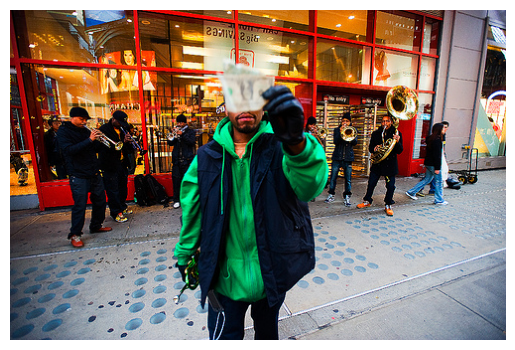

In [7]:
ans = 0
for k, vs in maps.items():
    for v in vs:
        if (ans < len(v.split(" "))):
            ans = len(v.split(" "))
            if (ans > 31):
                print(os.path.join(IMG_DIR, k))
                print(v)
print(ans)

import matplotlib.pyplot as plt
from PIL import Image

# Specify the image file path
image_path = '/kaggle/input/flickr8k/Images/2354456107_bf5c766a05.jpg'

# Open the image using PIL
image = Image.open(image_path)

# Display the image using matplotlib
plt.imshow(image)
plt.axis('off')  # Optional: turn off axis ticks and labels
plt.show()

# Creating Dataloader

- input to model: (feat, input text sequence as tokenized sequences): ((1, 2048), (x, 1))
- output from model: (predicted word): (1, 1)

Each description will be split into words. The model will be provided one word and the photo and generate the next word. Then the first two words of the description will be provided to the model as input with the image to generate the next word. This is how the model will be trained.

In [10]:
# https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/text/Tokenizer
# https://www.tensorflow.org/api_docs/python/tf/keras/utils/pad_sequences
# https://www.tensorflow.org/api_docs/python/tf/keras/utils/to_categorical

# https://wiki.python.org/moin/Generators

from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.sequence import pad_sequences

# task: multi-label classification, label is the next most likely word from tokenizers corpus
def createSeq(tokenizer, maxLength, caps, feat):
    
    iptImg = []
    iptSeq = []
    optWord = []
    
    for cap in caps:
        
        # creating seq of ints from words in tokenizer corpus (passed as list to ensure wordlike treatment)
        seq = tokenizer.texts_to_sequences([cap])[0] # returns 2D arr
        
        # creating n grams of input & output sequences
        for cnt in range(1, len(seq)):
            
            inSeq, outWord = seq[:cnt], seq[cnt]
            
            # padding input sequences
            inSeq = pad_sequences([inSeq], maxlen = maxLength)[0]
            
            # one hot encoding the output word
            outWord = to_categorical([outWord], num_classes = len(tokenizer.word_index) + 1)[0]
            
            # appending 
            iptImg.append(feat)
            iptSeq.append(inSeq)
            optWord.append(outWord)
            
    return np.array(iptImg), np.array(iptSeq), np.array(optWord)

# data supplied one-by-one to ensure no memory issues
def DataLoader(capDict, featDict, tokenizer, maxLength):
    
    # The generator is expected to loop over its data infinite no. of times, it should never return or exit.
    while True:
        for img in capDict.keys(): # alt while True: continuous data stream

            # retrive features for each image
            feat = featDict[img][0]

            # returns array of features, input sequences & output label
            iptImg, iptSeq, optWord = createSeq(tokenizer, maxLength, capDict[img], feat)

            yield [[iptImg, iptSeq], optWord] # (inputs, otuputs)

In [11]:
for k in capTrain.keys():
    for cap in capTrain[k]:
        print(k, cap)
    break

def rowCnt(Dict, thresh):
    cnt = 0
    for k in capTrain.keys():
        x = 0
        for cap in Dict[k]:
            x += len(cap.split()) - 1 # pred 1,...,n-1
        print(f'{x} # of rows as there are that many possible n-gram sequences possible in a, b & c for that particular images 5 captions')
        cnt += 1
        if cnt >= thresh:
            break

# DataLoader: generator function returns a generator         

1259936608_e3f0064f23.jpg START little girl with arms outstretched plays with others at sprinkler park END
1259936608_e3f0064f23.jpg START children play in water fountain END
1259936608_e3f0064f23.jpg START children playing in public waterspouts END
1259936608_e3f0064f23.jpg START the two young girls one wearing skirt and the other wearing shorts are playing in bubbling fountain END
1259936608_e3f0064f23.jpg START two kids playing in fountain at water park END


# Defining Models

1. Reference: https://www.youtube.com/watch?v=c_bVBYxX5EU
2. RNN: https://colah.github.io/posts/2015-08-Understanding-LSTMs/
1. Paper: https://arxiv.org/pdf/1703.09137.pdf
2. RNN: https://karpathy.github.io/2015/05/21/rnn-effectiveness/

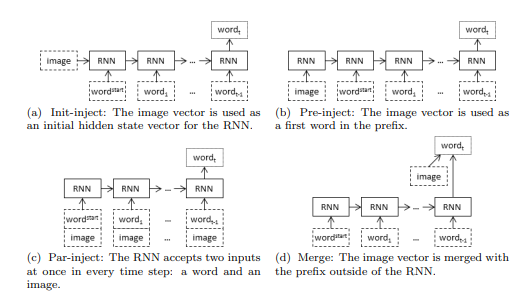


- We are following a "merge based" system to merge image & caption vectorized data, rest of the methods are "inject based"
    - The image vector remains unifluenced by the RNN in merge architecture, unlike inject architecture.
    - Inject architecture: Multimodal RNN (take image in hidden state or 1st input)
        - Image features are passed only once
    - Merge architecture: RNN only receives text sequences

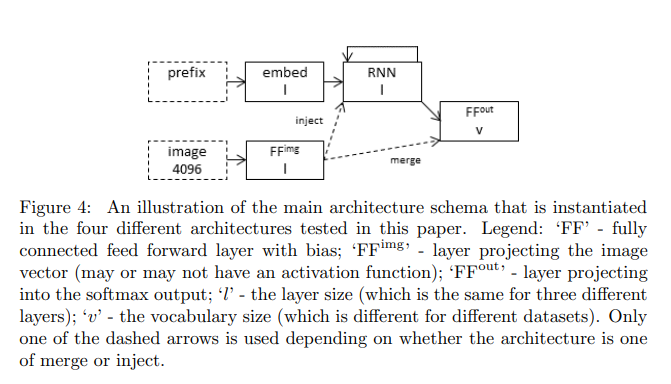

- Benefits of merge architecture:
    - inject-RNNs tend to gradually forget the image input as the length of the sequence(caption) increases, in merge architectures it is totally fresh as it is directly inputed to FFout.
    - merge RNNs use memory more effectively as only store captions, not the images, faster to train
    - require lesser regularization than inject-architecture based models
    - merge architecture produce less verbatim captions, from training step. (good for variation)
    - greater portability for transfer learning the image features & embeddings independently.

- Downsides of merge architecture:
    - inject architecture are better at text generation & retriving correct image for a given caption, but are prone to mimic the traning captions a lot & be generic.

In [33]:
# Baseline model (only 1 level of features extracted from the image features & the captions)

from keras.models import Model
from keras.layers import Input, add
from keras.layers import Dense, Dropout
from keras.layers import Embedding, LSTM

from keras.utils import plot_model

# keras functional API used as we have 2 different kinds of inputs (https://machinelearningmastery.com/keras-functional-api-deep-learning/)
def buildModel(tokenizer, maxLength):
    
    # feat extractor 2048 to 256 dim vector
    ipt1 = Input(shape = (2048,))
    hid11 = Dropout(0.5)(ipt1)
    hid12 = Dense(256, activation = 'relu')(hid11)
    
    # input dim for embedding layer (to ensure smooth handling of variable length input)
    vocabSize = len(tokenizer.word_index) + 1
    
    # LSTM model: 32 to 256 dim vector
    ipt20 = Input(shape = (maxLength,))
    ipt21 = Embedding(vocabSize, 256, mask_zero = True)(ipt20) # generating embeddings (https://www.tensorflow.org/api_docs/python/tf/keras/layers/Embedding)
    hid21 = Dropout(0.5)(ipt21)
    hid22 = LSTM(256)(hid21)
    
    # merging inputs together to get output
    decoder1 = add([hid12, hid22])
    decoder2 = Dense(256, activation = 'relu')(decoder1)
    opt = Dense(vocabSize, activation = 'softmax')(decoder2)
    
    # shaping the final model
    model = Model(inputs = [ipt1, ipt20], outputs = opt)
    model.compile(loss = 'categorical_crossentropy', optimizer = 'adam') # check if metric to be added
    
    # summarize model
    print(model.summary())
    plot_model(model, to_file = 'model.png', show_shapes = True)
    
    return model

In [34]:
model = buildModel(trainTokenizer, 32)

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 32)]         0           []                               
                                                                                                  
 input_3 (InputLayer)           [(None, 2048)]       0           []                               
                                                                                                  
 embedding_1 (Embedding)        (None, 32, 256)      1955584     ['input_4[0][0]']                
                                                                                                  
 dropout_2 (Dropout)            (None, 2048)         0           ['input_3[0][0]']                
                                                                                            

# Training the model

In [35]:
# https://www.geeksforgeeks.org/keras-fit-and-keras-fit_generator/
# https://datascience.stackexchange.com/questions/47405/what-to-set-in-steps-per-epoch-in-keras-fit-generator

from keras.callbacks import EarlyStopping
early_stopping_monitor = EarlyStopping(patience = 2)

maxEpochs = 10
batchSize = 1
steps_per_epoch = len(capTrain) // batchSize

In [ ]:
trained = True
if (not trained):
    for epoch in range(maxEpochs):
        generator = DataLoader(capTrain, feats, trainTokenizer, 32) # no need to produce batches on own
        model.fit_generator(generator, epochs = 1, steps_per_epoch = steps_per_epoch, verbose = 1, callbacks = [early_stopping_monitor])
        model.save(f"modelT_Avg_{epoch}:{batchSize}.h5")

5045/6400 [======================>.......] - ETA: 2:13 - loss: 2.8284

In [7]:
from keras.models import load_model


def generateSeq(tokenizer, maxLength, feat, model):
    start = 'START'
    
    for i in range(maxLength):
        seq = tokenizer.texts_to_sequences([start])[0]
        seq = pad_sequences([seq], maxlen = maxLength)
        
        pred = model.predict([feat, seq], verbose = 0)
        word = np.argmax(pred)
        word = tokenizer.index_word[word]
        
        if word is None:
            break
        if 'end' in word:
            break
            
        start += ' ' + word
        
    return start[6:]

In [8]:
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [ ]:
modelTr = load_model('/kaggle/input/flickme/modelT_Avg_8_1.h5')

image_paths = random.sample(list(capTest.keys()), 6)

fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(20, 20))


for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

# Model Average Pooling: Epoch4

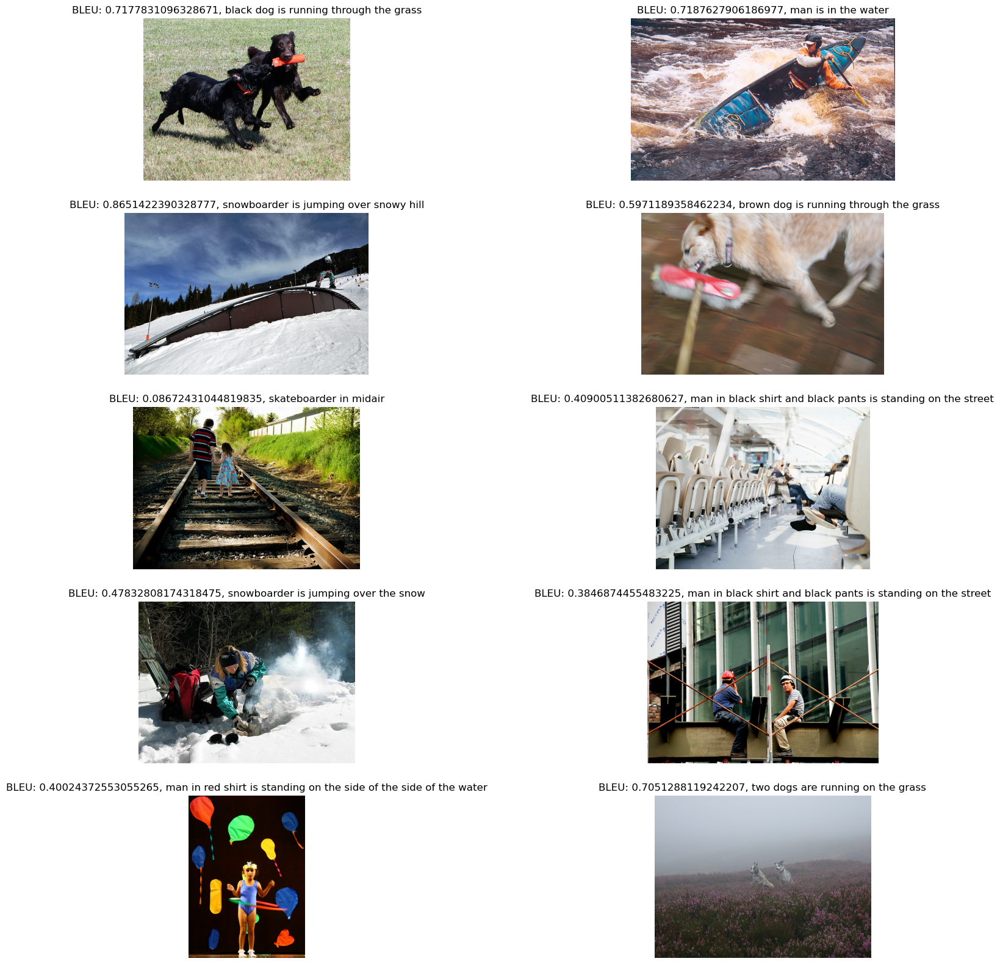

In [49]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

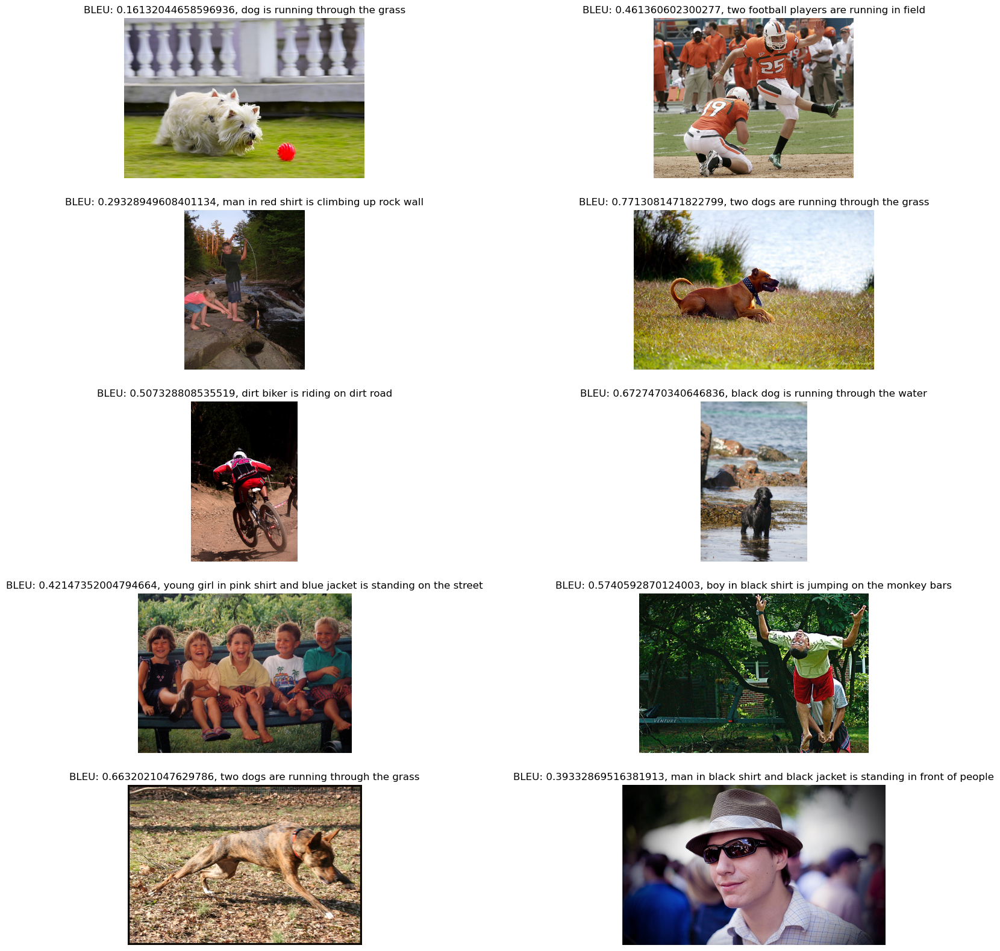

In [50]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

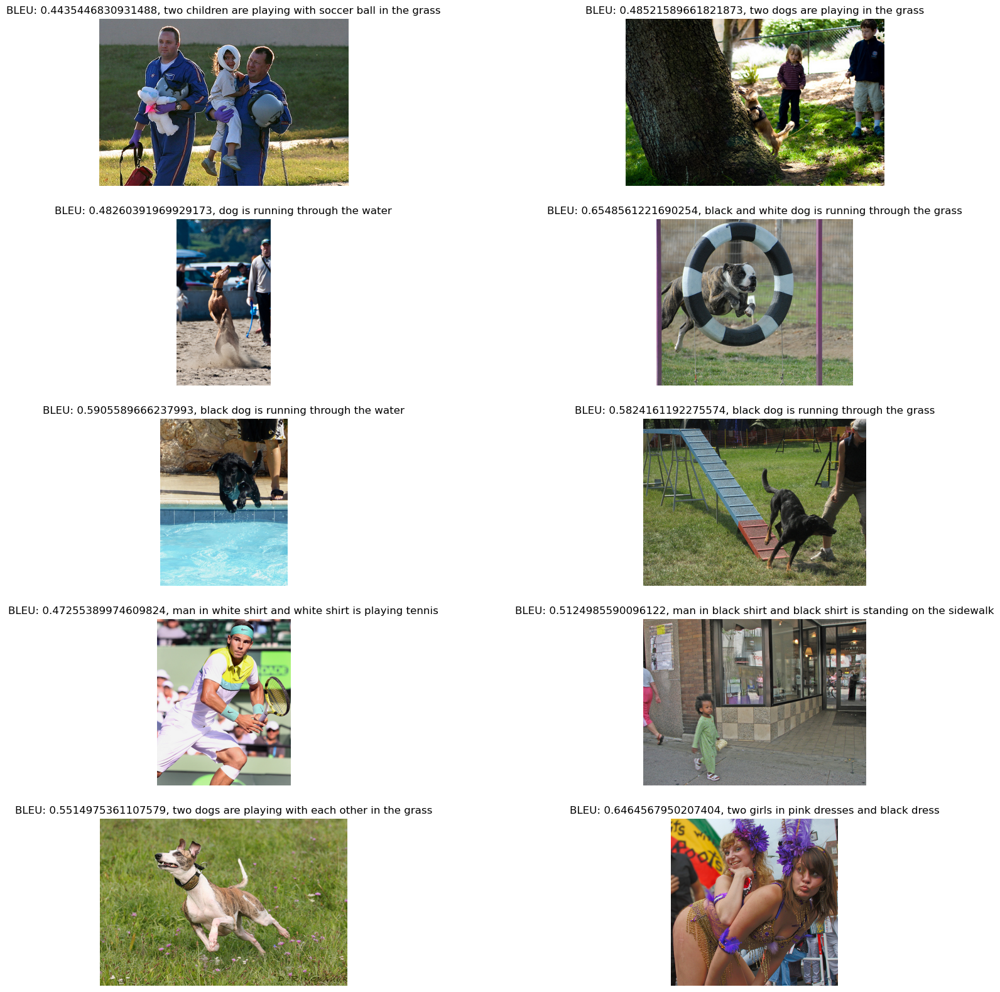

In [51]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

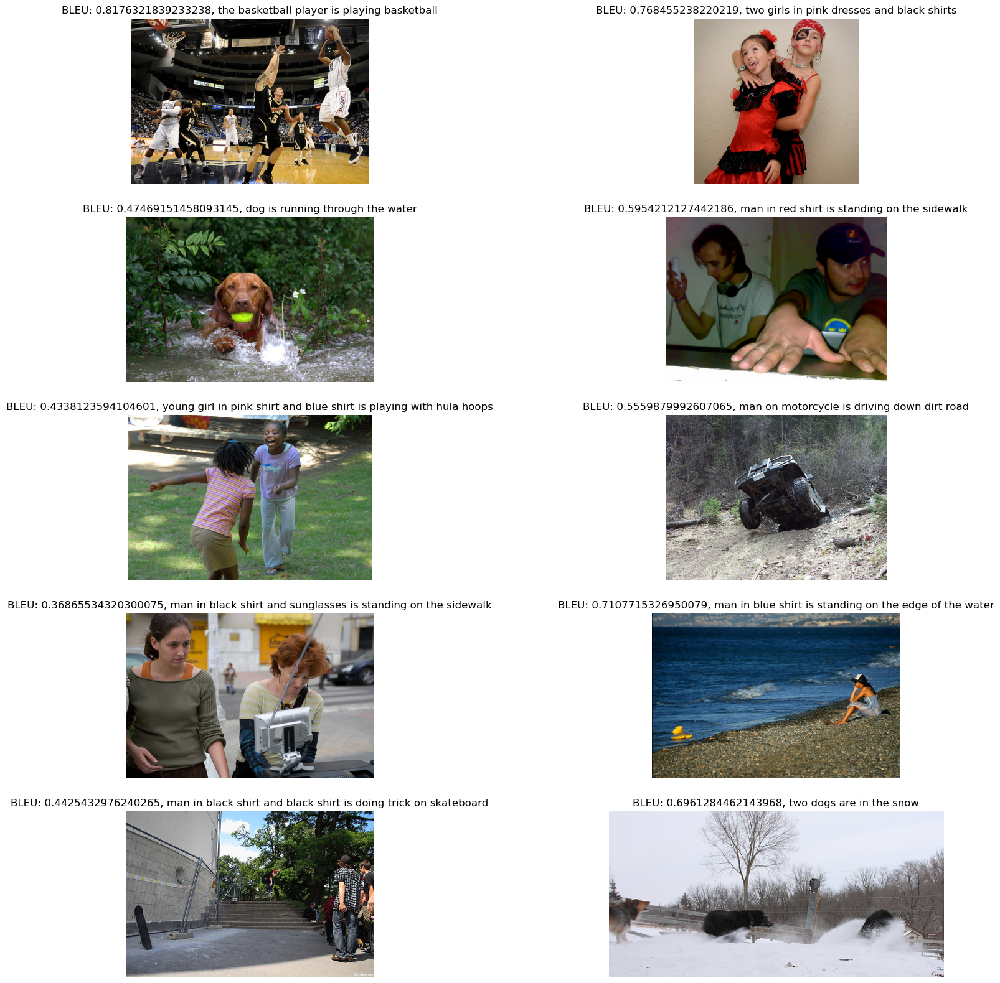

In [52]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

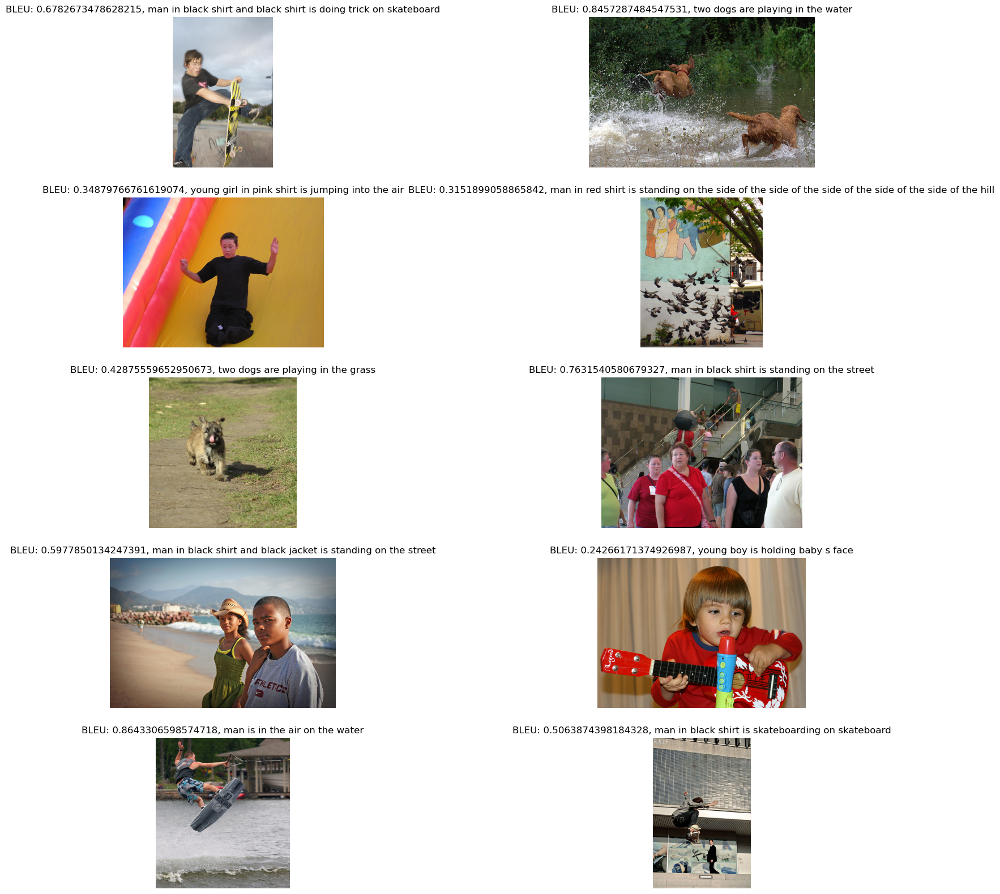

In [53]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

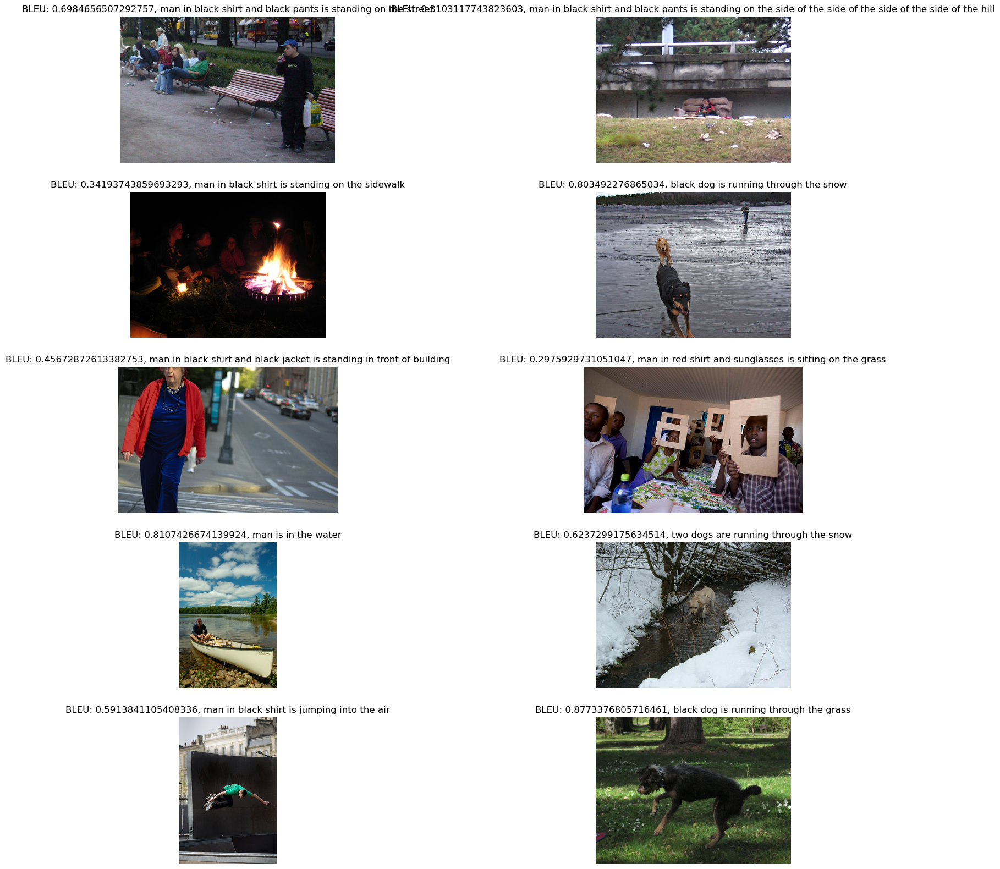

In [54]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

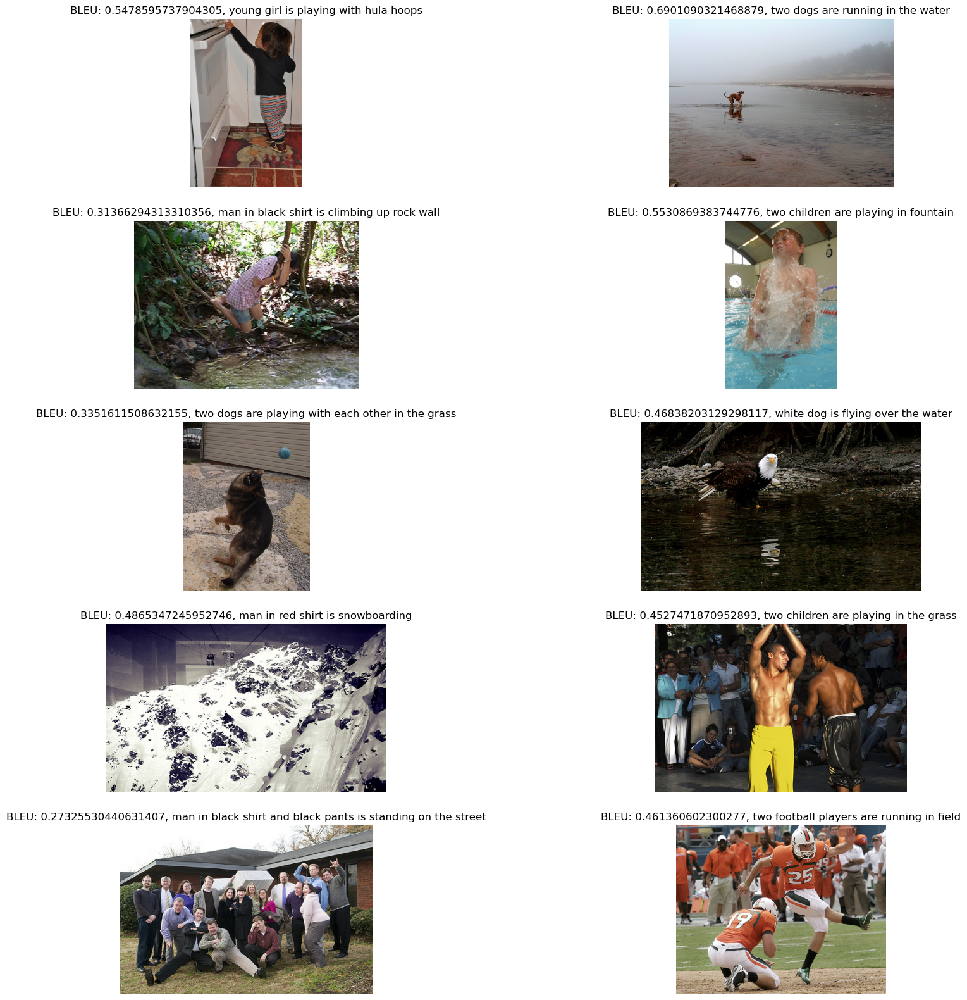

In [55]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

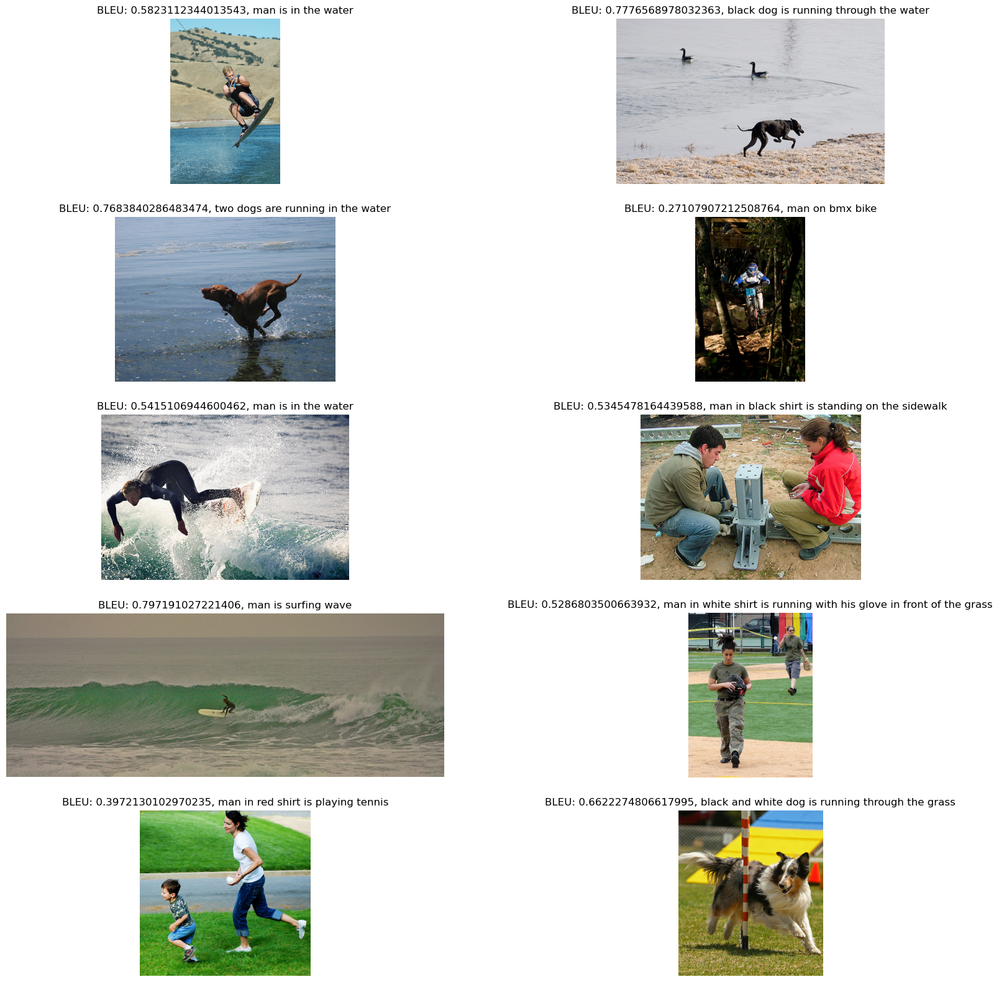

In [56]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

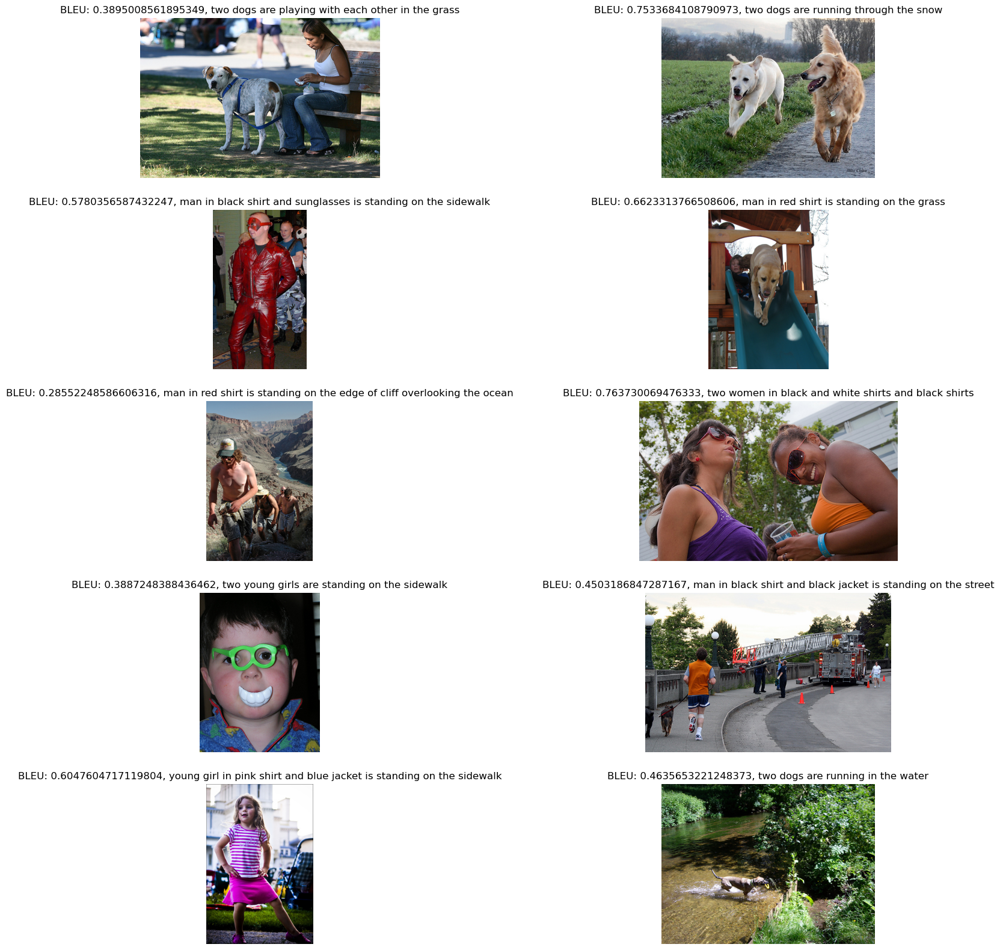

In [57]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

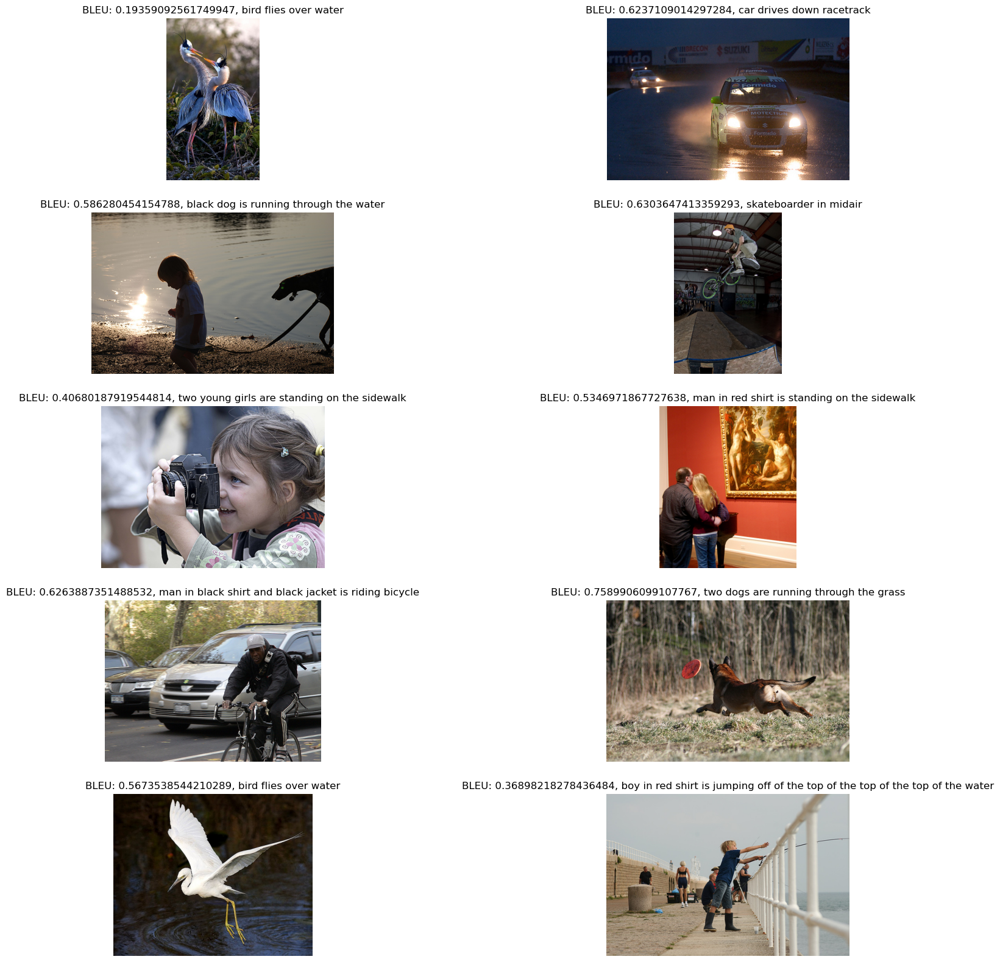

In [58]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

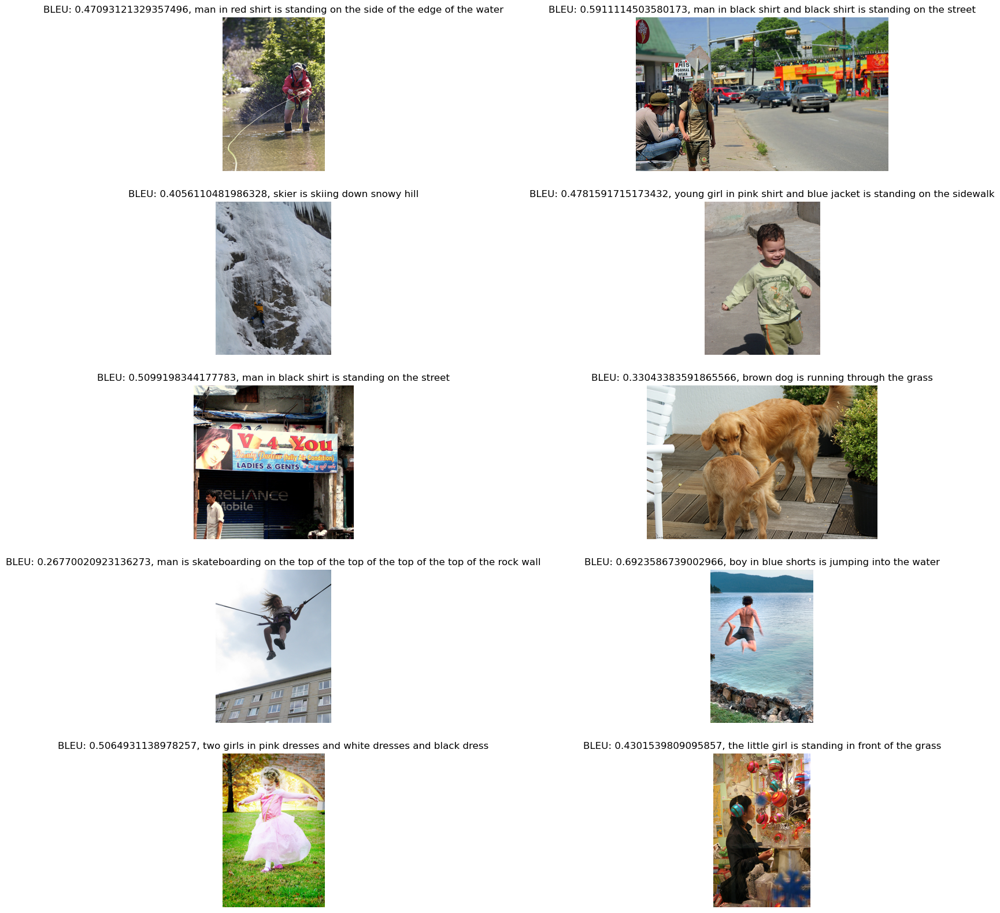

In [59]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

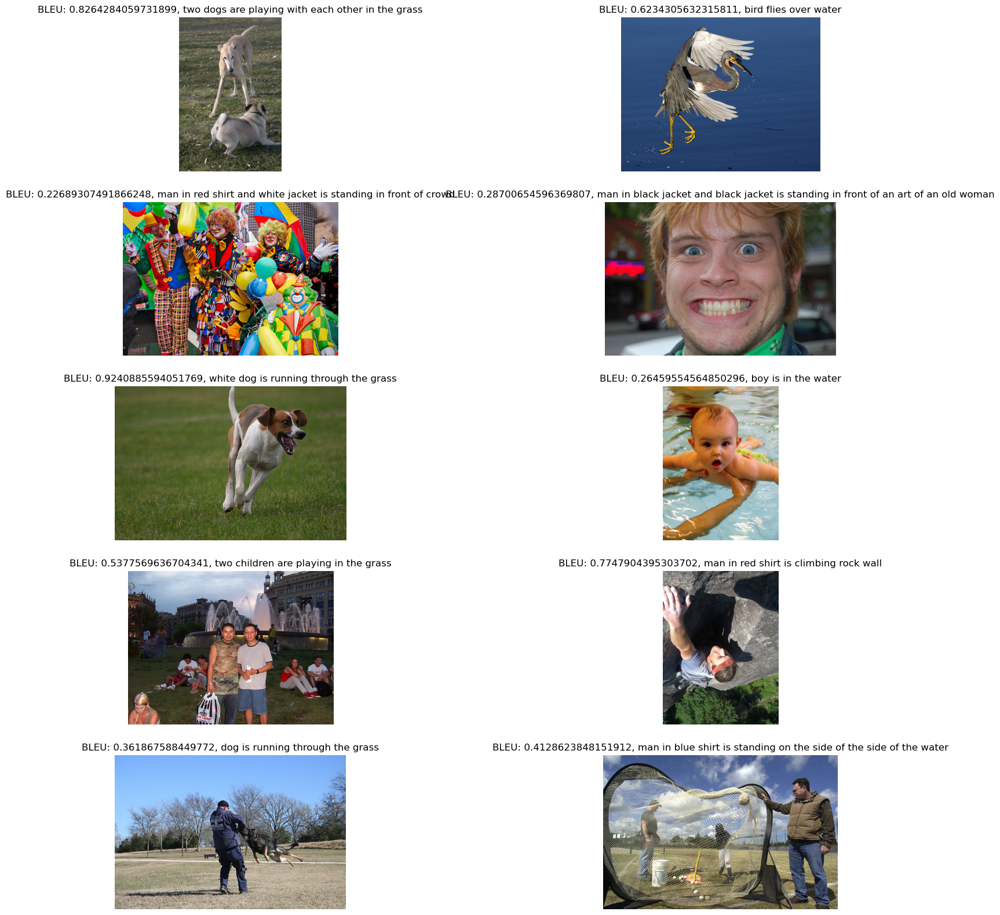

In [60]:
modelTr = load_model('/kaggle/working/modelT_Avg_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

In [63]:
from keras.models import Model, load_model
from nltk.translate.bleu_score import sentence_bleu
modelTr =  load_model('/kaggle/working/modelT_Avg_4:1.h5')
from tqdm import tqdm

bleuG = []
bleuB = []
for k in tqdm(capTest.keys()):
    reference_captions = capTest[k]
    feat = feats[k]
    generated_caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    bleu_score = sentence_bleu(reference_captions, generated_caption)
    if bleu_score > 0.6:
        bleuG.append([k, bleu_score])
    else:
        bleuB.append([k, bleu_score])

100%|██████████| 1691/1691 [18:20<00:00,  1.54it/s]


In [64]:
len(bleuG)/len(bleuB)

0.4729965156794425

# Old models resutls

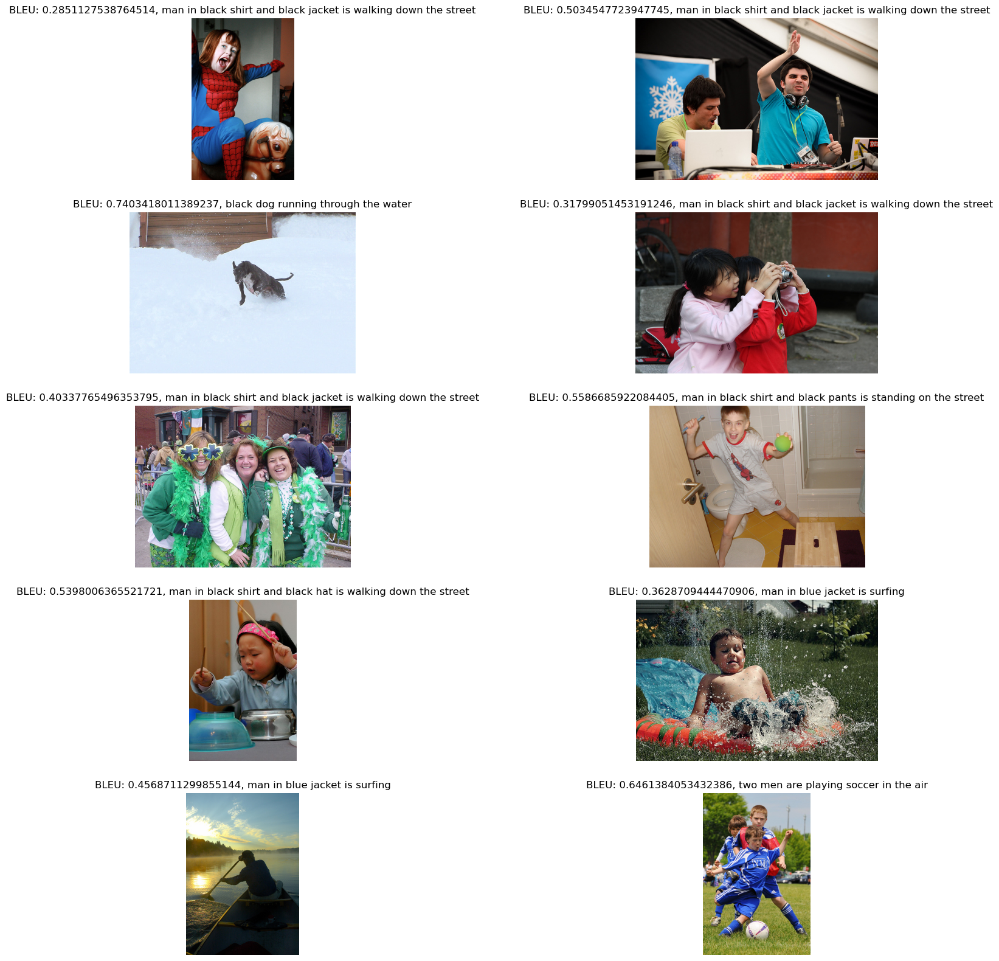

In [29]:
modelTr = load_model('/kaggle/working/modelTrain_4:1.h5')
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

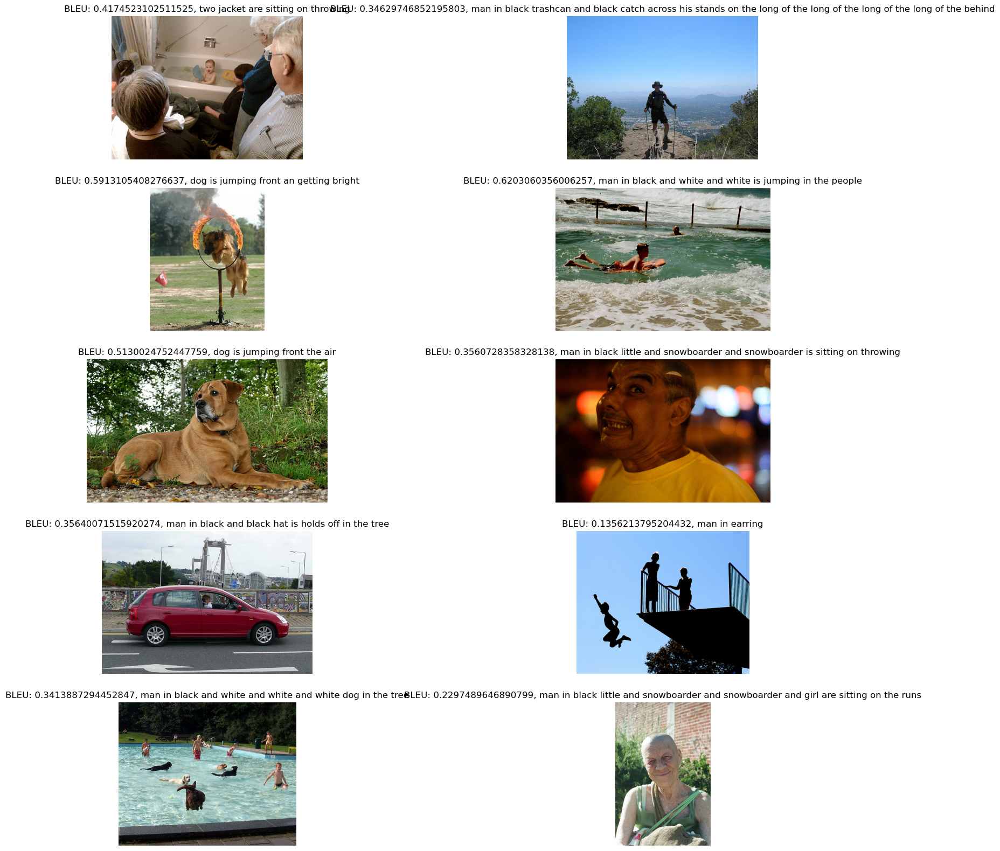

In [40]:
# Plotting images and captions
import matplotlib.pyplot as plt
from PIL import Image
import random
from nltk.translate.bleu_score import sentence_bleu

image_paths = random.sample(list(capTest.keys()), 10)

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 20))
# fig.tight_layout()
# plt.subplots_adjust(hspace=0.5, wspace=0.3)

for i, image_path in enumerate(image_paths):
    # Load the image using PIL
    image = Image.open(os.path.join(IMG_DIR, image_path))
    
    # Generate the caption
    feat = feats[image_path]
    caps = capTest[image_path]
    caption = generateSeq(trainTokenizer, 32, feat, modelTr)
    
    # measuring BLEU
    bleu_score = sentence_bleu(caps, caption)

    # Plot the image
    ax = axes[i // 2, i % 2]
    ax.imshow(image)
    ax.axis("off")
    ax.set_title(f'BLEU: {bleu_score}, {caption}')

plt.show()

# Evaluation
1. Reference1: https://medium.com/@raman.shinde15/image-captioning-with-flickr8k-dataset-bleu-4bcba0b52926
2. Reference2:https://towardsdatascience.com/bleu-bilingual-evaluation-understudy-2b4eab9bcfd1

1. BLEU: (0,1) inclusive, higher the better
2. for BLEUn: use n-grams & check if the predicted n-grams appear in the reference n-grams
3. For us, BLEU tells how good is our predicted caption as compare to the provided 5 reference captions.

In [24]:
# for BS:4 -> np.array(bleu).mean() = 0.37423792352881313
# for BS:8 -> np.array(bleu).mean() = 0.3875618695319863
# for BS:32 -> np.array(bleu).mean() = 0.35427970347656657

0.35427970347656657